In [1]:
import sys
import os
sys.path.append("../python")
sys.path.append(os.path.join(os.environ["ALSVINN_BUILD_PATH"], "python"))
import alsvinn
import numpy as np
import plot_info
import matplotlib.pyplot as plt

# The sample solution will be generated at SAMPLE_SOLUTION_FACTOR*highest_resolution_in_convergence
SAMPLE_SOLUTION_FACTOR=int(os.environ.get("FVM_TV_CONVERGENCE_SAMPLE_SOLUTION_FACTOR", 32))

# This should be the highest resolution you can afford to run one sample of (or 50 samples rather)
# MUST BE A POWER OF 2
COMPUTATIONAL_BUDGET=int(os.environ.get("FVM_TV_CONVERGENCE_COMPUTATIONAL_BUDGET", 2**15))

# This should be the highest resolution you can afford to run one sample with t=0
# MUST BE A POWER OF 2
COMPUTATIONAL_T0_BUDGET=int(os.environ.get("FVM_TV_CONVERGENCE_COMPUTATIONAL_T0_BUDGET", 2**15))

# Number of samples for uq runs
NUMBER_OF_SAMPLES=int(os.environ.get("FVM_TV_CONVERGENCE_NUMBER_OF_SAMPLES", 512))

#################################################################################################

# Highest single resolution for deterministic convergence
CONVERGENCE_DET_HIGHEST_RESOLUTION=int(COMPUTATIONAL_BUDGET/SAMPLE_SOLUTION_FACTOR)

# Highest single resolution for uq convergence (we estimate the runtime)
CONVERGENCE_UQ_HIGHEST_RESOLUTION=2**int(np.log2(COMPUTATIONAL_BUDGET/(SAMPLE_SOLUTION_FACTOR)/(np.sqrt(NUMBER_OF_SAMPLES))))


START_CONVERGENCE_DET_LOG=int(max(2, int(np.log2(CONVERGENCE_DET_HIGHEST_RESOLUTION))-7))
END_CONVERGENCE_DET_LOG=int(np.log2(CONVERGENCE_DET_HIGHEST_RESOLUTION))

START_CONVERGENCE_UQ_LOG=int(max(2, int(np.log2(CONVERGENCE_UQ_HIGHEST_RESOLUTION))-7))
END_CONVERGENCE_UQ_LOG=int(np.log2(CONVERGENCE_UQ_HIGHEST_RESOLUTION))

HIGHEST_RESOLUTION_UQ_T0 = 2**int(np.log2(COMPUTATIONAL_T0_BUDGET/np.sqrt(NUMBER_OF_SAMPLES)))

START_CAUCHY_UQ_T0_LOG=int(max(2, int(np.log2(HIGHEST_RESOLUTION_UQ_T0))-7))
END_CAUCHY_UQ_T0_LOG=int(np.log2(HIGHEST_RESOLUTION_UQ_T0))

START_CAUCHY_DET_T0_LOG=int(max(2, int(np.log2(COMPUTATIONAL_T0_BUDGET))-7))
END_CAUCHY_DET_T0_LOG=int(np.log2(COMPUTATIONAL_T0_BUDGET))




plot_info.console_log_show("SAMPLE_SOLUTION_FACTOR={}".format(SAMPLE_SOLUTION_FACTOR))
plot_info.console_log_show("COMPUTATIONAL_BUDGET={}".format(COMPUTATIONAL_BUDGET))
plot_info.console_log_show("COMPUTATIONAL_T0_BUDGET={}".format(COMPUTATIONAL_T0_BUDGET))
plot_info.console_log_show("NUMBER_OF_SAMPLES={}".format(NUMBER_OF_SAMPLES))
plot_info.console_log_show("CONVERGENCE_DET_HIGHEST_RESOLUTION={}".format(CONVERGENCE_DET_HIGHEST_RESOLUTION))
plot_info.console_log_show("CONVERGENCE_UQ_HIGHEST_RESOLUTION={}".format(CONVERGENCE_UQ_HIGHEST_RESOLUTION))
plot_info.console_log_show("START_CONVERGENCE_DET_LOG={}".format(START_CONVERGENCE_DET_LOG))
plot_info.console_log_show("END_CONVERGENCE_DET_LOG={}".format(END_CONVERGENCE_DET_LOG))
plot_info.console_log_show("START_CONVERGENCE_UQ_LOG={}".format(START_CONVERGENCE_UQ_LOG))
plot_info.console_log_show("END_CONVERGENCE_UQ_LOG={}".format(END_CONVERGENCE_UQ_LOG))
plot_info.console_log_show("HIGHEST_RESOLUTION_UQ_T0={}".format(HIGHEST_RESOLUTION_UQ_T0))
plot_info.console_log_show("START_CAUCHY_UQ_T0_LOG={}".format(START_CAUCHY_UQ_T0_LOG))
plot_info.console_log_show("END_CAUCHY_UQ_T0_LOG={}".format(END_CAUCHY_UQ_T0_LOG))
plot_info.console_log_show("START_CAUCHY_DET_T0_LOG={}".format(START_CAUCHY_DET_T0_LOG))
plot_info.console_log_show("END_CAUCHY_DET_T0_LOG={}".format(END_CAUCHY_DET_T0_LOG))

2019-04-08 07:50:09.658032 (in <module>): SAMPLE_SOLUTION_FACTOR=32
2019-04-08 07:50:09.984143 (in <module>): COMPUTATIONAL_BUDGET=32768
2019-04-08 07:50:09.990221 (in <module>): COMPUTATIONAL_T0_BUDGET=32768
2019-04-08 07:50:09.995869 (in <module>): NUMBER_OF_SAMPLES=512
2019-04-08 07:50:10.001652 (in <module>): CONVERGENCE_DET_HIGHEST_RESOLUTION=1024
2019-04-08 07:50:10.007401 (in <module>): CONVERGENCE_UQ_HIGHEST_RESOLUTION=32
2019-04-08 07:50:10.013202 (in <module>): START_CONVERGENCE_DET_LOG=3
2019-04-08 07:50:10.019095 (in <module>): END_CONVERGENCE_DET_LOG=10
2019-04-08 07:50:10.024956 (in <module>): START_CONVERGENCE_UQ_LOG=2
2019-04-08 07:50:10.030794 (in <module>): END_CONVERGENCE_UQ_LOG=5
2019-04-08 07:50:10.036624 (in <module>): HIGHEST_RESOLUTION_UQ_T0=1024
2019-04-08 07:50:10.042415 (in <module>): START_CAUCHY_UQ_T0_LOG=3
2019-04-08 07:50:10.048209 (in <module>): END_CAUCHY_UQ_T0_LOG=10
2019-04-08 07:50:10.054103 (in <module>): START_CAUCHY_DET_T0_LOG=8
2019-04-08 07:50:1

In [2]:
class ExactLinearSolution(object):
    def __init__(self, initial_data):
        self.initial_data = np.copy(np.array(initial_data))
        self.x, self.dx = np.linspace(0, 1, initial_data.shape[0], retstep=True)
        
    def __call__(self, t):
        x_shift = int(t/self.dx)

        u = np.roll(np.copy(self.initial_data), x_shift)
        
        return u
    

In [3]:
equations = ["burgers", "cubic", "linear"]

numerical_fluxes = {}

numerical_fluxes["burgers"] = ["rusanov", "godunov", "roe"]
numerical_fluxes["linear"] = ["rusanov", "upwind"]
numerical_fluxes["cubic"] = ["rusanov", "roe"]

exact_solutions = {}
exact_solutions["burgers"] = None
exact_solutions["linear"] = ExactLinearSolution
exact_solutions["cubic"] = None

def run_all_configurations(function_to_call, T):
    for equation in equations:
        plot_info.display(plot_info.HTML("<h1>{}<h1>".format(equation)))
        for numerical_flux in numerical_fluxes[equation]:
            plot_info.display(plot_info.HTML("<h2>{}<h2>".format(numerical_flux)))
            
            function_to_call(equation, numerical_flux, exact_solutions[equation], T)

# Convergence runs

In [4]:
def run_convergence(base_xml, title, T, 
                    exact_solution_class=None,
                    numerical_flux="rusanov",
                    equation="burgers"):
    resolutions = 2**np.arange(START_CONVERGENCE_DET_LOG, END_CONVERGENCE_DET_LOG)
    errors = []
    
    
    
    ## Make sample solution
    sample_solution_run = alsvinn.run(name="sample_solution",
        base_xml=base_xml,
        number_of_saves=1,
        dimension=[SAMPLE_SOLUTION_FACTOR*resolutions[-1],1,1],
        flux=numerical_flux,
        equation=equation,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    if exact_solution_class is None:
        sample_solution = sample_solution_run.get_data("u", 1)
    else:
        initial_data = sample_solution_run.get_data("u", 0)

        exact_solution_object = exact_solution_class(initial_data)
        
        sample_solution = exact_solution_object(T)
        
    r_sample = sample_solution.shape[0]
    
    
    ## Loop over resolutions
    for r in resolutions:
        ## Just some progress output, can be deleted
        sys.stdout.write("Resolution = {}\r".format(r))
        sys.stdout.flush()
        
        ## This is where we run alsvinn for the given resolution
        run = alsvinn.run(name="convergence_run",
                         base_xml=base_xml,
                         number_of_saves=1,
                         dimension=[r,1,1],
                         flux=numerical_flux,
                         equation=equation,
                         uq=True, # notice that since we have Brownian initial data, we need to enable uq
                         T=T)
        
        u_approx = run.get_data("u", 1)
        
        u_approx_upscaled = np.repeat(u_approx, r_sample//r)
        
        ## Compute L^1 error
        errors.append(np.sum(abs(u_approx_upscaled-sample_solution))/r_sample)
        
    errors = np.array(errors)
    sys.stdout.write("\r")
    plt.figure(0)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.loglog(resolutions, errors, '-o',basex=2, basey=2,
                           label=title)
    plt.grid(True)
    
    poly = np.polyfit(np.log(resolutions), np.log(errors), 1)
    plt.loglog(resolutions, np.exp(poly[1])*resolutions**poly[0], '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(M^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    
    
    plt.xlabel("Number of cells ($M$)")
    plt.ylabel("Error ($||\\cdot||_{L^1([0,1])}$)")
    plt.legend()
    
    
    plt.figure(1)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.loglog(1.0/resolutions, errors, '-o',basex=2, basey=2,
                           label=title)
    plt.grid(True)
    
    poly = np.polyfit(np.log(1.0/resolutions), np.log(errors), 1)
    plt.loglog(1.0/resolutions, np.exp(poly[1])*resolutions**(-poly[0]), '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(\\Delta x^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    plt.xlabel("$\\Delta x$")
    plt.ylabel("Error ($||\\cdot||_{L^1([0,1])}$)")
    plt.legend()
    
    
    plt.figure(2)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.loglog(1.0/resolutions, errors, '-o',basex=2, basey=2,
                           label=title)
    plt.grid(True)
    
    poly = np.polyfit(np.log(1.0/resolutions), np.log(-errors/np.log(1/resolutions)), 1)
    plt.loglog(1.0/resolutions, -np.log(1/resolutions)*np.exp(poly[1])*resolutions**(-poly[0]), '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(-\\log(\\Delta x)\\Delta x^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    plt.xlabel("$\\Delta x$")
    plt.ylabel("Error ($||\\cdot||_{L^1([0,1])}$)")
    plt.legend()
   
    plot_info.console_log_show("Done configuration {} {} {} {}".format(base_xml, equation, numerical_flux, T))
        
        

# Sanity check with sine initial data



2019-04-08 07:50:17.258694 (in run_convergence): Done configuration ../configs/sine/sine.xml burgers rusanov 0.25


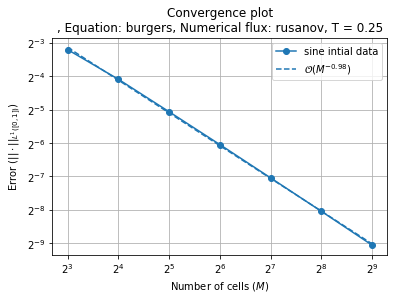

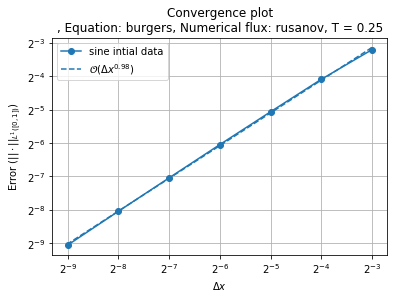

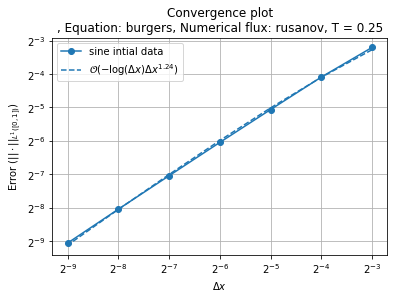

2019-04-08 07:50:27.307525 (in run_convergence): Done configuration ../configs/sine/sine.xml burgers godunov 0.25


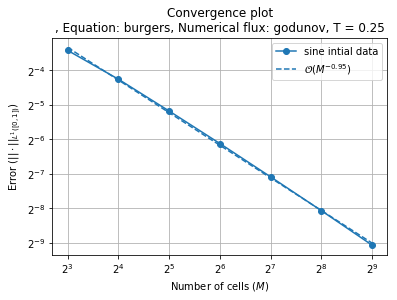

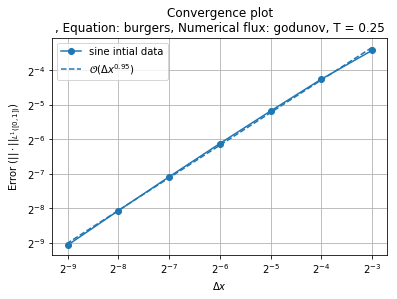

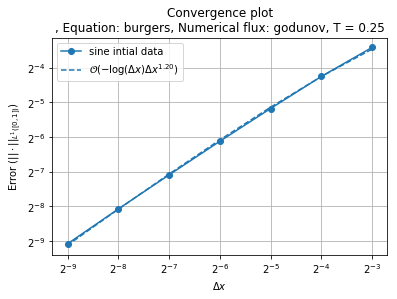

2019-04-08 07:50:36.081455 (in run_convergence): Done configuration ../configs/sine/sine.xml burgers roe 0.25


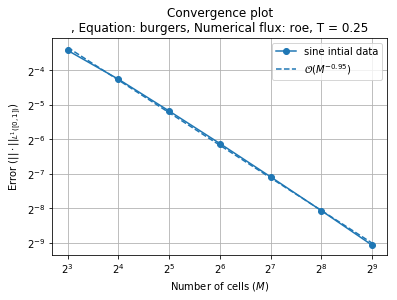

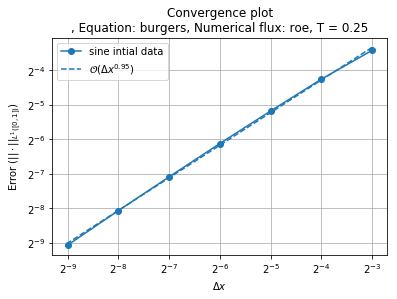

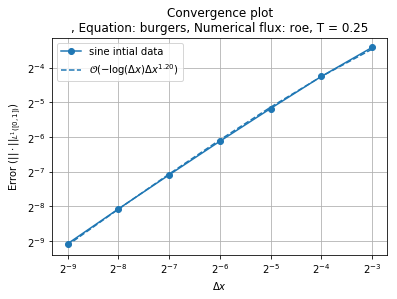

2019-04-08 07:50:48.161491 (in run_convergence): Done configuration ../configs/sine/sine.xml cubic rusanov 0.25


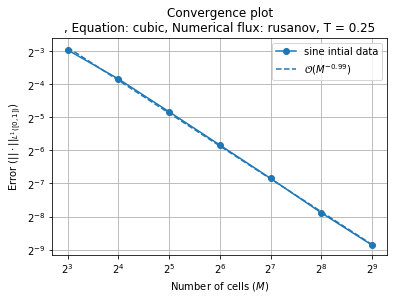

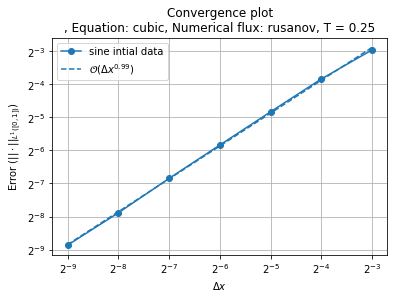

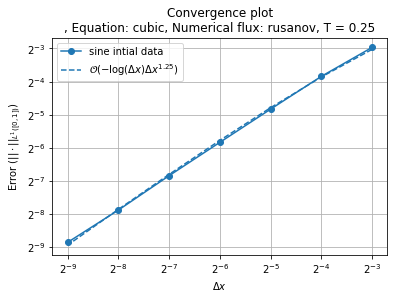

2019-04-08 07:51:06.289268 (in run_convergence): Done configuration ../configs/sine/sine.xml cubic roe 0.25


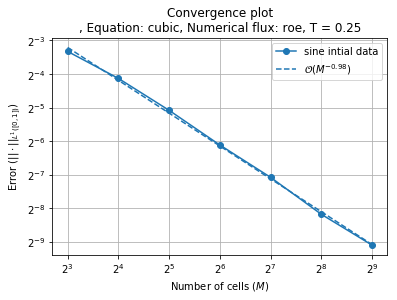

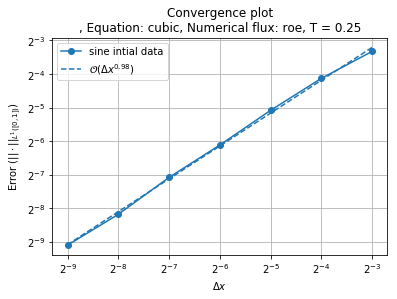

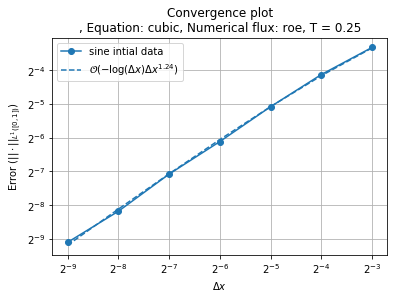

2019-04-08 07:51:12.798644 (in run_convergence): Done configuration ../configs/sine/sine.xml linear rusanov 0.25


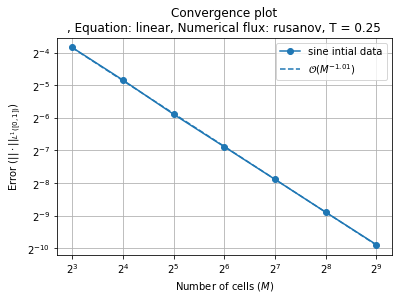

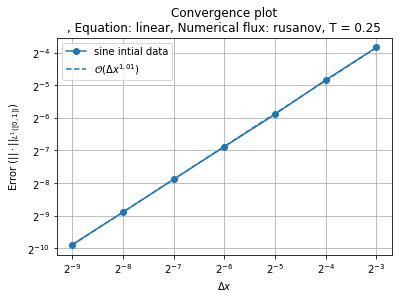

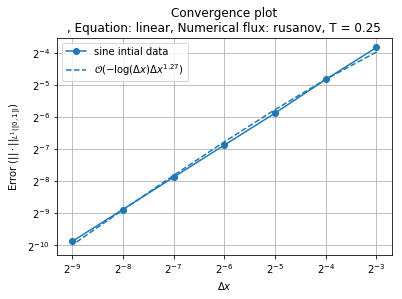

2019-04-08 07:51:19.253414 (in run_convergence): Done configuration ../configs/sine/sine.xml linear upwind 0.25


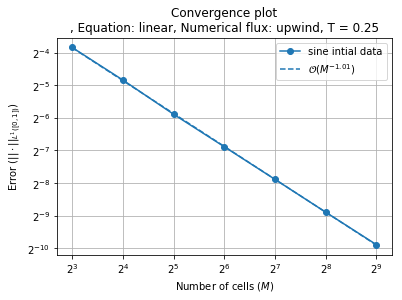

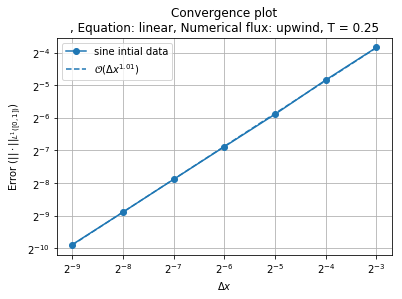

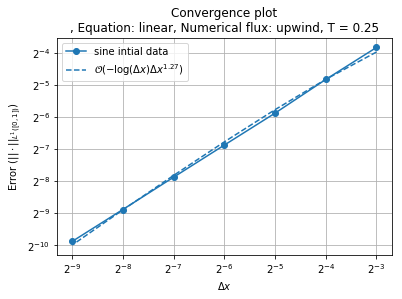

2019-04-08 07:51:20.910689 (in <module>): Done with sine


In [5]:
def run_sine_convergence(equation, numerical_flux, exact_solution, T):
    base_xml_format_string = '../configs/sine/sine.xml'



    base_xml = base_xml_format_string
     
    name = "sine intial data"
    run_convergence(base_xml, name, T, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
    
    plt.figure(0)
    plt.title("Convergence plot\n, Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation, numerical_flux=numerical_flux, T=T))

    plt.figure(1)
    plt.title("Convergence plot\n, Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation, numerical_flux=numerical_flux, T=T))
    
    plt.figure(2)
    plt.title("Convergence plot\n, Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation, numerical_flux=numerical_flux, T=T))
    
    plt.show()

    
run_all_configurations(run_sine_convergence, 0.25)
plot_info.console_log_show("Done with sine")
        
        

# Convergence runs for fBm

2019-04-08 07:51:32.546417 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.00048828125
2019-04-08 07:51:44.149583 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.00048828125
2019-04-08 07:51:55.820722 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 0.00048828125
2019-04-08 07:52:07.596886 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 0.00048828125


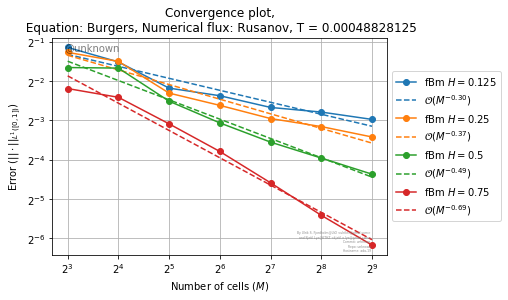

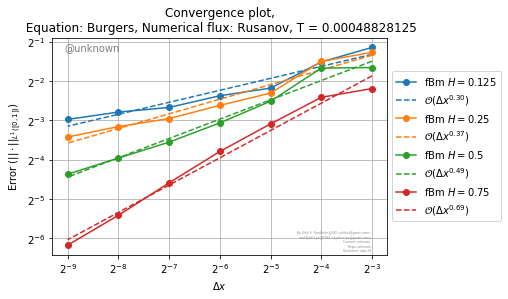

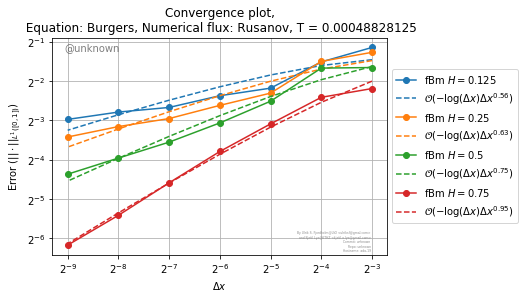

2019-04-08 07:52:32.595056 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.00048828125
2019-04-08 07:52:44.244831 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.00048828125
2019-04-08 07:52:55.999029 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 0.00048828125
2019-04-08 07:53:07.702803 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 0.00048828125


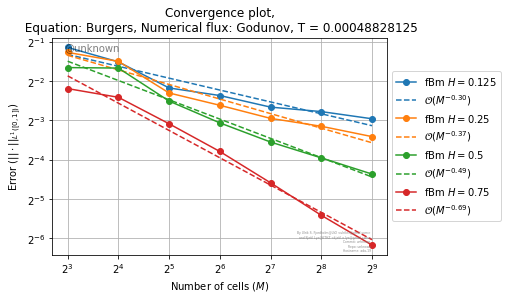

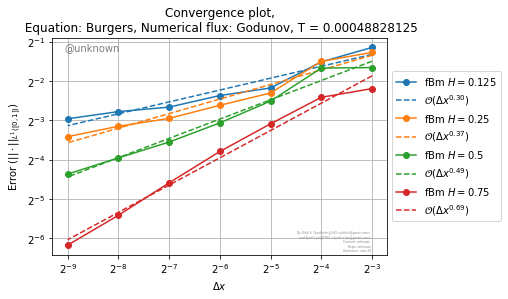

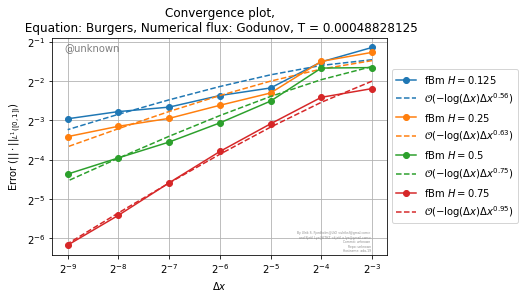

2019-04-08 07:53:32.165873 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.00048828125
2019-04-08 07:53:43.858812 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.00048828125
2019-04-08 07:53:55.586941 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 0.00048828125
2019-04-08 07:54:07.227628 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 0.00048828125


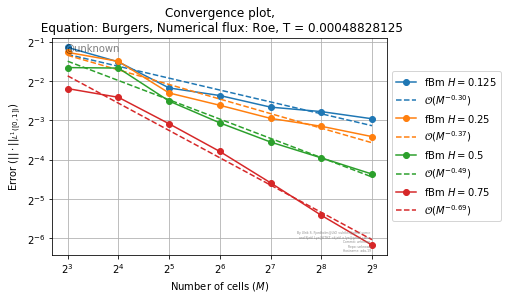

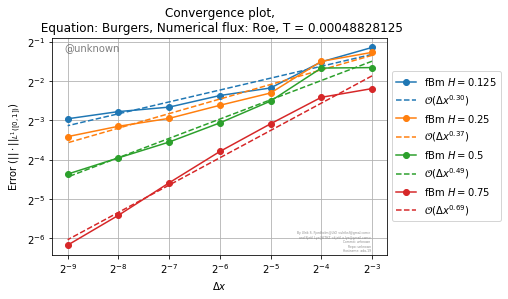

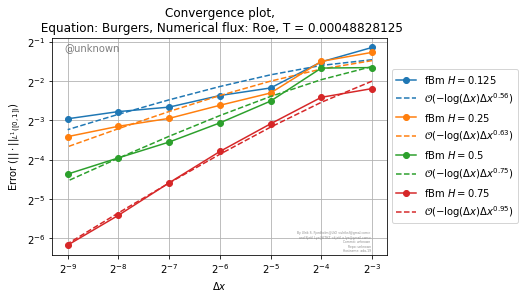

2019-04-08 07:54:31.682645 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.00048828125
2019-04-08 07:54:43.195029 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.00048828125
2019-04-08 07:54:54.822548 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 0.00048828125
2019-04-08 07:55:06.857975 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 0.00048828125


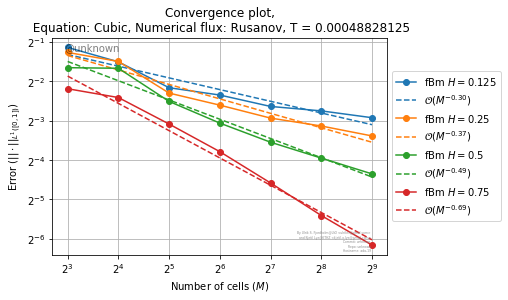

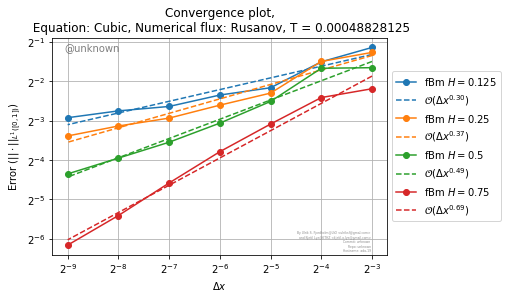

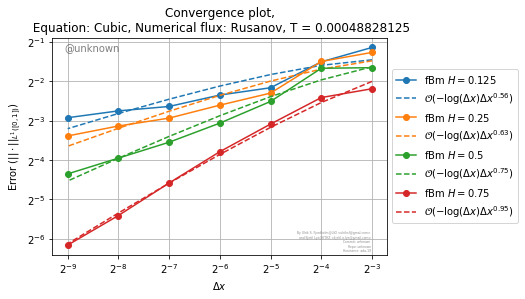

2019-04-08 07:55:31.981041 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.00048828125
2019-04-08 07:55:43.594087 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.00048828125
2019-04-08 07:55:55.325940 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 0.00048828125
2019-04-08 07:56:08.767840 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 0.00048828125


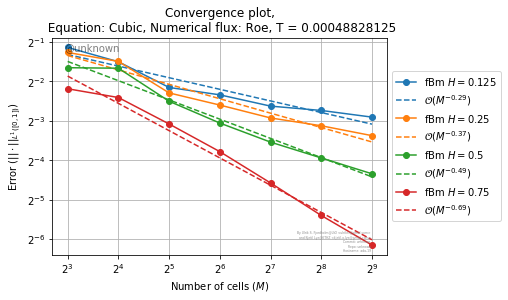

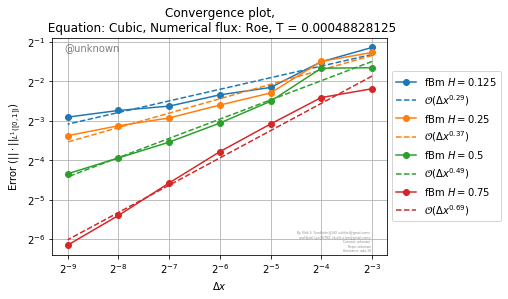

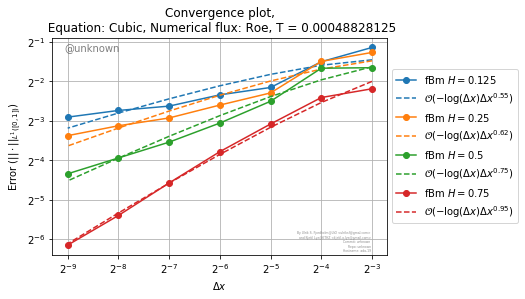

2019-04-08 07:56:33.169316 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.00048828125
2019-04-08 07:56:44.839148 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.00048828125
2019-04-08 07:56:56.118188 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 0.00048828125
2019-04-08 07:57:07.859599 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 0.00048828125


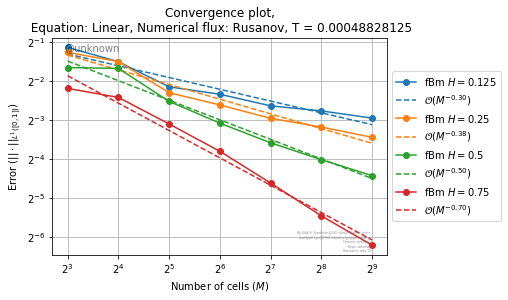

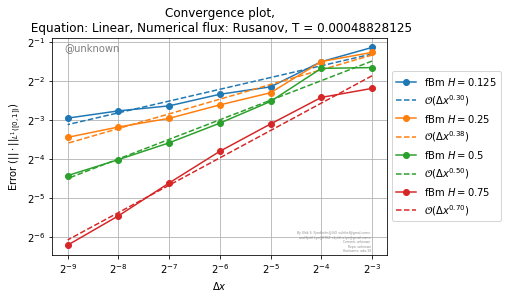

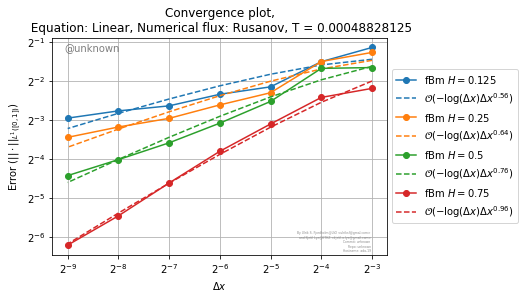

2019-04-08 07:57:32.621654 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.00048828125
2019-04-08 07:57:44.243727 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.00048828125
2019-04-08 07:57:55.811105 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 0.00048828125
2019-04-08 07:58:07.341119 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 0.00048828125


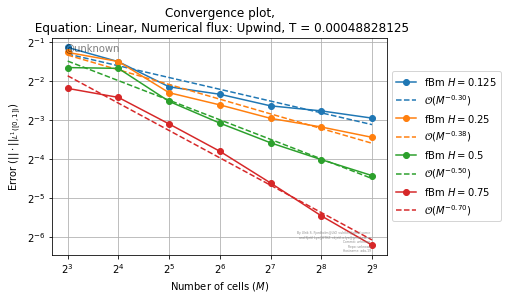

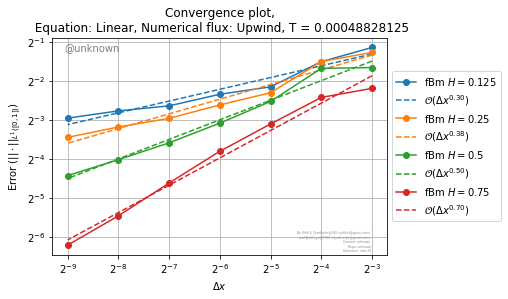

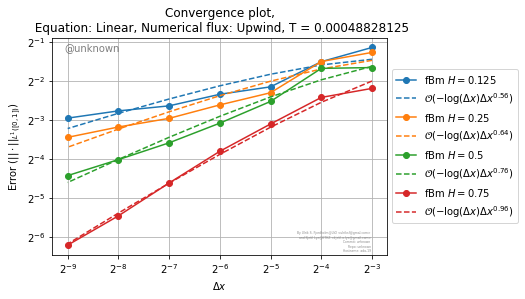

2019-04-08 07:58:32.274004 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.00390625
2019-04-08 07:58:44.128764 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.00390625
2019-04-08 07:58:55.920187 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 0.00390625
2019-04-08 07:59:08.181412 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 0.00390625


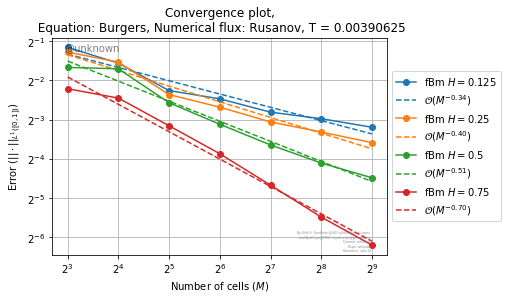

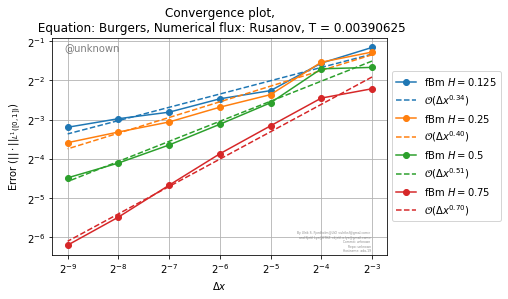

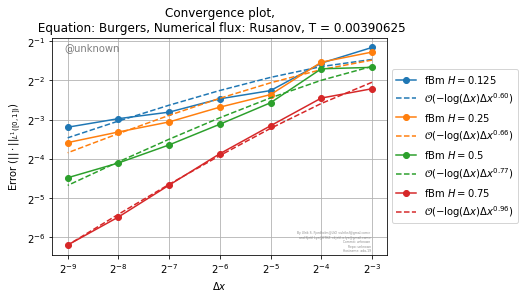

2019-04-08 07:59:33.422827 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.00390625
2019-04-08 07:59:45.414437 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.00390625
2019-04-08 07:59:57.476542 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 0.00390625
2019-04-08 08:00:09.687376 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 0.00390625


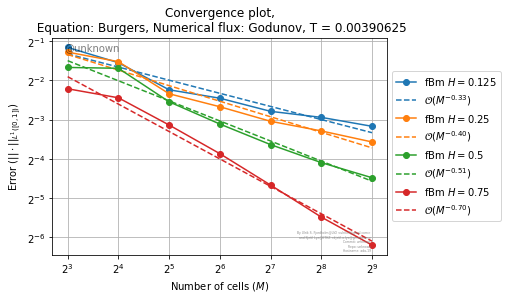

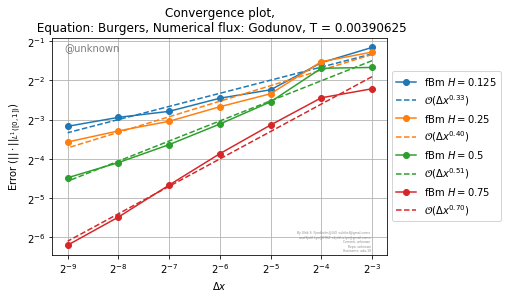

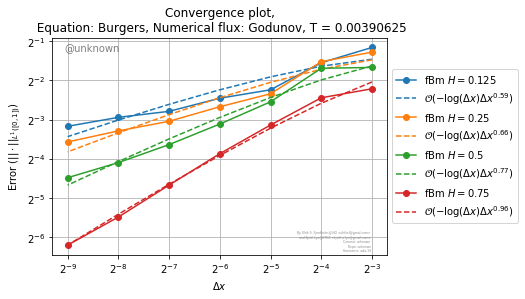

2019-04-08 08:00:34.965713 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.00390625
2019-04-08 08:00:46.614061 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.00390625
2019-04-08 08:00:59.550035 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 0.00390625
2019-04-08 08:01:13.548879 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 0.00390625


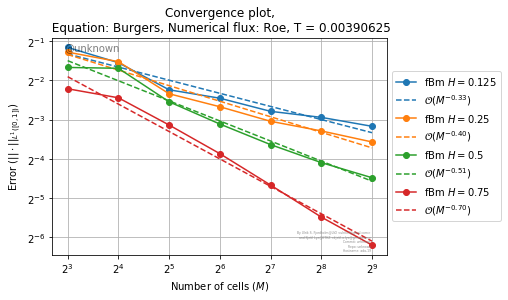

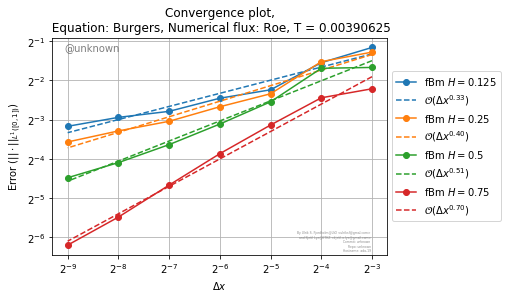

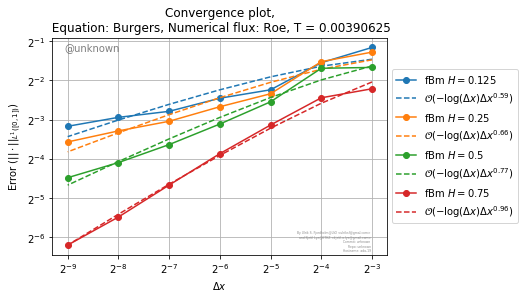

2019-04-08 08:01:38.198298 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.00390625
2019-04-08 08:01:50.138354 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.00390625
2019-04-08 08:02:02.181404 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 0.00390625
2019-04-08 08:02:14.175950 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 0.00390625


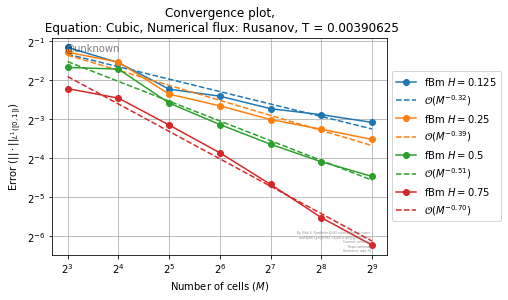

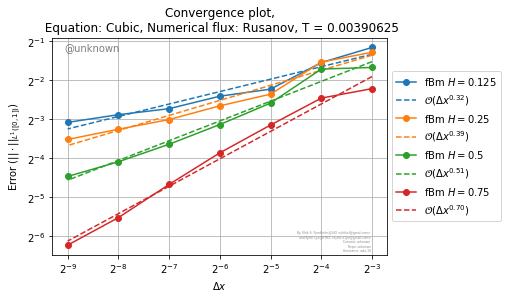

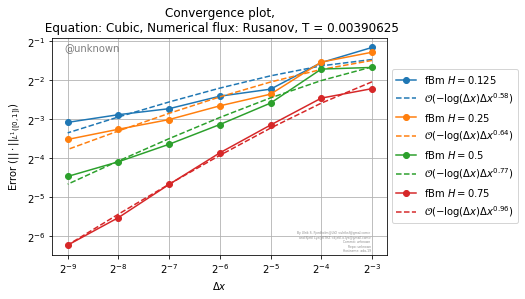

2019-04-08 08:02:38.898374 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.00390625
2019-04-08 08:02:51.036800 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.00390625
2019-04-08 08:03:03.200644 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 0.00390625
2019-04-08 08:03:15.534175 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 0.00390625


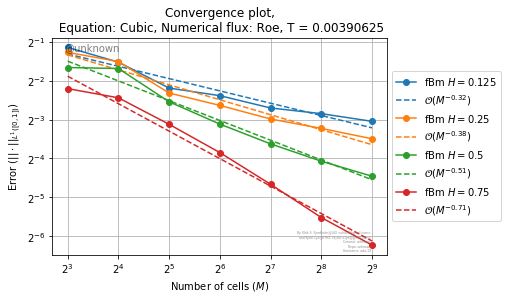

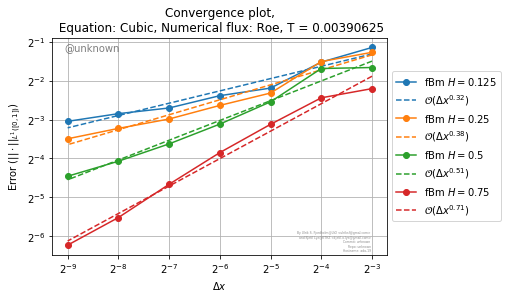

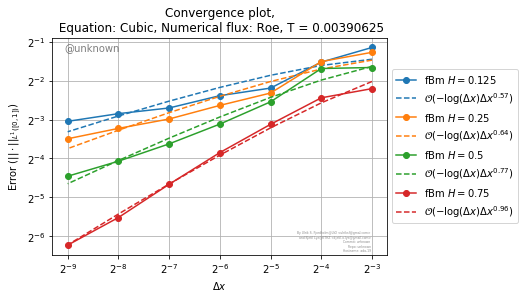

2019-04-08 08:03:40.933345 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.00390625
2019-04-08 08:03:52.746717 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.00390625
2019-04-08 08:04:04.692330 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 0.00390625
2019-04-08 08:04:16.770372 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 0.00390625


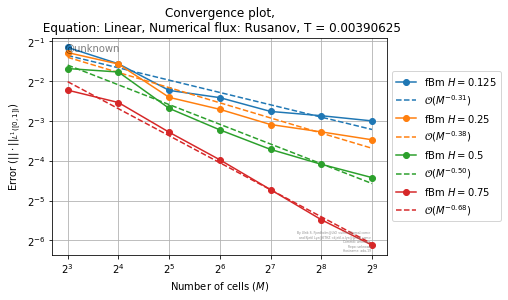

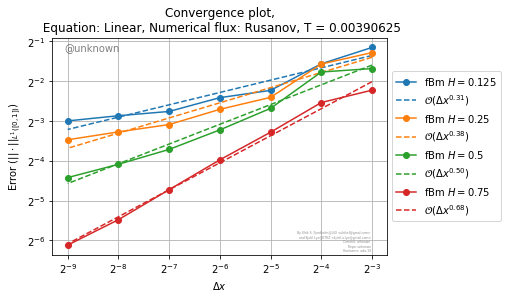

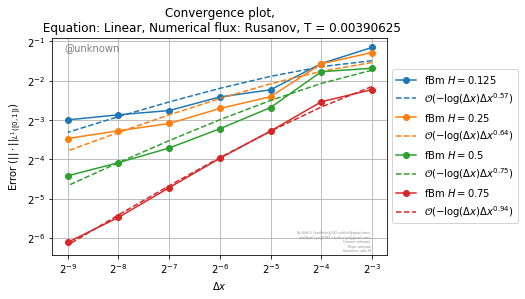

2019-04-08 08:04:41.930343 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.00390625
2019-04-08 08:04:53.506055 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.00390625
2019-04-08 08:05:05.543760 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 0.00390625
2019-04-08 08:05:17.439545 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 0.00390625


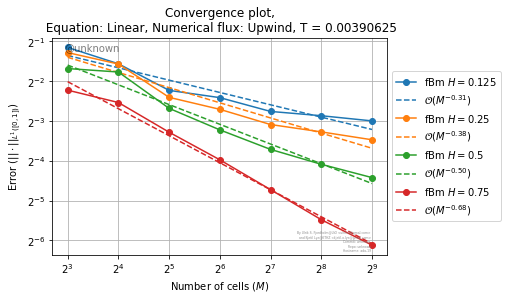

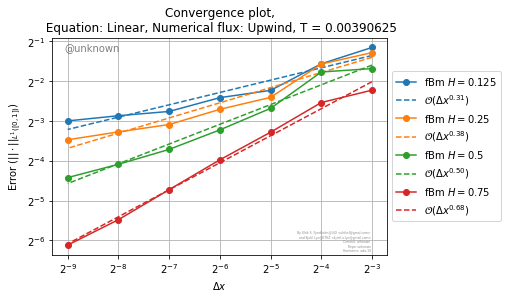

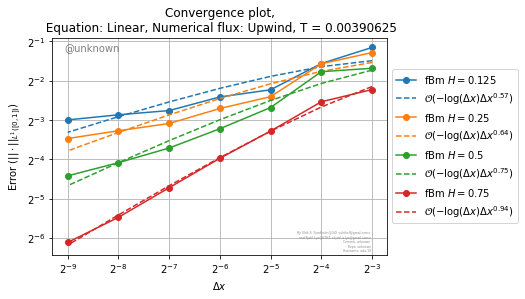

2019-04-08 08:06:05.280763 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.125
2019-04-08 08:06:41.391669 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.125
2019-04-08 08:07:22.587506 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 0.125
2019-04-08 08:08:08.262245 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 0.125


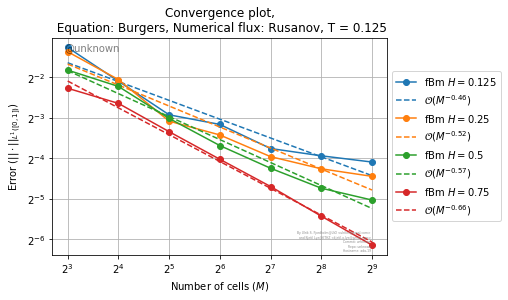

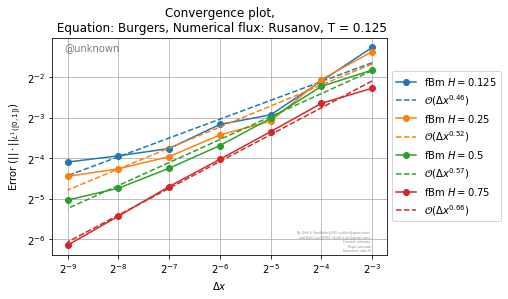

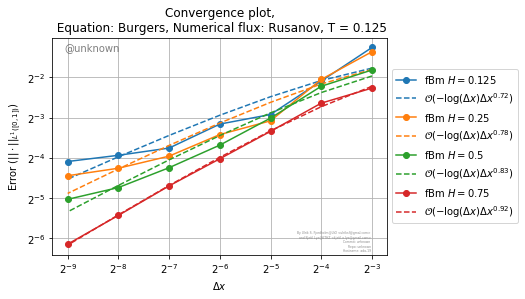

2019-04-08 08:08:59.167069 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.125
2019-04-08 08:09:38.445264 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.125
2019-04-08 08:10:26.196102 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 0.125
2019-04-08 08:11:22.212567 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 0.125


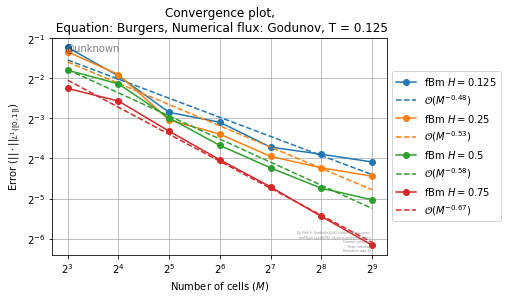

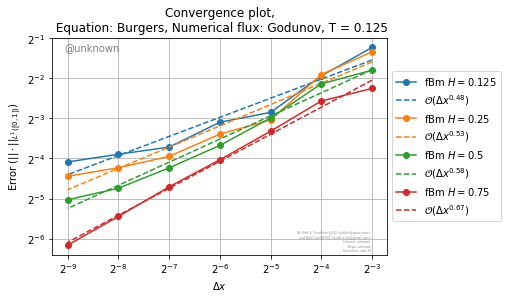

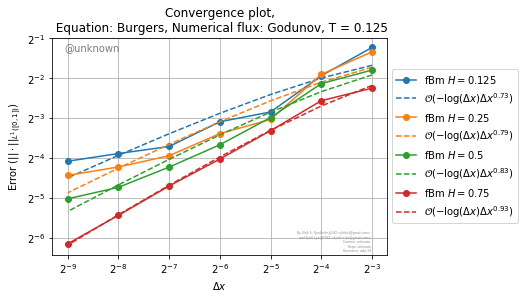

2019-04-08 08:12:10.520055 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.125
2019-04-08 08:12:48.207552 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.125
2019-04-08 08:13:32.309198 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 0.125
2019-04-08 08:14:19.110946 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 0.125


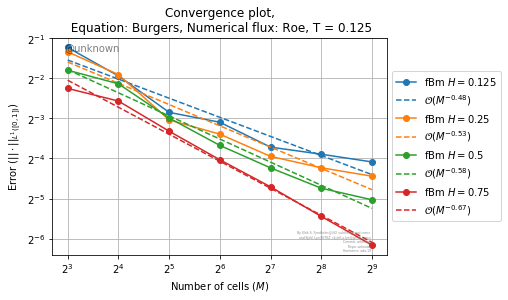

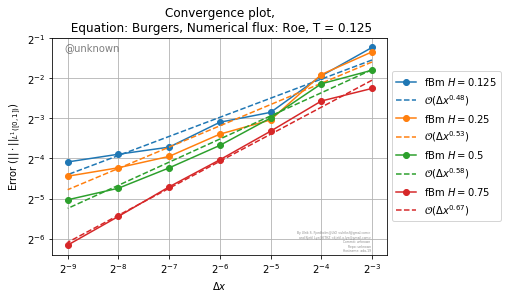

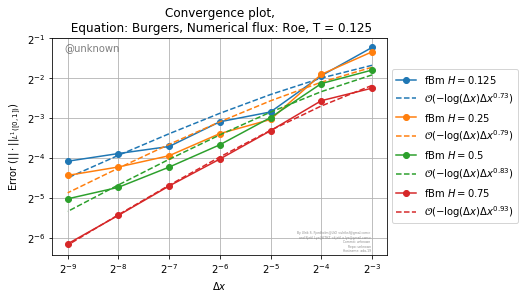

2019-04-08 08:14:57.923783 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.125
2019-04-08 08:15:32.223221 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.125
2019-04-08 08:16:19.420300 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 0.125
2019-04-08 08:17:03.088664 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 0.125


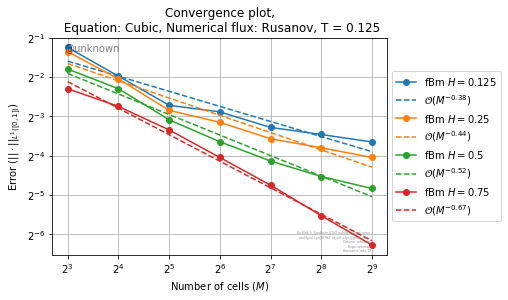

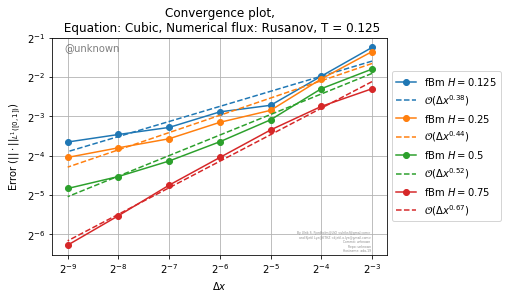

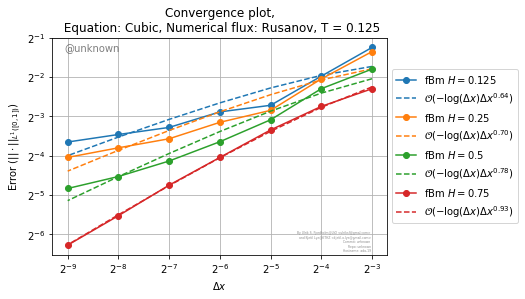

2019-04-08 08:17:44.101754 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.125
2019-04-08 08:18:21.776045 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.125
2019-04-08 08:19:03.944350 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 0.125
2019-04-08 08:20:00.907493 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 0.125


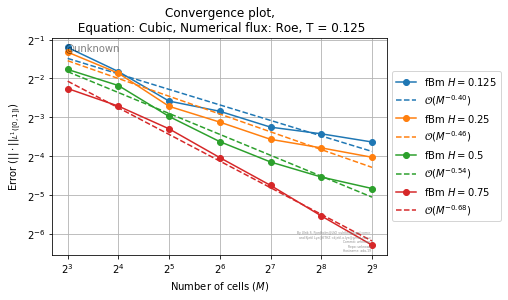

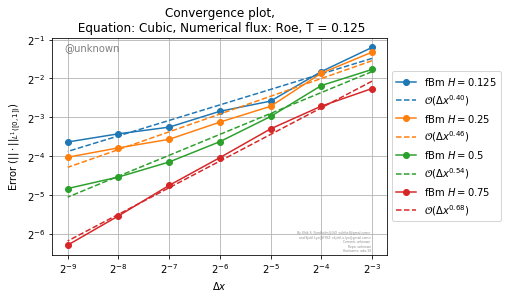

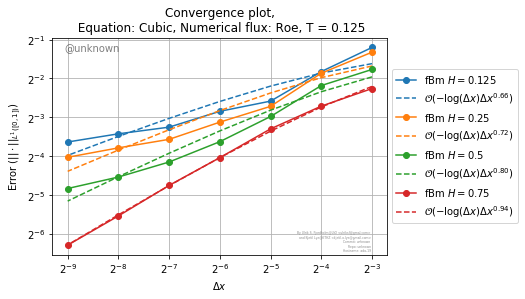

2019-04-08 08:20:52.471401 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.125
2019-04-08 08:21:39.334167 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.125
2019-04-08 08:22:22.323699 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 0.125
2019-04-08 08:23:00.924220 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 0.125


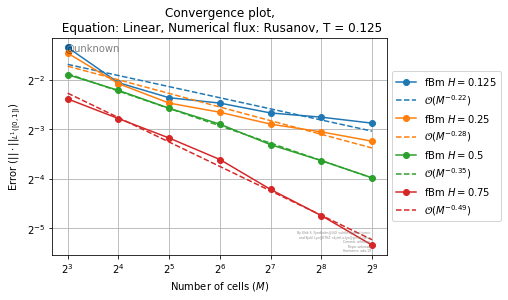

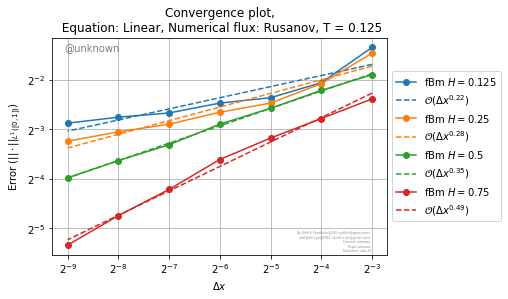

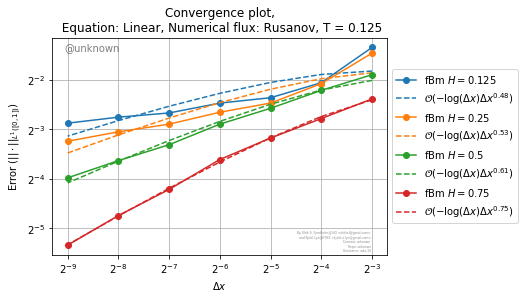

2019-04-08 08:23:51.305680 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.125
2019-04-08 08:24:32.833780 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.125
2019-04-08 08:25:11.580963 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 0.125
2019-04-08 08:25:52.907038 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 0.125


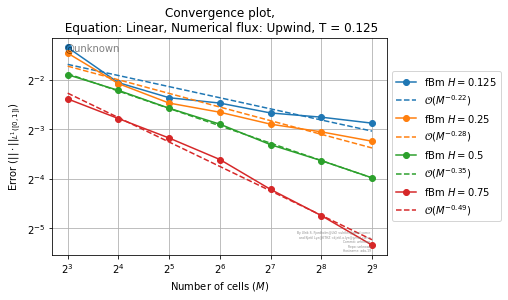

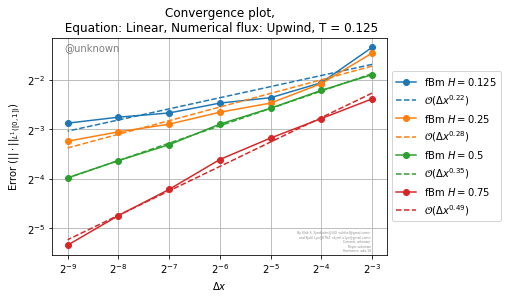

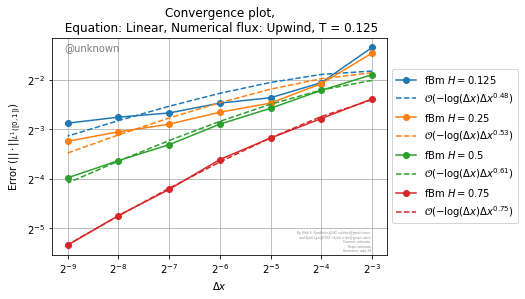

2019-04-08 08:26:58.222622 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.25
2019-04-08 08:27:59.349316 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.25
2019-04-08 08:29:12.057096 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 0.25
2019-04-08 08:30:29.229401 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 0.25


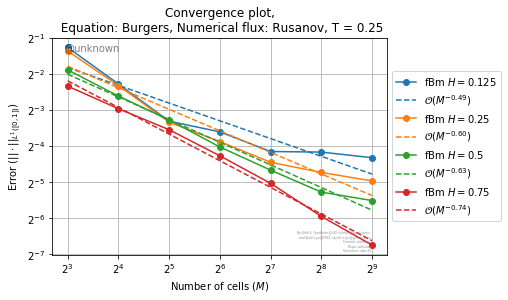

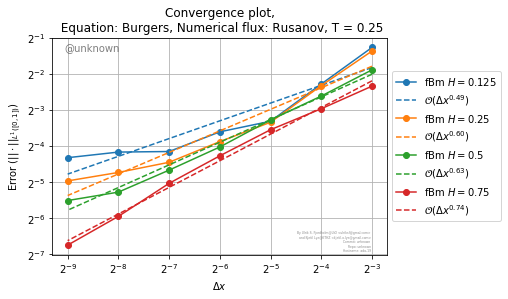

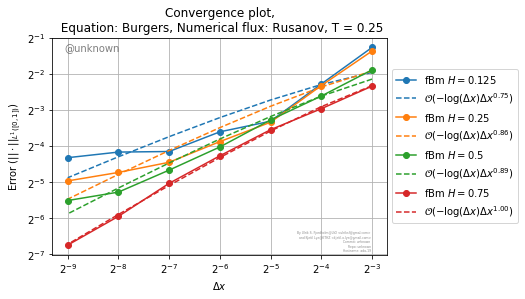

2019-04-08 08:31:42.402037 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.25
2019-04-08 08:32:50.204841 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.25
2019-04-08 08:34:11.585836 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 0.25
2019-04-08 08:35:38.653762 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 0.25


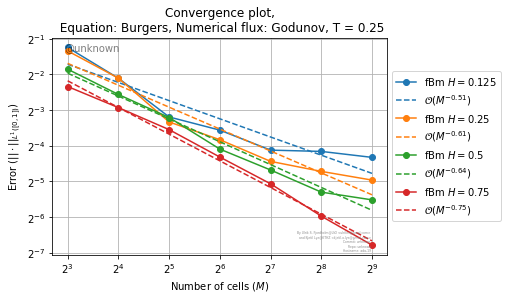

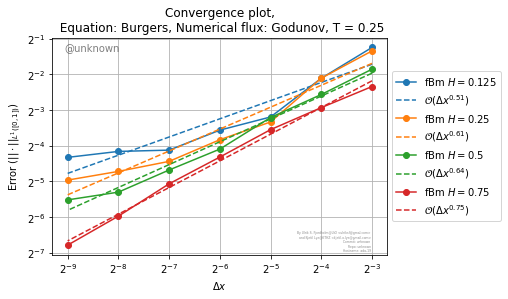

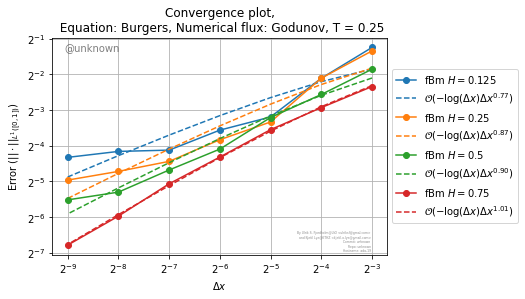

2019-04-08 08:36:48.020700 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.25
2019-04-08 08:37:47.354271 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.25
2019-04-08 08:39:01.599174 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 0.25
2019-04-08 08:40:22.674302 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 0.25


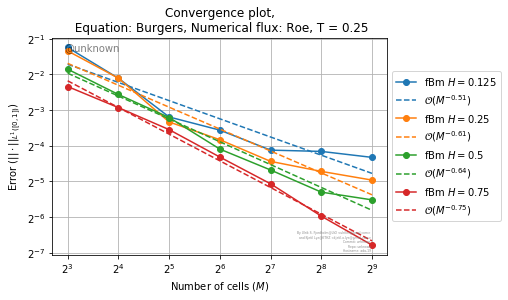

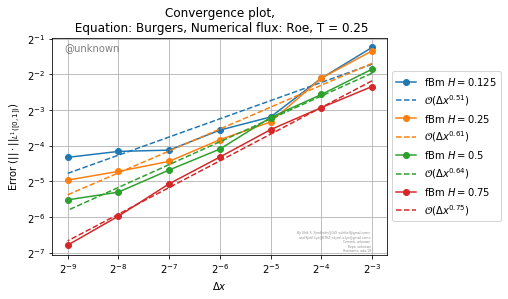

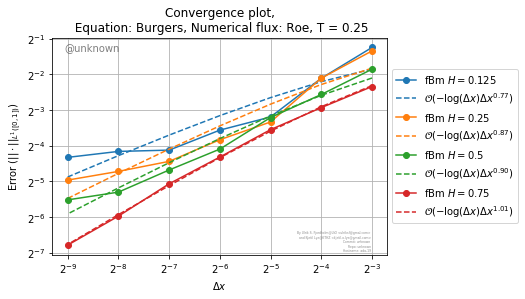

2019-04-08 08:41:21.861805 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.25
2019-04-08 08:42:13.421707 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.25
2019-04-08 08:43:23.853914 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 0.25
2019-04-08 08:44:42.862521 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 0.25


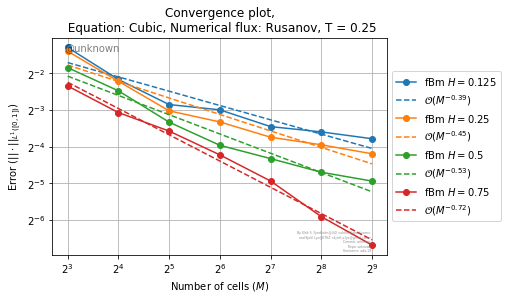

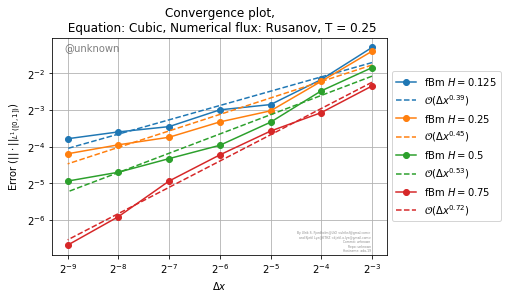

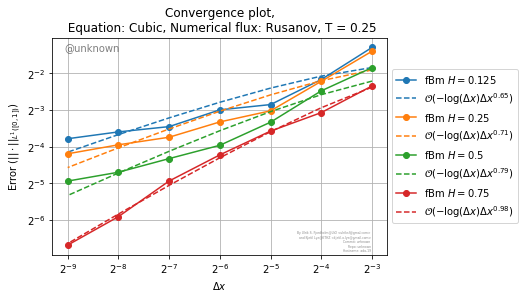

2019-04-08 08:45:40.170864 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.25
2019-04-08 08:47:10.274570 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.25
2019-04-08 08:48:30.937701 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 0.25
2019-04-08 08:49:54.359206 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 0.25


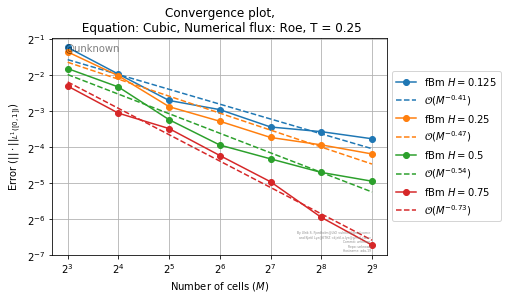

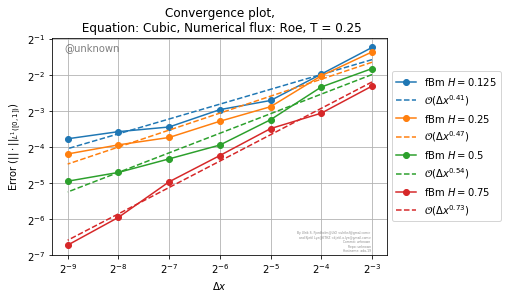

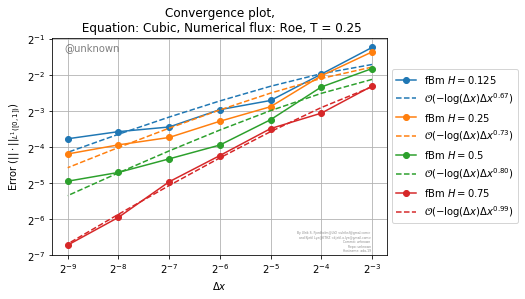

2019-04-08 08:51:22.763033 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.25
2019-04-08 08:52:33.102187 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.25
2019-04-08 08:53:39.740253 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 0.25
2019-04-08 08:54:50.162460 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 0.25


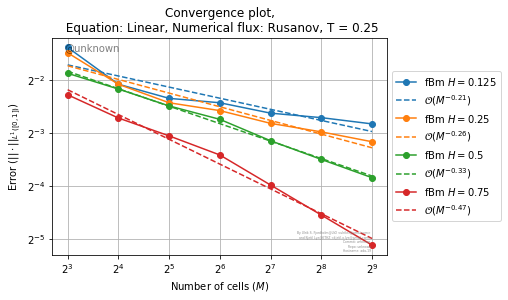

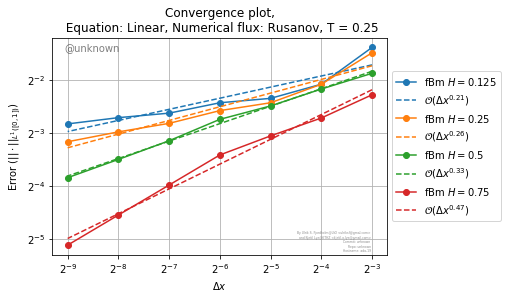

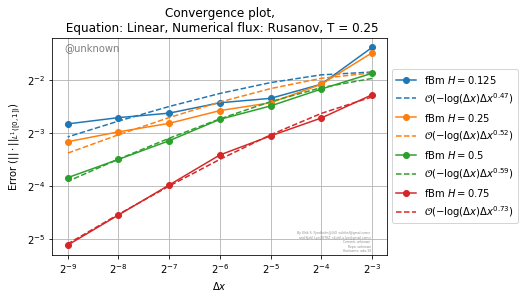

2019-04-08 08:56:16.378022 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.25
2019-04-08 08:57:24.369121 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.25
2019-04-08 08:58:32.619472 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 0.25
2019-04-08 08:59:40.549856 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 0.25


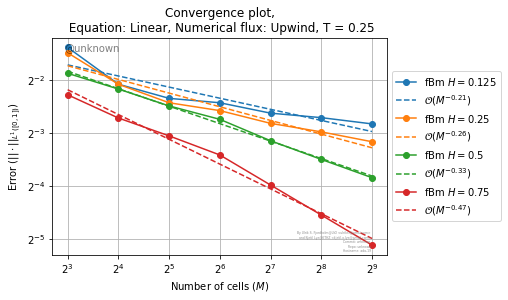

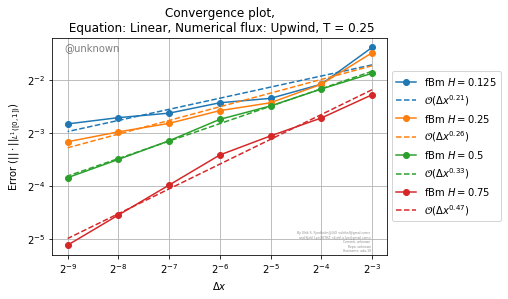

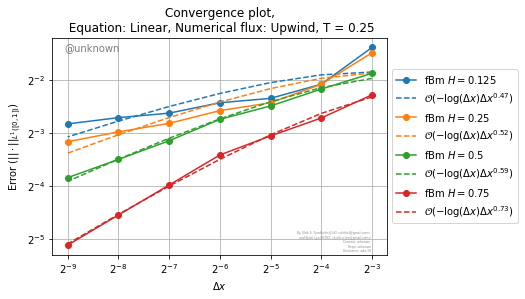

2019-04-08 09:02:17.375519 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 1
2019-04-08 09:05:12.126468 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 1
2019-04-08 09:09:03.581638 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 1
2019-04-08 09:13:25.541491 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 1


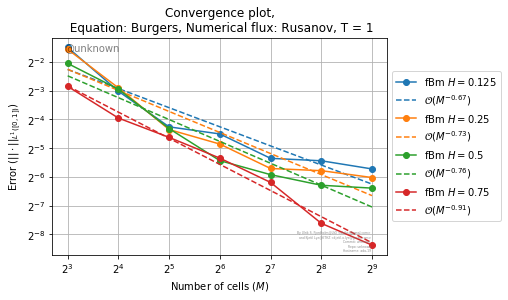

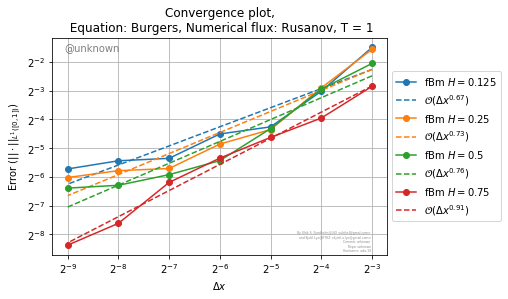

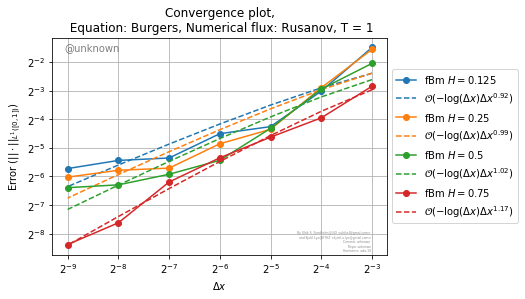

2019-04-08 09:16:16.218266 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 1
2019-04-08 09:19:29.409996 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 1
2019-04-08 09:24:01.169764 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 1
2019-04-08 09:28:58.871169 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 1


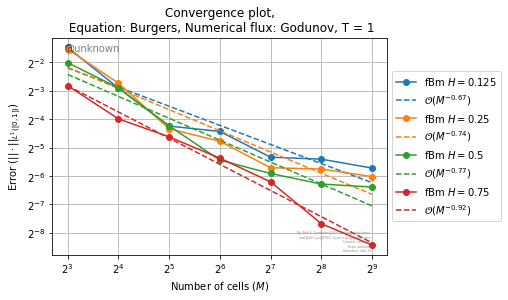

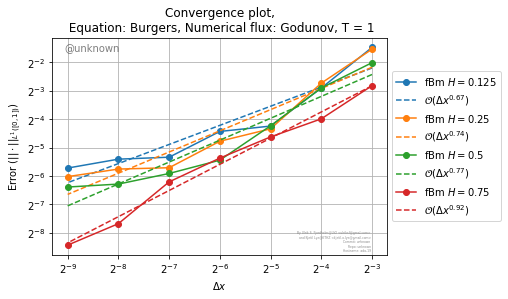

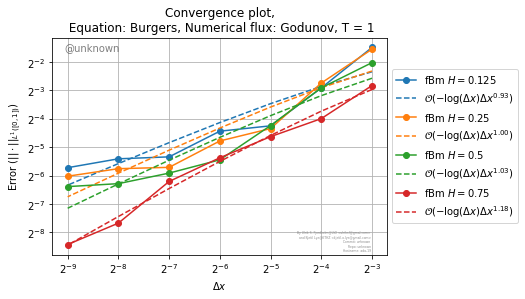

2019-04-08 09:31:33.223168 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 1
2019-04-08 09:34:25.532744 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 1
2019-04-08 09:38:20.556303 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 1
2019-04-08 09:42:41.612065 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 1


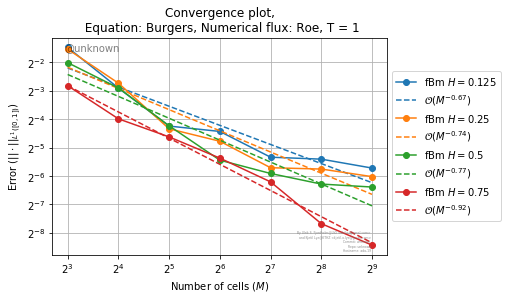

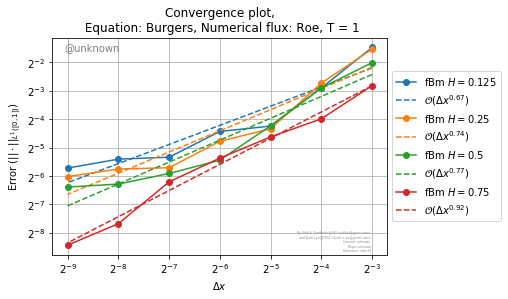

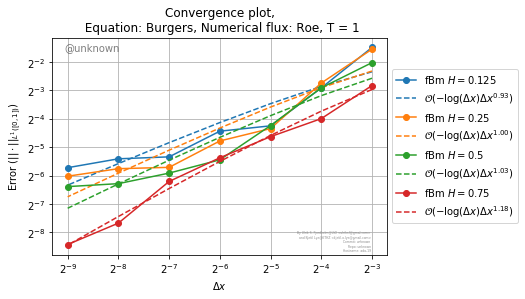

2019-04-08 09:44:21.245101 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 1
2019-04-08 09:46:33.766344 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 1
2019-04-08 09:49:39.728037 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 1
2019-04-08 09:53:37.349796 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 1


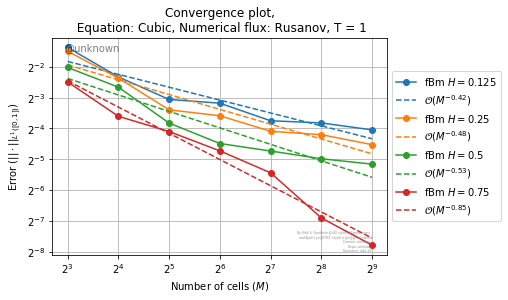

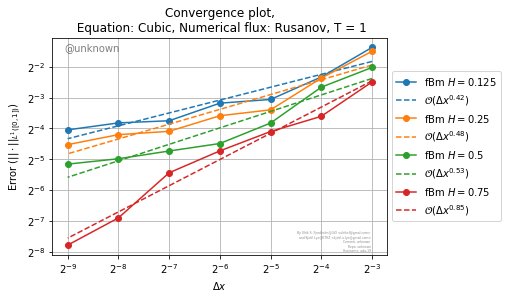

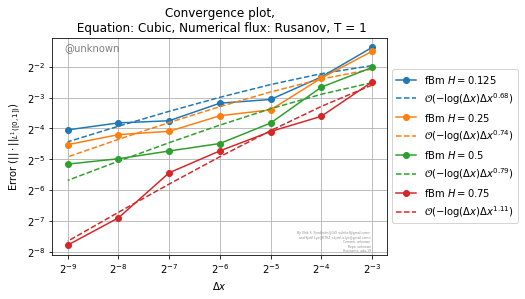

2019-04-08 09:55:26.095932 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 1
2019-04-08 09:57:39.269263 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 1
2019-04-08 10:01:05.965761 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 1
2019-04-08 10:05:12.935757 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 1


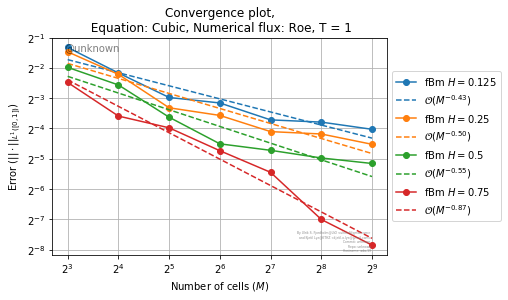

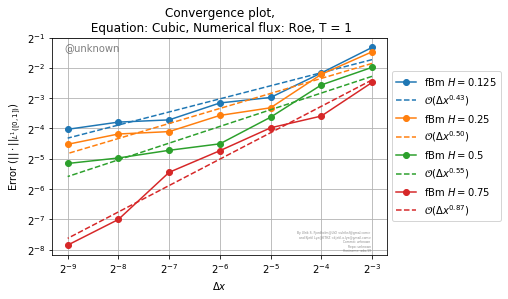

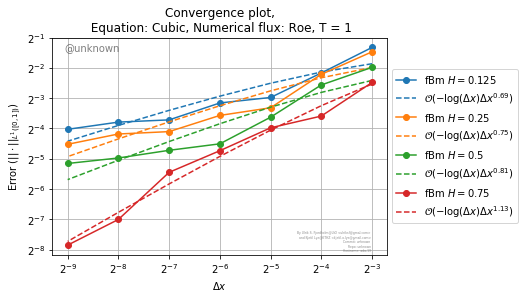

2019-04-08 10:09:40.004254 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 1
2019-04-08 10:13:53.208947 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 1
2019-04-08 10:18:09.675438 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 1
2019-04-08 10:22:44.824374 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 1


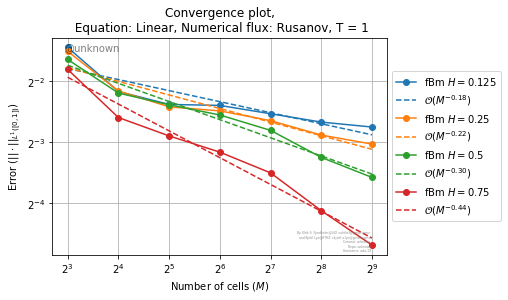

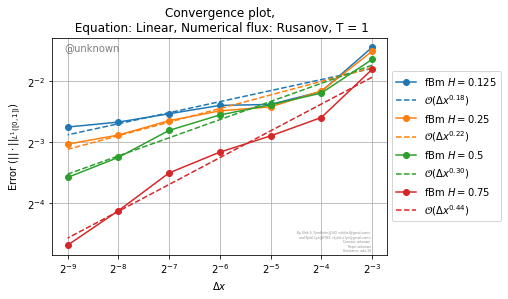

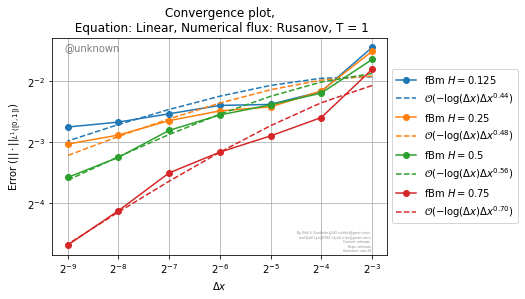

2019-04-08 10:27:01.553101 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 1
2019-04-08 10:30:57.286651 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 1
2019-04-08 10:35:00.334005 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 1
2019-04-08 10:39:07.402353 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 1


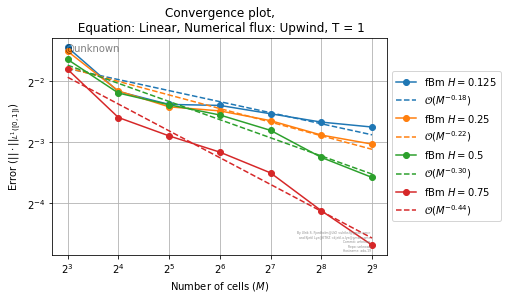

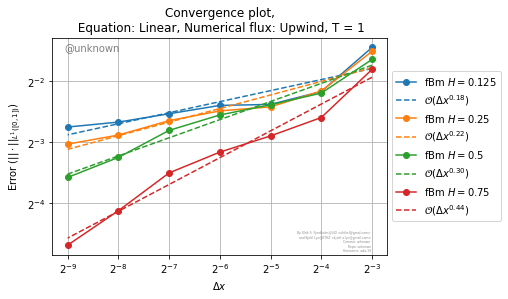

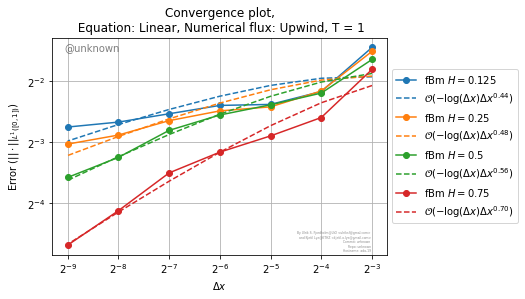

In [6]:
def run_fbm_convergence(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

   
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        run_convergence(base_xml, name, T, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
        
    plt.figure(0)
    plt.title("Convergence plot,\n Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_convergence_M_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    
    plt.figure(1)
    plt.title("Convergence plot,\n Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_convergence_dx_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    
    plt.figure(2)
    plt.title("Convergence plot,\n Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_convergence_log_dx_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    plt.show()
    
for T in [1/2048., 1/256., 1/8, 1.0/4, 1]:
    run_all_configurations(run_fbm_convergence, T)
                                             

# TV over time

In [7]:
def TV_versus_time(base_xml, title, T, 
                    exact_solution_class=None,
                    numerical_flux="rusanov",
                    equation="burgers"):
    plot_info.console_log_show("Running TV versus time for {}, T={}".format(base_xml, T))
    N = 128
    M = COMPUTATIONAL_BUDGET//N
    
    run = alsvinn.run(name="TV_solution",
        base_xml=base_xml,
        number_of_saves=N,
        dimension=[M,1,1],
        flux=numerical_flux,
        equation=equation,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    TVs = []
    Ts = np.linspace(0,T,N)
    for t_index in range(N):
        u = run.get_data("u", t_index)
        
        tv_u = np.sum(abs(np.diff(u)))
        TVs.append(tv_u)
    TVs = np.array(TVs)
    
    poly = np.polyfit(Ts[1:], 1.0/TVs[1:], 1)
    
    print(poly)
    
    line_info = plt.plot(Ts, 1.0/TVs, label=title)
    
    plt.plot(Ts[1:], poly[0]*Ts[1:]+poly[1],
             '--',
             color=line_info[0].get_color(),
             label='$%.3f t %+.3f$' % (poly[0], poly[1]))
    plt.title("T = {}".format(T))
    plot_info.legendLeft()
    plt.xlabel("$t$")
    plt.ylabel("$\\left(\\mathrm{TV}(u(\\cdot, t)\\right)^{-1}$")


2019-04-08 10:39:20.573784 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.5317174  0.04750267]
2019-04-08 10:39:22.812084 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.52508787 0.05626253]
2019-04-08 10:39:24.881812 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.52954391 0.07162543]
2019-04-08 10:39:26.927072 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.4849991  0.12516299]


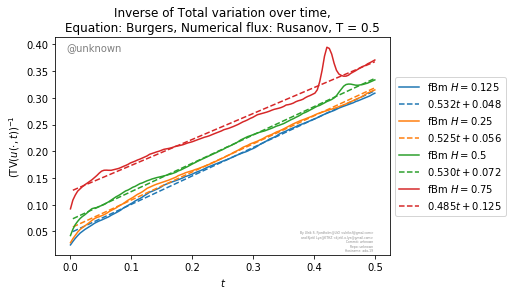

2019-04-08 10:39:32.253410 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.53477936 0.03923629]
2019-04-08 10:39:34.370956 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.52621512 0.0501209 ]
2019-04-08 10:39:36.432609 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.52684658 0.06910439]
2019-04-08 10:39:38.516384 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.4851465  0.12382707]


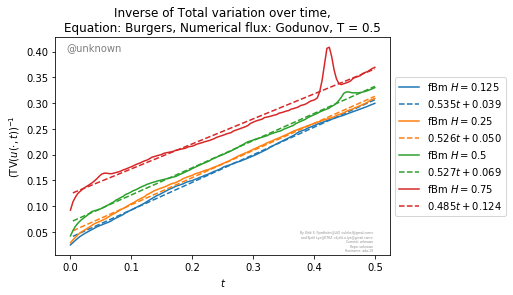

2019-04-08 10:39:43.864700 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.53477936 0.03923629]
2019-04-08 10:39:46.035418 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.52621512 0.0501209 ]
2019-04-08 10:39:48.121170 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.52684658 0.06910439]
2019-04-08 10:39:50.240017 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.4851465  0.12382707]


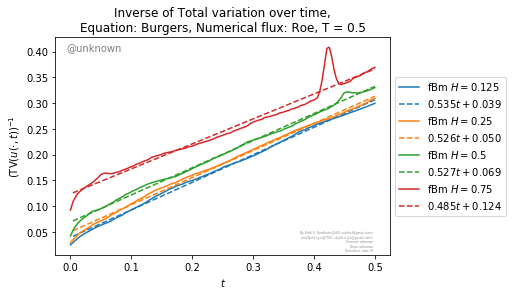

2019-04-08 10:39:55.608930 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.17483047 0.03947706]
2019-04-08 10:39:57.598452 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.20744925 0.04582369]
2019-04-08 10:39:59.598877 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.31305855 0.06594906]
2019-04-08 10:40:03.862355 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.23736651 0.1234742 ]


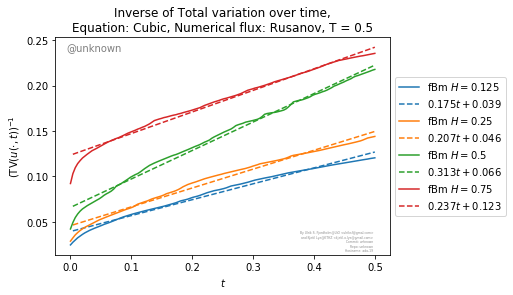

2019-04-08 10:40:09.054773 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.15946599 0.03355928]
2019-04-08 10:40:11.092855 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.19375848 0.0387164 ]
2019-04-08 10:40:13.120573 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.31627159 0.06077256]
2019-04-08 10:40:15.187093 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.23719707 0.12158498]


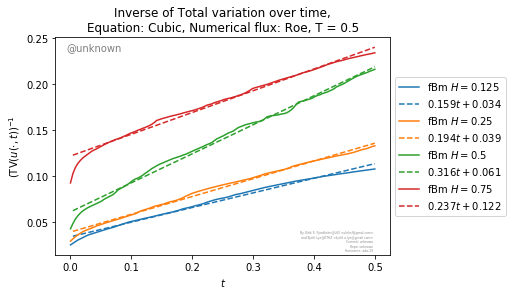

2019-04-08 10:40:20.386460 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.28879507 0.10761796]
2019-04-08 10:40:22.892582 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.24581601 0.10962279]
2019-04-08 10:40:25.259632 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.16651945 0.11542134]
2019-04-08 10:40:27.615311 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.13812171 0.17653523]


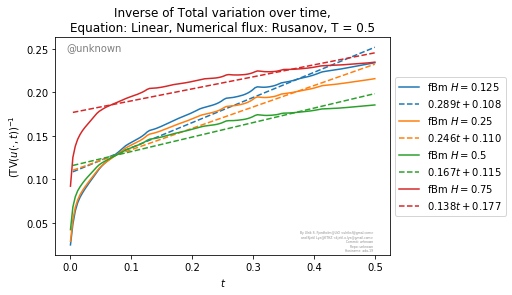

2019-04-08 10:40:33.015045 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.28879507 0.10761796]
2019-04-08 10:40:39.305975 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.24581601 0.10962279]
2019-04-08 10:40:41.633513 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.16651945 0.11542134]
2019-04-08 10:40:44.136116 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.13812171 0.17653523]


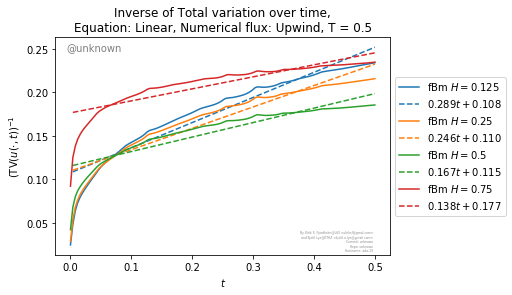

In [8]:
def run_fbm_tv(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

   
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        TV_versus_time(base_xml, name, T, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
    plt.title("Inverse of Total variation over time,\nEquation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.showAndSave("fbm_tv_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
T = 0.5
run_all_configurations(run_fbm_tv, T)
                                             

# Plotting solutions at single times

In [9]:
def plot_solution(base_xml, title, T, M, 
                exact_solution_class=None,
                numerical_flux="rusanov",
                equation="burgers"):
    
    plot_info.console_log_show("Running plot solution for {}, T={}, flux={}, equation={}".format(base_xml,
                                                                                                 T,
                                                                                                numerical_flux,
                                                                                                equation))

    
    run = alsvinn.run(name="TV_solution",
        base_xml=base_xml,
        number_of_saves=1,
        dimension=[M,1,1],
        flux=numerical_flux,
        equation=equation,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    
    t_indices = [0, 1]
    ts = [0, T]
    for t_index in t_indices:
        t = ts[t_index]
        u = run.get_data("u", t_index)
        x = np.linspace(0, 1, u.shape[0])
        
        plt.figure(t_index)
        plt.plot(x, u)
        plt.xlabel("$x$")
        plt.ylabel("$u(x,{})$".format(t))
        

2019-04-08 10:40:49.619375 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers


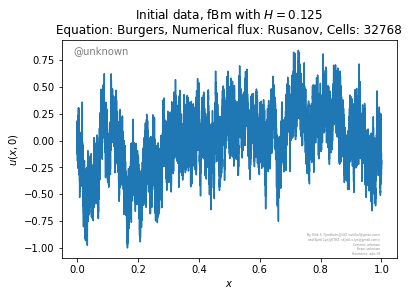

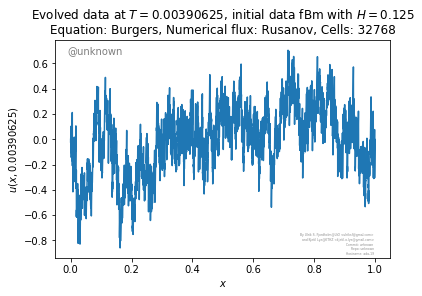

2019-04-08 10:40:59.648942 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers


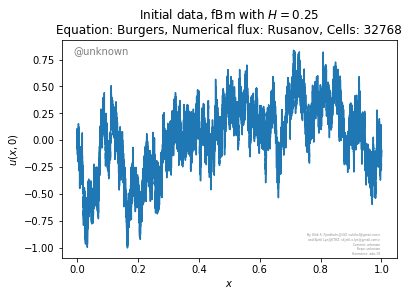

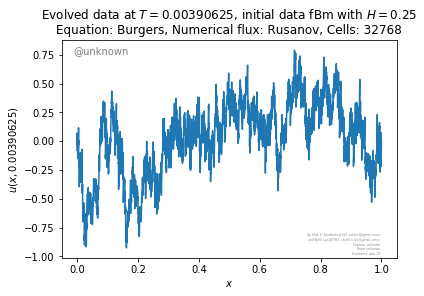

2019-04-08 10:41:11.064892 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers


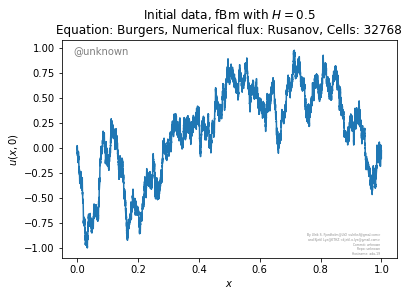

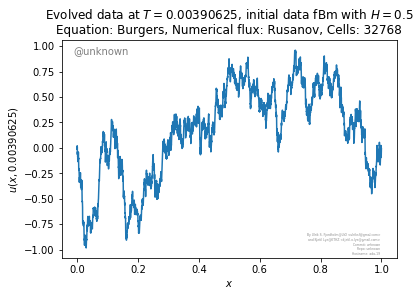

2019-04-08 10:41:20.519822 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers


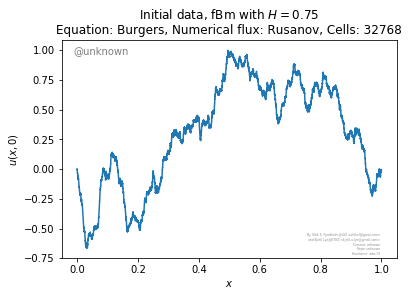

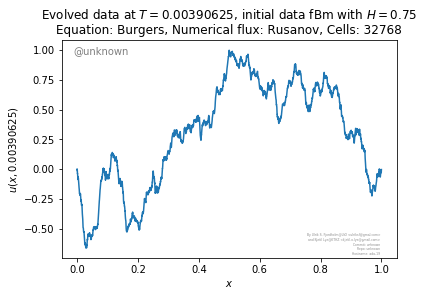

2019-04-08 10:41:29.734798 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers


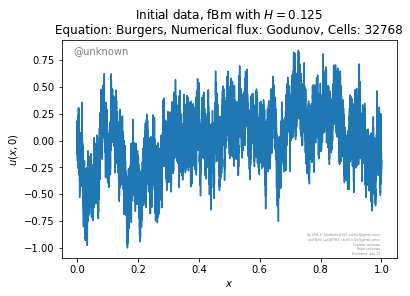

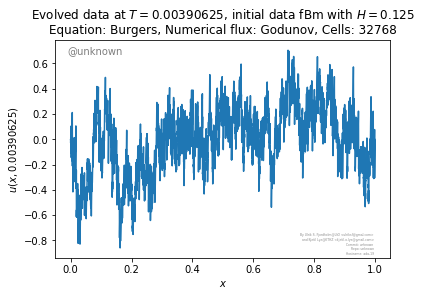

2019-04-08 10:41:39.999062 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers


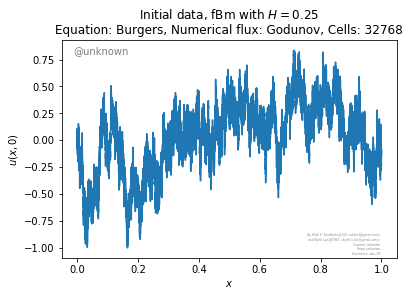

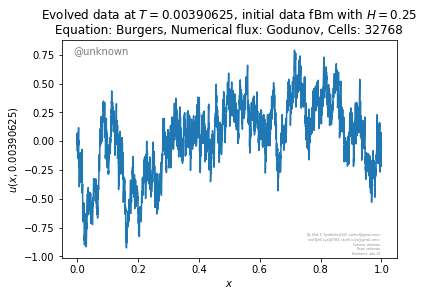

2019-04-08 10:41:50.003832 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers


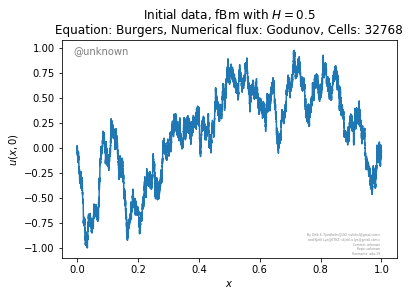

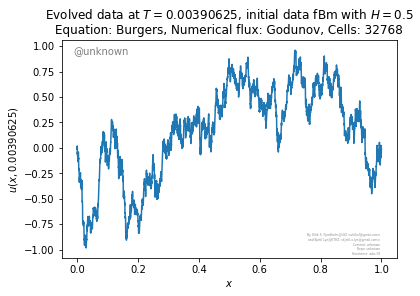

2019-04-08 10:41:59.963549 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers


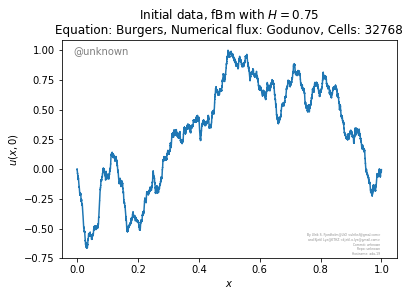

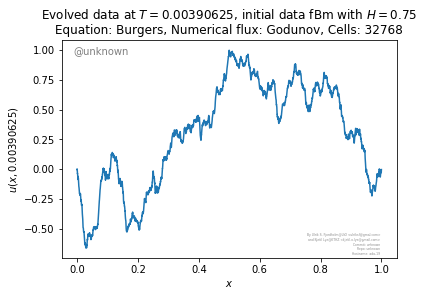

2019-04-08 10:42:09.734538 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers


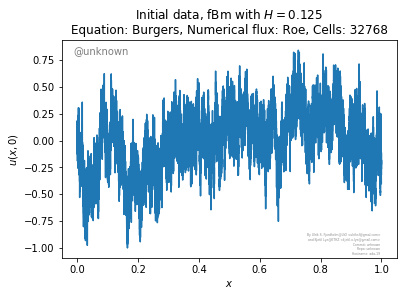

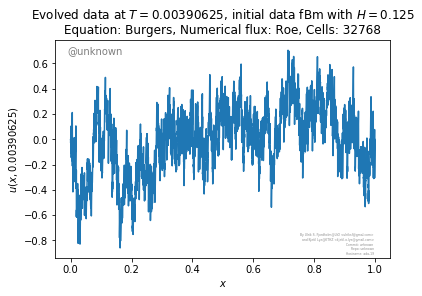

2019-04-08 10:42:19.635224 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers


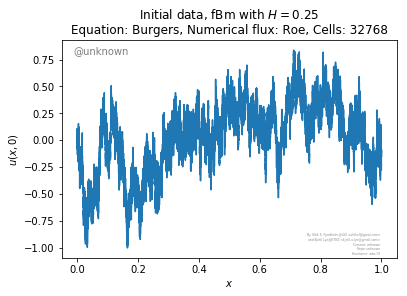

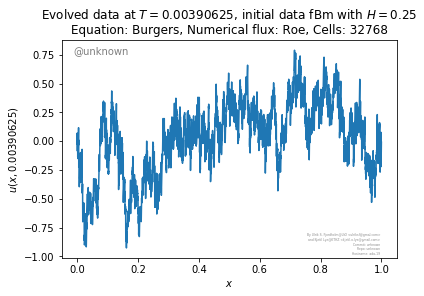

2019-04-08 10:42:29.747543 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers


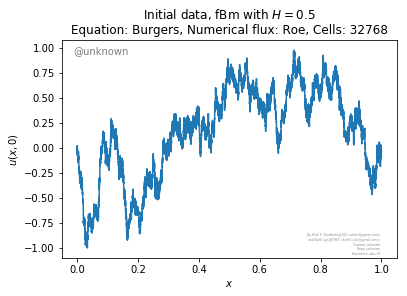

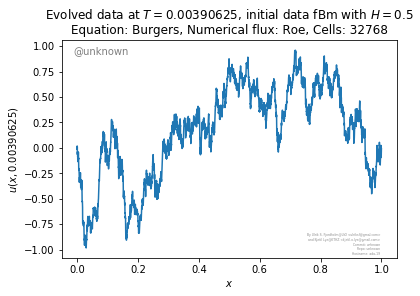

2019-04-08 10:42:39.250936 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers


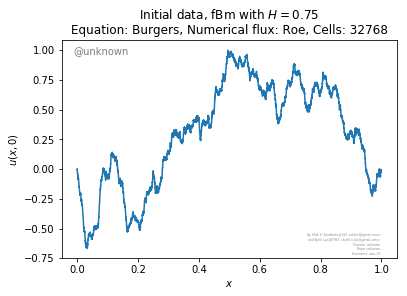

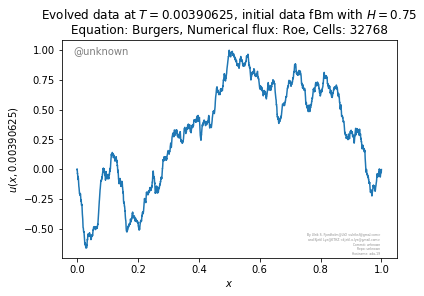

2019-04-08 10:42:48.654028 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic


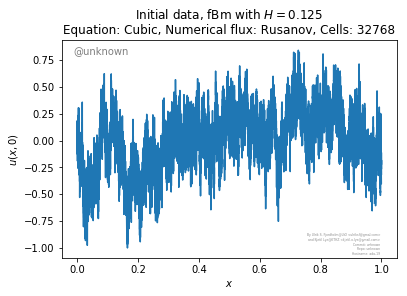

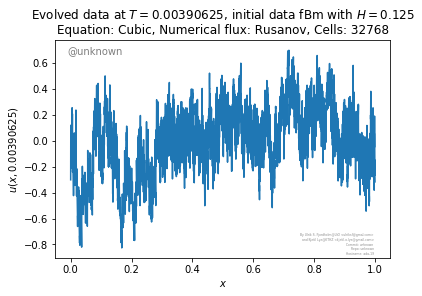

2019-04-08 10:42:58.425218 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic


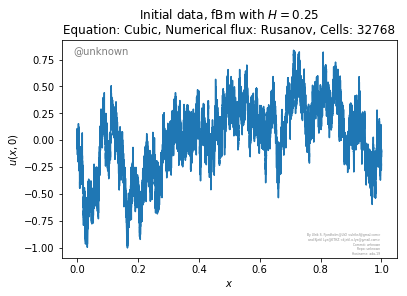

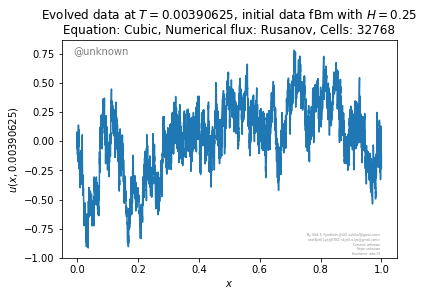

2019-04-08 10:43:07.971656 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic


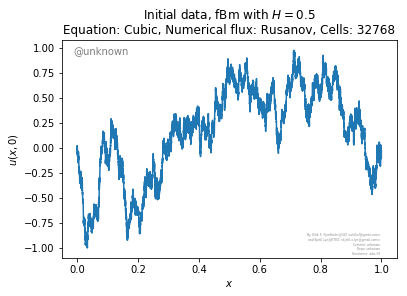

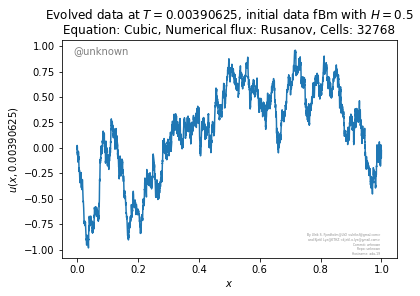

2019-04-08 10:43:17.582488 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic


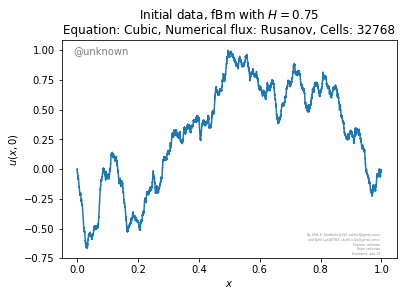

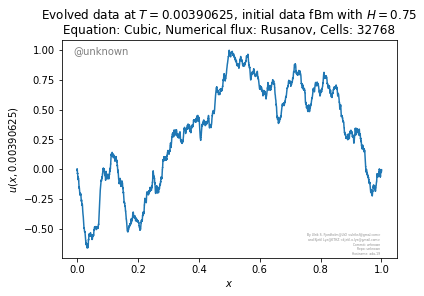

2019-04-08 10:43:27.166325 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic


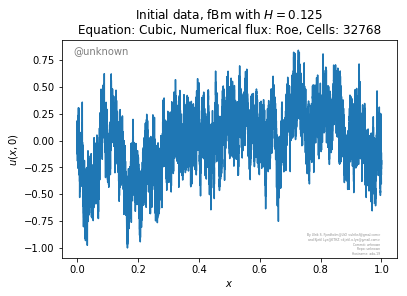

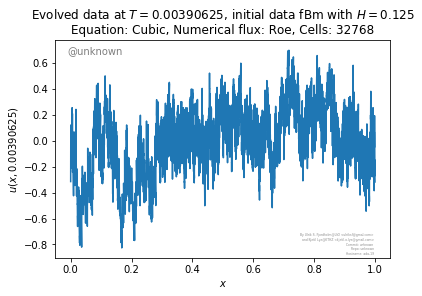

2019-04-08 10:43:37.063988 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic


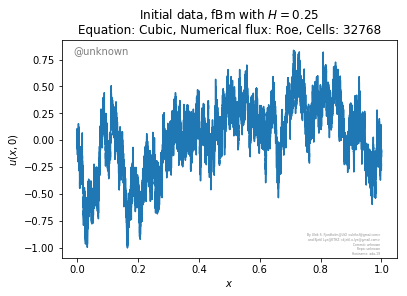

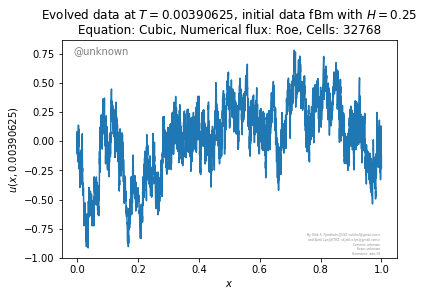

2019-04-08 10:43:50.656530 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic


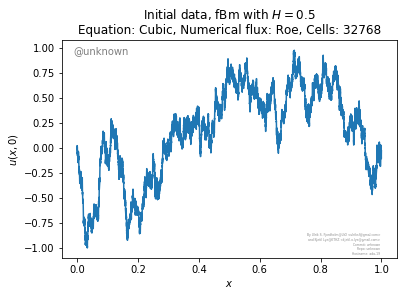

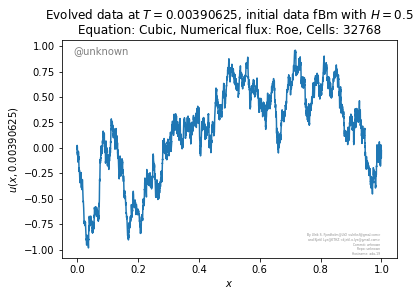

2019-04-08 10:44:00.568330 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic


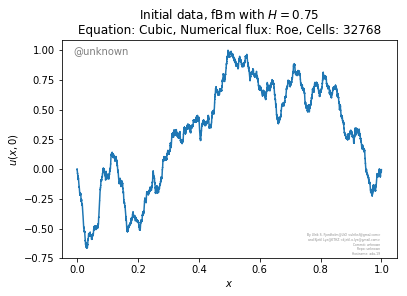

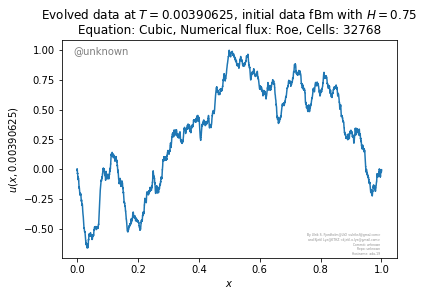

2019-04-08 10:44:10.191791 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear


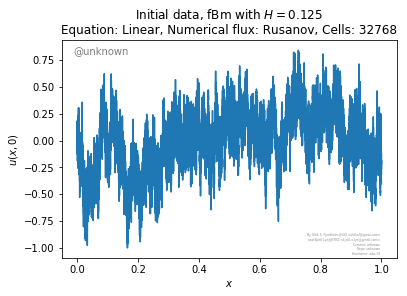

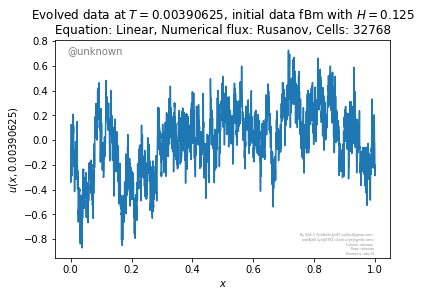

2019-04-08 10:44:20.230425 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear


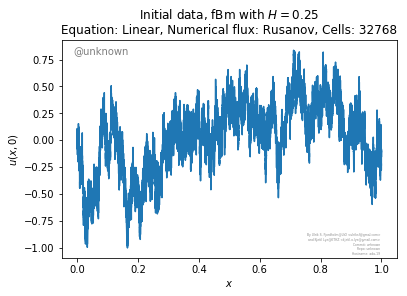

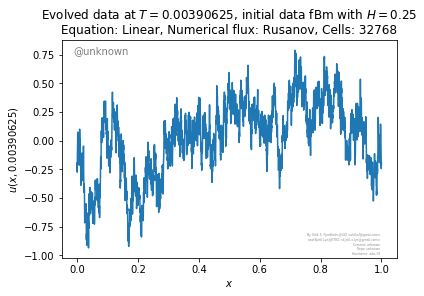

2019-04-08 10:44:29.451037 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear


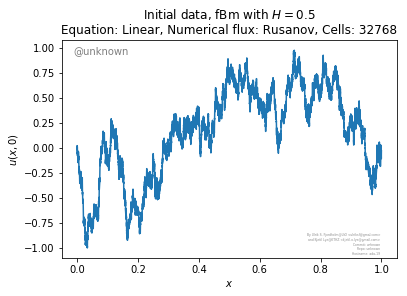

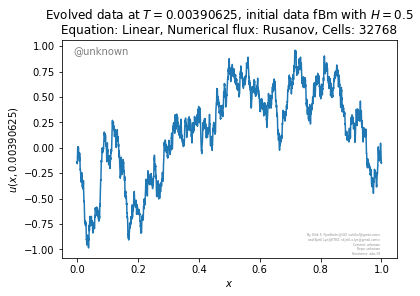

2019-04-08 10:44:38.383403 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear


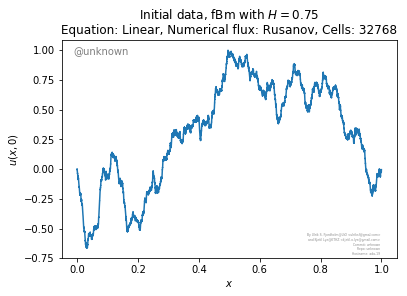

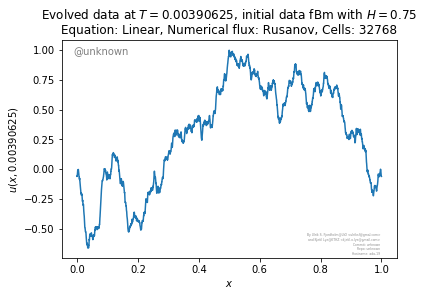

2019-04-08 10:44:47.922526 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear


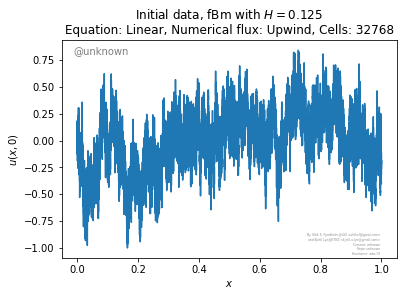

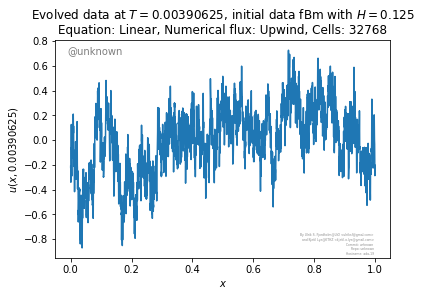

2019-04-08 10:44:57.792496 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear


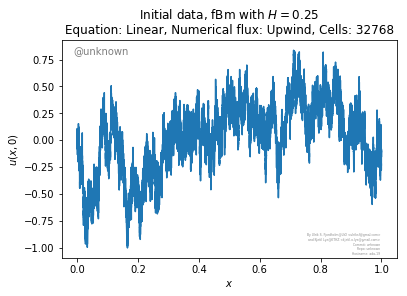

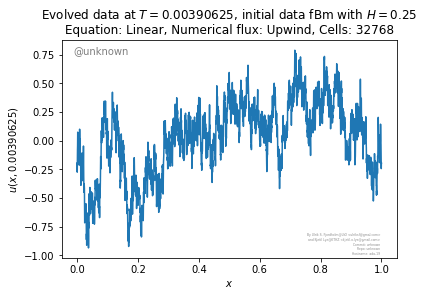

2019-04-08 10:45:17.086943 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear


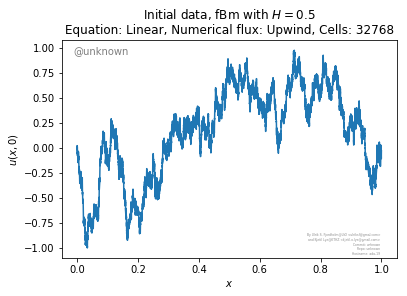

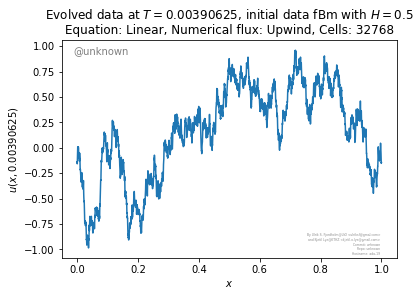

2019-04-08 10:45:25.895878 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear


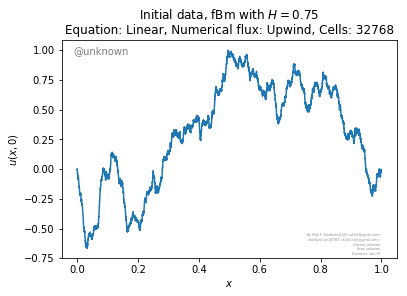

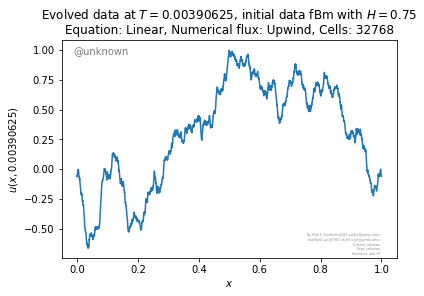

2019-04-08 10:45:34.485095 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers


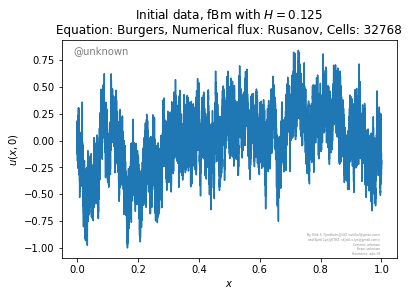

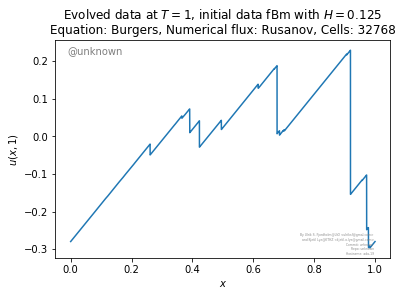

2019-04-08 10:52:15.411233 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers


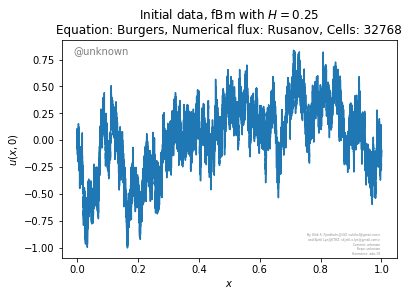

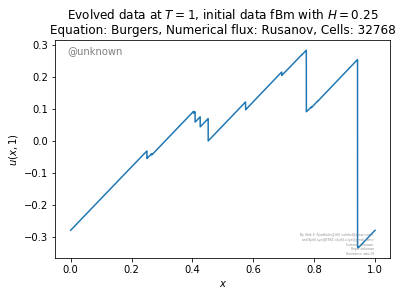

2019-04-08 11:00:56.879759 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers


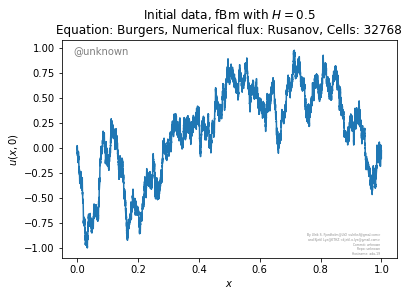

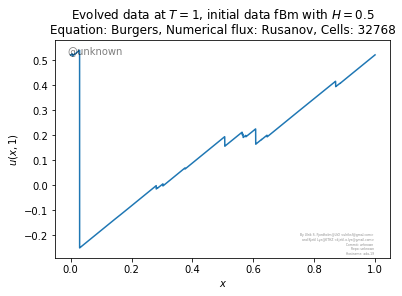

2019-04-08 11:12:54.635153 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers


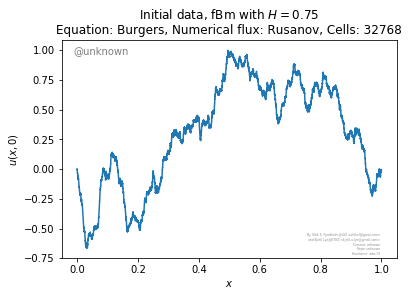

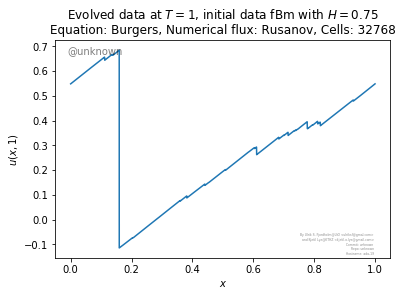

2019-04-08 11:26:21.927080 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=godunov, equation=burgers


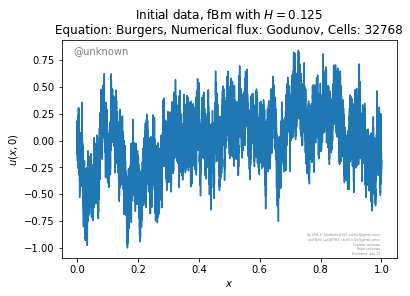

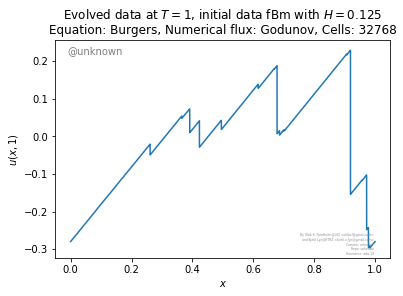

2019-04-08 11:34:01.479065 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=godunov, equation=burgers


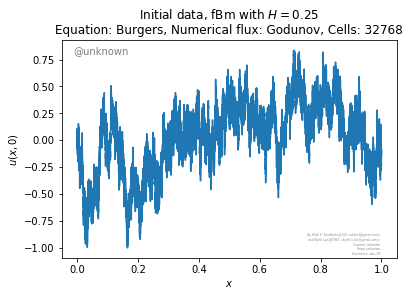

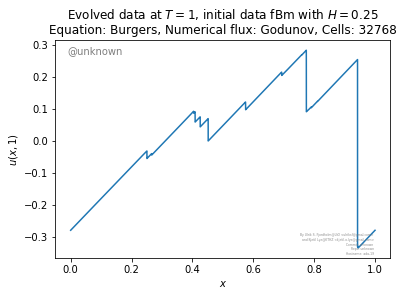

2019-04-08 11:44:12.023033 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=godunov, equation=burgers


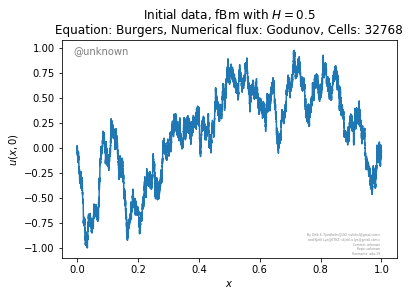

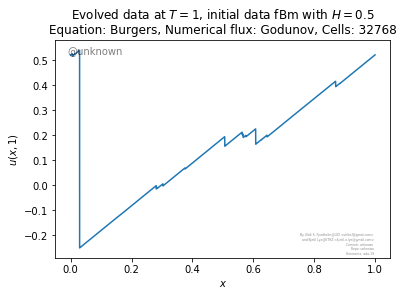

2019-04-08 11:58:00.198407 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=godunov, equation=burgers


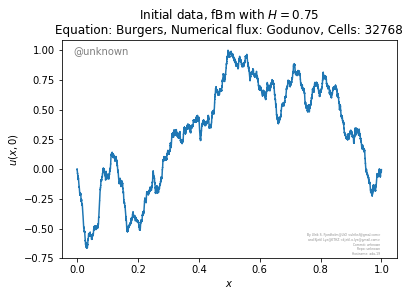

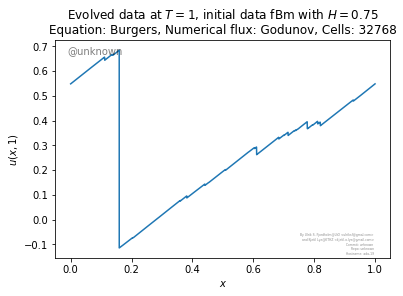

2019-04-08 12:13:27.529223 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=burgers


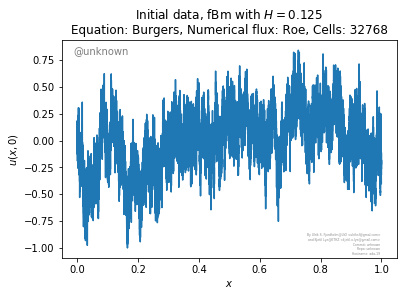

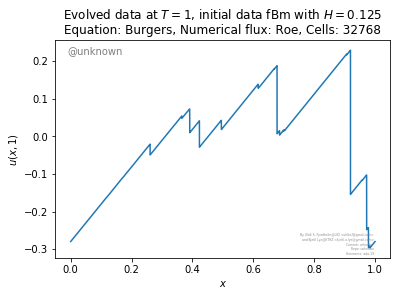

2019-04-08 12:20:18.600527 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=burgers


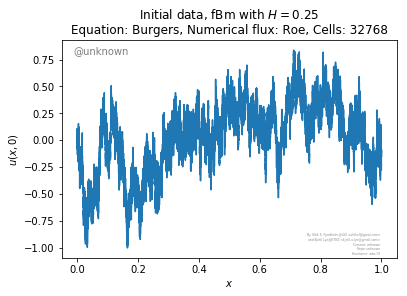

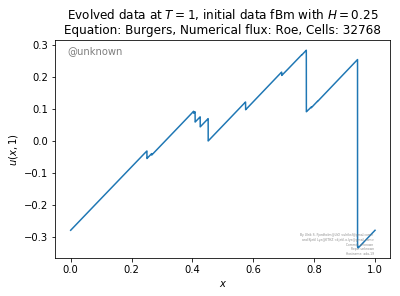

2019-04-08 12:29:29.004153 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=burgers


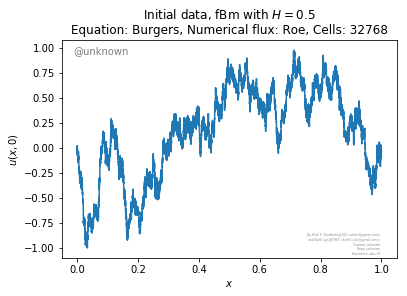

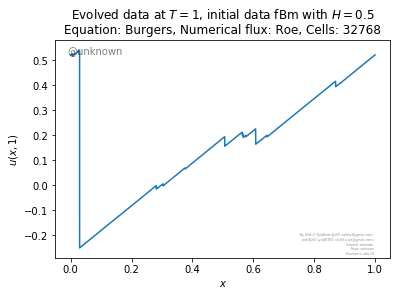

2019-04-08 12:41:46.354012 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=roe, equation=burgers


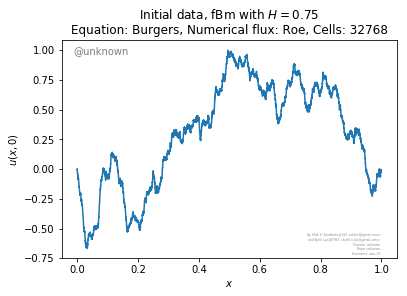

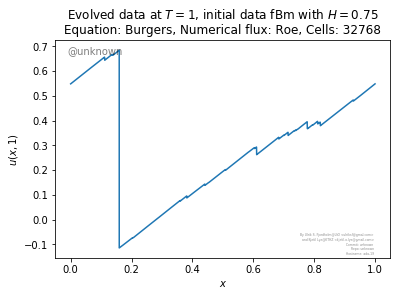

2019-04-08 12:55:18.712037 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic


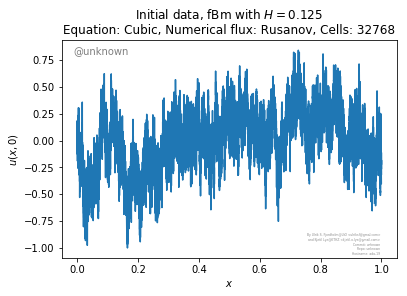

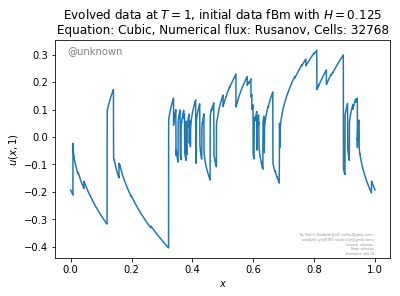

2019-04-08 12:59:27.201120 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic


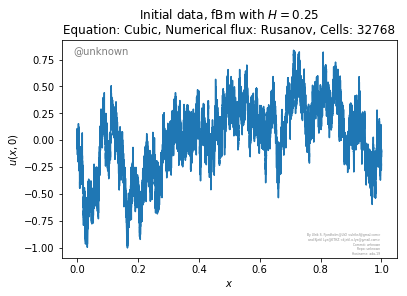

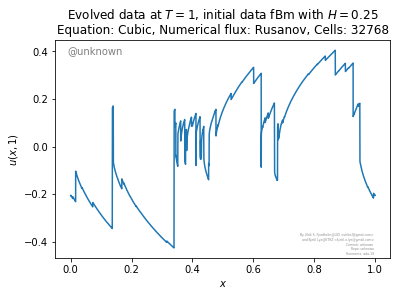

2019-04-08 13:05:51.123717 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic


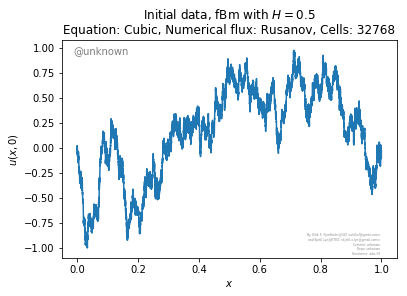

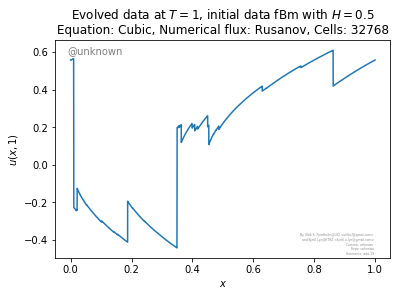

2019-04-08 13:15:49.033235 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic


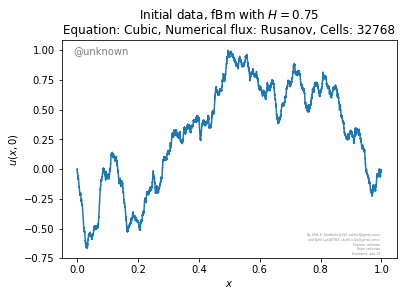

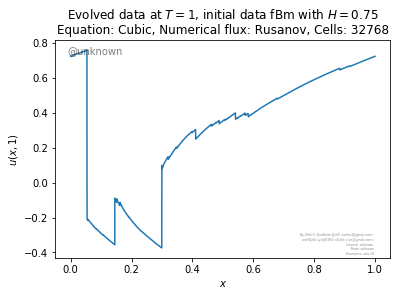

2019-04-08 20:39:34.803556 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=cubic


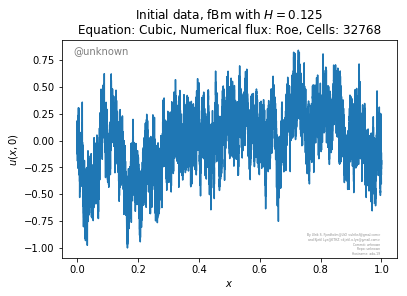

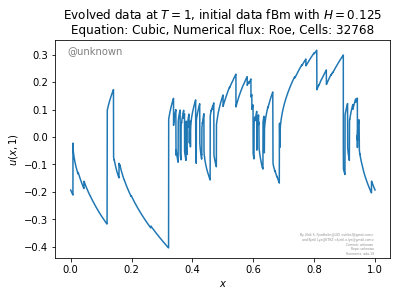

2019-04-09 07:41:57.000885 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=cubic


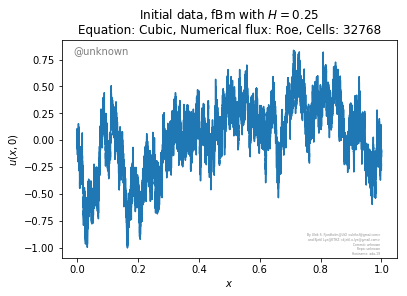

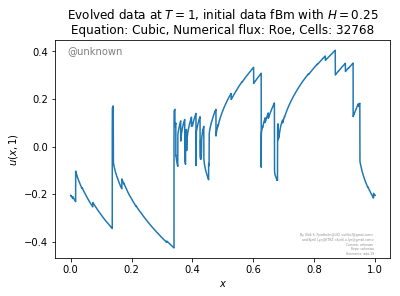

2019-04-09 13:29:25.503990 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=cubic


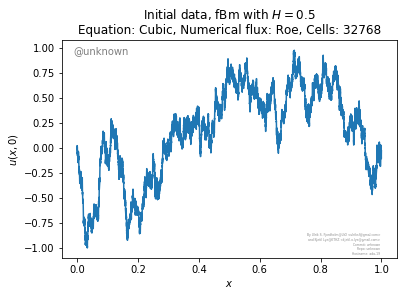

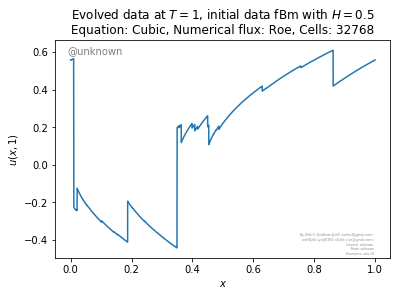

2019-04-09 13:40:23.301814 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=roe, equation=cubic


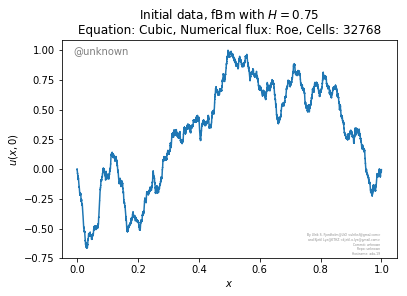

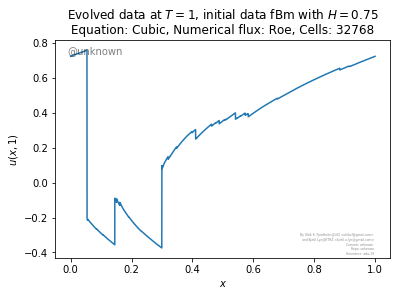

2019-04-09 13:53:55.291219 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=linear


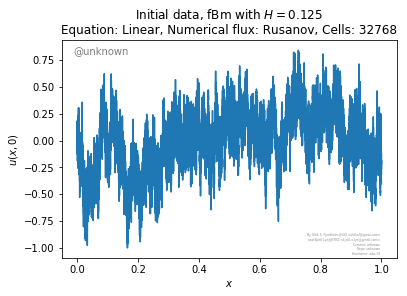

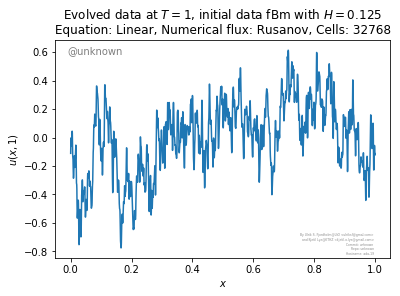

2019-04-09 14:06:41.571733 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=linear


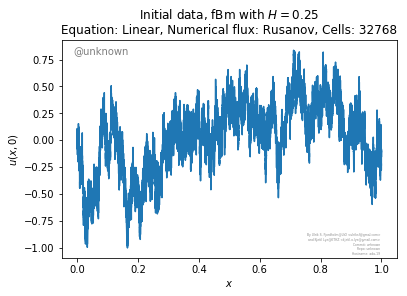

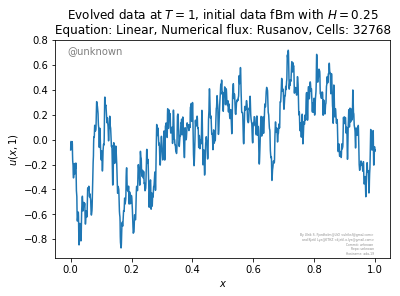

2019-04-09 14:19:17.896588 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=linear


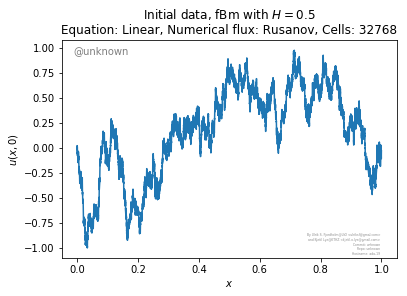

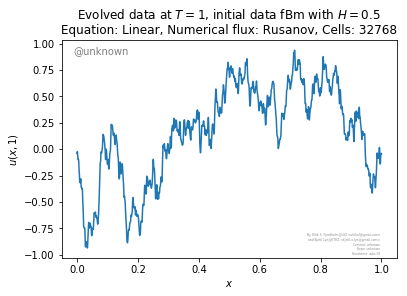

2019-04-09 18:40:12.970791 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=linear


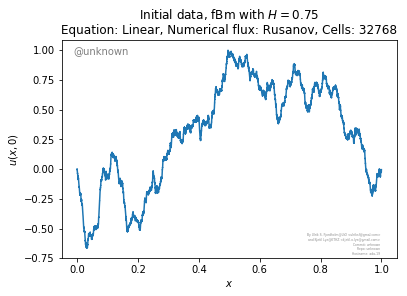

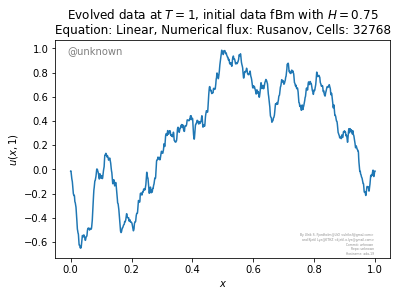

2019-04-09 18:52:57.109079 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=upwind, equation=linear


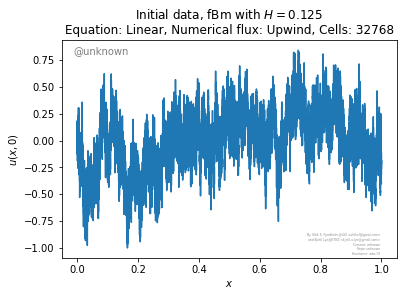

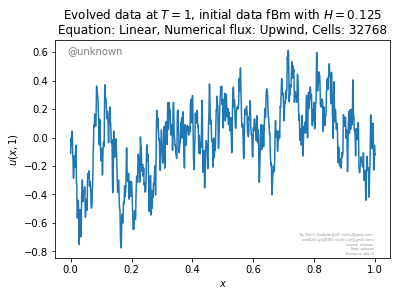

2019-04-09 19:05:06.527729 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=upwind, equation=linear


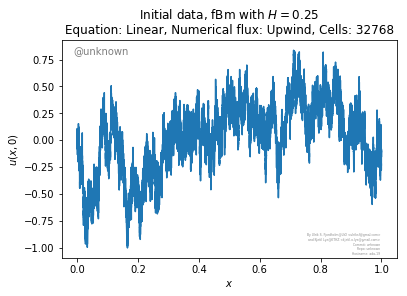

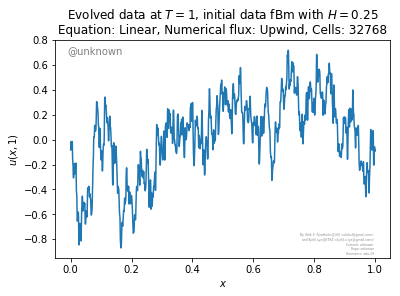

2019-04-09 19:17:26.959121 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=upwind, equation=linear


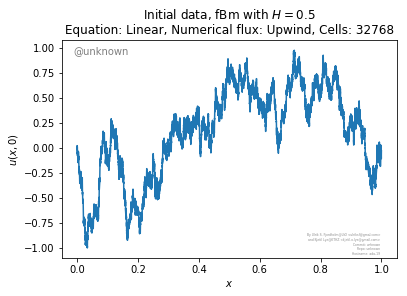

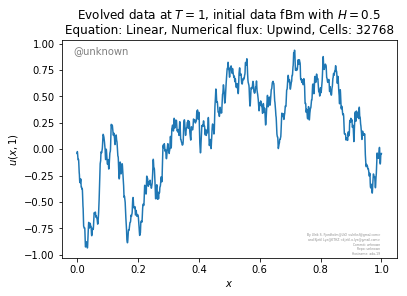

2019-04-09 19:29:37.757581 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=upwind, equation=linear


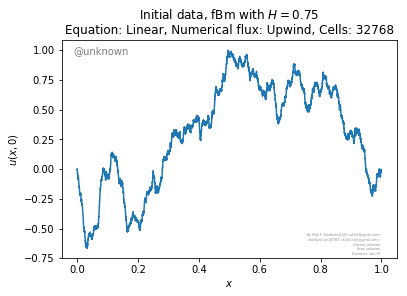

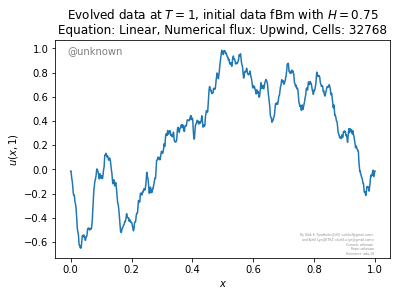

2019-04-09 19:41:53.163230 (in <module>): Done with fbm conv


In [10]:
def run_fbm_plot(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

    N = COMPUTATIONAL_BUDGET
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        plot_solution(base_xml, name, T, N, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
        plt.figure(0)
        plt.title("Initial data, fBm with $H={hurz}$\nEquation: {equation}, Numerical flux: {numerical_flux}, Cells: {N}"\
              .format(hurz=H, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), N=N))
        
        plot_info.savePlot("fbm_initial_{equation}_{H}_{numerical_flux}"
                .format(equation=equation, H=str(H).replace(".", "_"), numerical_flux=numerical_flux))
        
        plt.figure(1)
        plt.title("Evolved data at $T={T}$, initial data fBm with $H={hurz}$\nEquation: {equation}, Numerical flux: {numerical_flux}, Cells: {N}"\
              .format(hurz=H, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T, N=N))
        
                        
        plot_info.savePlot("fbm_evolved_{equation}_{numerical_flux}_{T}_{H}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_"),
                        H=str(H).replace(".", "_")))
        plt.show()
        
for T in [1/256., 1]:
    run_all_configurations(run_fbm_plot, T)
plot_info.console_log_show("Done with fbm conv")
        
        

# Lipschitz scaling over resolution

In [11]:
def plot_lipschitz_resolution(base_xml, title,  
                exact_solution_class=None,
                numerical_flux="rusanov",
                equation="burgers"):
    
    plot_info.console_log_show("Running plot lipschitz scaling for {}, flux={}, equation={}".format(base_xml,
                                                                                                 
                                                                                                numerical_flux,
                                                                                                equation))
    
    resolutions = 2**np.arange(START_CAUCHY_UQ_T0_LOG, END_CAUCHY_UQ_T0_LOG)
    delta_xs = 1.0 / resolutions
    lipschitzs = []
    lipschitzs_avg = []
    lipschitzs_var = []
    M_samples = NUMBER_OF_SAMPLES
    for r in resolutions:
        run = alsvinn.run(name="lipschitz_solution",
            base_xml=base_xml,
            number_of_saves=1,
            dimension=[r,1,1],
            flux=numerical_flux,
            equation=equation,
            samples = M_samples,
            uq=True, # notice that since we have Brownian initial data, we need to enable uq
            T=0.0000001)
        
        u0 = run.get_data('u', 0)
        lipschitz = max((np.diff(u0)>0)*np.diff(u0))*r
        lipschitzs.append(lipschitz)
        
        avg = 0
        lipschitz_samples = []
        for k in range(M_samples):
            u0 = run.get_data('u', 0, sample=k)
            lipschitz = max((np.diff(u0)>0)*np.diff(u0))*r
            lipschitz_samples.append(lipschitz)
           
        lipschitzs_avg.append(np.mean(lipschitz_samples))
        lipschitzs_var.append(np.var(lipschitz_samples))
    plt.figure(0)
    poly = np.polyfit(np.log(delta_xs), np.log(lipschitzs), 1)
    
    line_information = plt.loglog(delta_xs, lipschitzs, '-o', label=title)
    plt.loglog(delta_xs, np.exp(poly[1])*delta_xs**poly[0], '--', 
               color=line_information[0].get_color(),
              label='$\\mathcal{O}(\\Delta x^{%.2f})$' % poly[0], 
              basex=2)
    
    plt.xlabel('$\\Delta x$')
    plt.ylabel('$L^+_0$')
    
    
    
    plt.figure(1)
    poly = np.polyfit(np.log(delta_xs), np.log(lipschitzs_avg), 1)
    
    line_information = plt.errorbar(delta_xs, lipschitzs_avg, 
                                    yerr=np.sqrt(lipschitzs_var), label=title)
    
    plt.loglog(delta_xs, np.exp(poly[1])*delta_xs**poly[0], '--', 
               color=line_information[0].get_color(),
              label='$\\mathcal{O}(\\Delta x^{%.2f})$' % poly[0], 
              basex=2)
    plt.gca().set_xscale("log", nonposx='clip',basex=2)
    plt.gca().set_yscale("log", nonposy='clip',basey=2)

    plt.xlabel('$\\Delta x$')
    plt.ylabel('Average $L^+_0$ (over %d samples)' % M_samples)
    plot_info.console_log_show("Done configuration {} {} {}".format(base_xml, equation, numerical_flux))
        
        

2019-04-09 19:41:54.257021 (in plot_lipschitz_resolution): Running plot lipschitz scaling for ../configs/fractional_brownian_0_125/fractional_brownian.xml, flux=godunov, equation=burgers
2019-04-09 20:06:32.221905 (in plot_lipschitz_resolution): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov
2019-04-09 20:06:32.245571 (in plot_lipschitz_resolution): Running plot lipschitz scaling for ../configs/fractional_brownian_0_25/fractional_brownian.xml, flux=godunov, equation=burgers
2019-04-09 20:31:12.971547 (in plot_lipschitz_resolution): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov
2019-04-09 20:31:12.998401 (in plot_lipschitz_resolution): Running plot lipschitz scaling for ../configs/fractional_brownian_0_5/fractional_brownian.xml, flux=godunov, equation=burgers
2019-04-09 20:55:53.463836 (in plot_lipschitz_resolution): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.

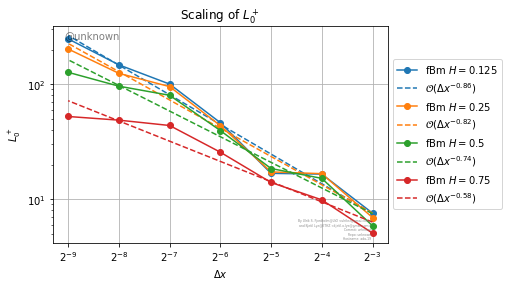

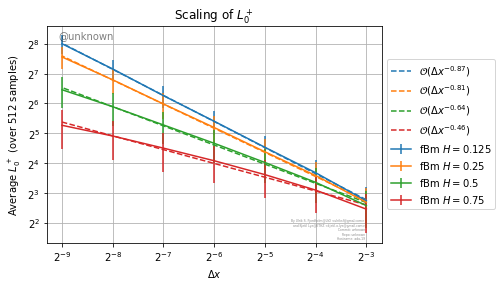

In [12]:
def run_lipschitz_resolution(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

    
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        plot_lipschitz_resolution(base_xml, name, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
    plt.figure(0)
    plot_info.legendLeft()
    plt.grid(True)
    plt.title("Scaling of $L^+_0$")
    plot_info.savePlot("fbm_lipschitz_scaling")
    
    plt.figure(1)
    plot_info.legendLeft()
    plt.grid(True)
    plt.title("Scaling of $L^+_0$")
    plot_info.savePlot("fbm_lipschitz_scaling_avg")
    plt.show()

run_lipschitz_resolution("burgers", "godunov", None, 0.1)

# TV scaling resolution

In [13]:
def plot_tv_resolution(base_xml, title,  
                exact_solution_class=None,
                numerical_flux="rusanov",
                equation="burgers"):
    plot_info.console_log_show("Running plot TV over resolution for {},  flux={}, equation={}".format(base_xml,
                                                                                                numerical_flux,
                                                                                                equation))
    
    resolutions = 2**np.arange(START_CAUCHY_DET_T0_LOG, END_CAUCHY_DET_T0_LOG)
    delta_xs = 1.0 / resolutions
    TVs = []
    for r in resolutions:
        run = alsvinn.run(name="tv_resolution",
            base_xml=base_xml,
            number_of_saves=1,
            dimension=[r,1,1],
            flux=numerical_flux,
            equation=equation,
            uq=True, # notice that since we have Brownian initial data, we need to enable uq
            T=0.0000001)
        
        u0 = run.get_data('u', 0)
        TV = np.sum(abs(np.diff(u0)))
        TVs.append(TV)

    
    poly = np.polyfit(np.log(delta_xs), np.log(TVs), 1)
    
    line_information = plt.loglog(delta_xs, TVs, '-o', label=title)
    plt.loglog(delta_xs, np.exp(poly[1])*delta_xs**poly[0], '--', 
               color=line_information[0].get_color(),
              label='$\\mathcal{O}(\\Delta x^{%.2f})$' % poly[0], 
              basex=2)
    
    plt.xlabel('$\\Delta x$')
    plt.ylabel('$\\mathrm{TV}(u_0^{\\Delta x})$')
    plot_info.console_log_show("Done configuration {} {} {}".format(base_xml, equation, numerical_flux))

2019-04-09 21:20:40.728690 (in plot_tv_resolution): Running plot TV over resolution for ../configs/fractional_brownian_0_125/fractional_brownian.xml,  flux=godunov, equation=burgers
2019-04-09 21:20:51.065573 (in plot_tv_resolution): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov
2019-04-09 21:20:51.079466 (in plot_tv_resolution): Running plot TV over resolution for ../configs/fractional_brownian_0_25/fractional_brownian.xml,  flux=godunov, equation=burgers
2019-04-09 21:21:02.876078 (in plot_tv_resolution): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov
2019-04-09 21:21:02.892740 (in plot_tv_resolution): Running plot TV over resolution for ../configs/fractional_brownian_0_5/fractional_brownian.xml,  flux=godunov, equation=burgers
2019-04-09 21:21:13.490147 (in plot_tv_resolution): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov
2019-04-09 21:21

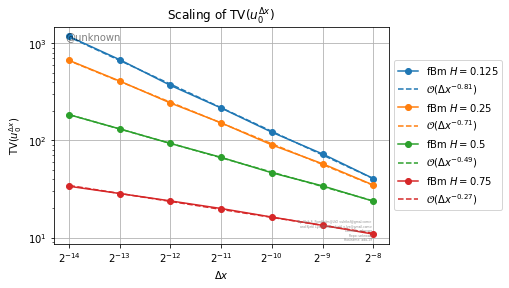

In [14]:
def run_tv_resolution(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

    
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        plot_tv_resolution(base_xml, name, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
    plot_info.legendLeft()
    plt.title("Scaling of $\\mathrm{TV}(u_0^{\\Delta x})$")
    plt.grid(True)
    plot_info.savePlot("fbm_tv_scaling")
    
    plt.show()

run_tv_resolution("burgers", "godunov", None, 0.1)

# Lipschitz over time

In [15]:
def lipschitz_versus_time(base_xml, title, T, 
                    exact_solution_class=None,
                    numerical_flux="rusanov",
                    equation="burgers"):
    
    plot_info.console_log_show("Running lipschitz over time for {}, T={}, flux={}, equation={}".format(base_xml,
                                                                                                 T,
                                                                                                numerical_flux,
                                                                                                equation))
    N = 128
    M = CONVERGENCE_UQ_HIGHEST_RESOLUTION
    M_samples = NUMBER_OF_SAMPLES
    
    run = alsvinn.run(name="Lipschitz_solution",
        base_xml=base_xml,
        number_of_saves=N,
        dimension=[M,1,1],
        flux=numerical_flux,
        equation=equation,
        samples=M_samples,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    lipschitzs = []
    lipschitzs_avg = []
    Ts = np.linspace(0,T,N)
    for t_index in range(N):
        u = run.get_data("u", t_index)
        
        lipschitz = max((np.diff(u)>0)*np.diff(u))*M
        lipschitzs.append(lipschitz)
        
        avg = 0
        for k in range(M_samples):
            u = run.get_data("u", t_index, sample=k)
        
            lipschitz = max((np.diff(u)>0)*np.diff(u))*M
            avg += lipschitz
        avg /= M_samples
        lipschitzs_avg.append(avg)
        
    lipschitzs_avg = np.array(lipschitzs_avg)
    lipschitzs = np.array(lipschitzs)
    
    plt.figure(0)
    poly = np.polyfit(Ts[1:], 1.0/lipschitzs[1:], 1)
    
    print(poly)
    
    line_info = plt.plot(Ts, 1.0/lipschitzs, label=title)
    
    plt.plot(Ts[1:], poly[0]*Ts[1:]+poly[1],
             '--',
             color=line_info[0].get_color(),
             label='$%.3f t %+.3f$' % (poly[0], poly[1]))
    plt.title("T = {}".format(T))
    plot_info.legendLeft()
    plt.xlabel("$t^n$")
    plt.ylabel("$L^+_n$")
    
    
    plt.figure(1)
    poly = np.polyfit(Ts[1:], 1.0/lipschitzs_avg[1:], 1)
    
    print(poly)
    
    line_info = plt.plot(Ts, 1.0/lipschitzs_avg, label=title)
    
    plt.plot(Ts[1:], poly[0]*Ts[1:]+poly[1],
             '--',
             color=line_info[0].get_color(),
             label='$%.3f t %+.3f$' % (poly[0], poly[1]))
    plt.title("T = {}".format(T))
    plot_info.legendLeft()
    plt.xlabel("$t^n$")
    plt.ylabel("$L^+_n$ (averaged over %d samples)" % M_samples)
    plot_info.console_log_show("Done configuration {} {} {} {}".format(base_xml, equation, numerical_flux, T))


2019-04-09 21:21:28.763942 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=rusanov, equation=burgers
[0.76638486 0.04094332]
[0.59873119 0.05277517]
2019-04-09 21:36:23.600728 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.5
2019-04-09 21:36:23.622049 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=rusanov, equation=burgers
[0.74926295 0.06044916]
[0.61651704 0.0581847 ]
2019-04-09 21:51:30.348545 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.5
2019-04-09 21:51:30.379488 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=rusanov, equation=burgers
[0.66456428 0.06539021]
[0.65309583 0

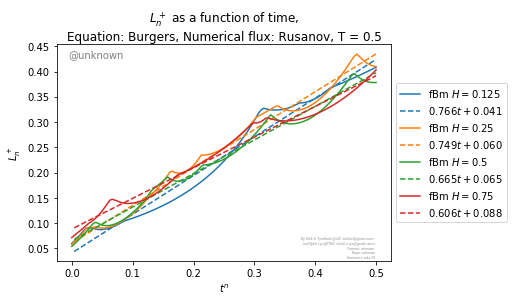

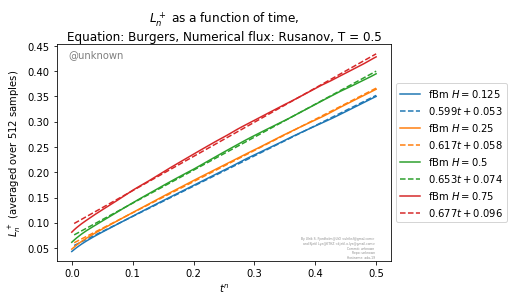

2019-04-09 22:21:37.895882 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=godunov, equation=burgers
[0.57016149 0.03145869]
[0.43557335 0.03580717]
2019-04-09 22:36:34.174426 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.5
2019-04-09 22:36:34.194253 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=godunov, equation=burgers
[0.26261156 0.07603245]
[0.46963085 0.04118287]
2019-04-09 22:51:24.992229 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.5
2019-04-09 22:51:25.010657 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=godunov, equation=burgers
[0.23864578 0.07354882]
[0.53772007 0

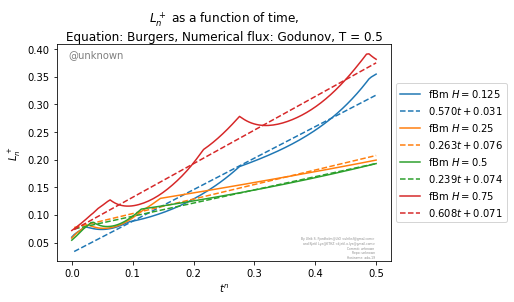

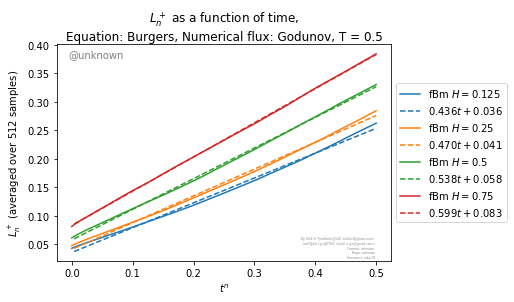

2019-04-09 23:31:26.269412 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=roe, equation=burgers
[0.57016149 0.03145869]
[0.43557335 0.03580717]
2019-04-09 23:46:21.952139 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.5
2019-04-09 23:46:21.971974 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=roe, equation=burgers
[0.26261156 0.07603245]
[0.46963085 0.04118287]
2019-04-10 00:01:31.085179 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.5
2019-04-10 00:01:31.106494 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=roe, equation=burgers
[0.23864578 0.07354882]
[0.53772007 0.05775605]
2019-04-1

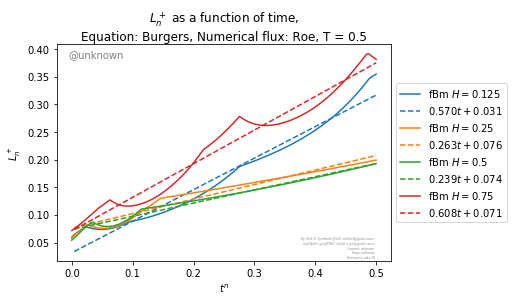

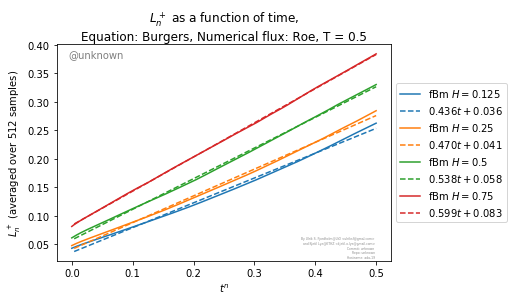

2019-04-10 00:31:12.875090 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=rusanov, equation=cubic
[0.04359617 0.07875932]
[0.06180794 0.06257818]
2019-04-10 00:52:47.753154 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.5
2019-04-10 00:52:47.774779 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=rusanov, equation=cubic
[0.01587126 0.0812167 ]
[0.05444146 0.0672311 ]
2019-04-10 01:07:38.273352 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.5
2019-04-10 01:07:38.296673 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=rusanov, equation=cubic
[-0.00714105  0.07866567]
[0.03158917 0.0795222

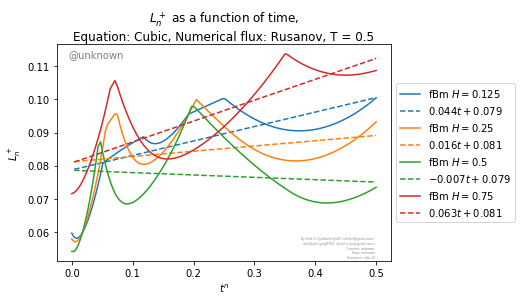

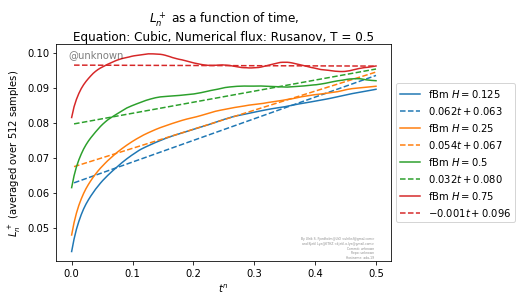

2019-04-10 01:37:51.381552 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=roe, equation=cubic
[0.03749363 0.06205898]
[0.04389795 0.05122096]
2019-04-10 01:52:48.059463 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.5
2019-04-10 01:52:48.081891 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=roe, equation=cubic
[0.02071942 0.06277823]
[0.0395533  0.05630326]
2019-04-10 02:07:53.269218 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.5
2019-04-10 02:07:53.302063 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=roe, equation=cubic
[-0.00564836  0.0624491 ]
[0.01857114 0.07082677]
2019-04-10 02:22:

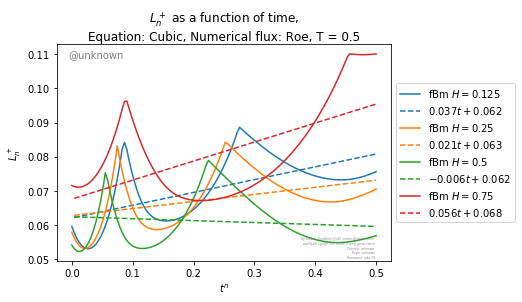

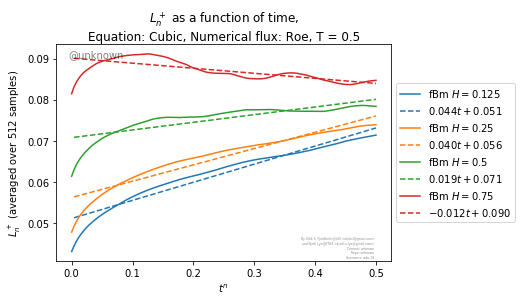

2019-04-10 02:38:01.632956 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=rusanov, equation=linear
[0.69630475 0.11194391]
[0.26976241 0.08785989]
2019-04-10 02:53:06.819064 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.5
2019-04-10 02:53:06.840800 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=rusanov, equation=linear
[0.54740275 0.10841773]
[0.24595138 0.09182999]
2019-04-10 03:08:16.272487 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.5
2019-04-10 03:08:16.297899 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=rusanov, equation=linear
[0.31657043 0.09388625]
[0.20435848 0.1025

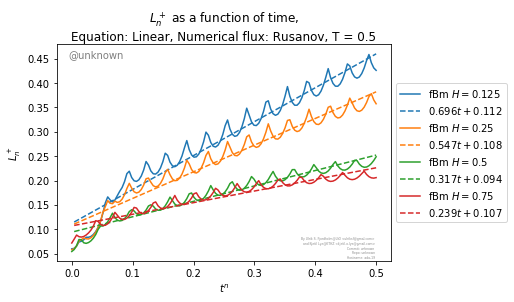

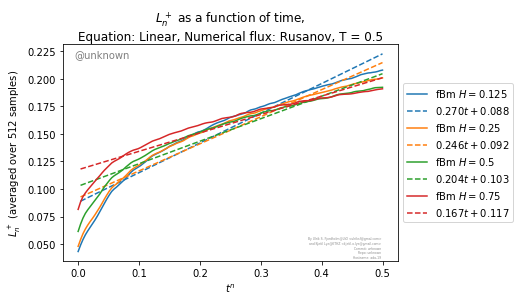

2019-04-10 03:38:22.793703 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=upwind, equation=linear
[0.69630475 0.11194391]
[0.26976241 0.08785989]
2019-04-10 03:53:10.700886 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.5
2019-04-10 03:53:10.722719 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=upwind, equation=linear
[0.54740275 0.10841773]
[0.24595138 0.09182999]
2019-04-10 04:07:59.679961 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.5
2019-04-10 04:07:59.702174 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=upwind, equation=linear
[0.31657043 0.09388625]
[0.20435848 0.10251782]

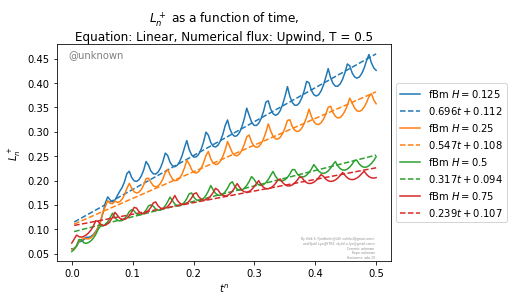

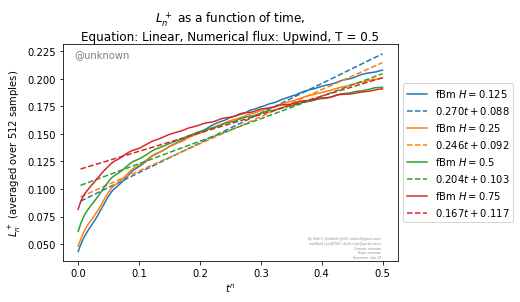

In [16]:
def run_fbm_lipschitz_time(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

   
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        lipschitz_versus_time(base_xml, name, T, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
    plt.figure(0)
    plt.title("$L^+_n$ as a function of time,\nEquation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_lipschitz_time_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    plt.figure(1)
    plt.title("$L^+_n$ as a function of time,\nEquation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_lipschitz_time_avg_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    plt.show()
    
T = 0.5
run_all_configurations(run_fbm_lipschitz_time, T)
                                          

# Single solution compare

In [17]:
def plot_solution_at_two_resolutions(base_xml, title, T, M1, M2, 
                exact_solution_class=None,
                numerical_flux="rusanov",
                equation="burgers"):
    
    
    
    plot_info.console_log_show("Running plot_solution_at_two_resolutions for {}, T={}, flux={}, equation={}".format(base_xml,
                                                                                                 T,
                                                                                                numerical_flux,
                                                                                                equation))
    run_m1 = alsvinn.run(name="M1solution",
        base_xml=base_xml,
        number_of_saves=1,
        dimension=[M1,1,1],
        flux=numerical_flux,
        equation=equation,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    
    run_m2 = alsvinn.run(name="M2solution",
        base_xml=base_xml,
        number_of_saves=1,
        dimension=[M2,1,1],
        flux=numerical_flux,
        equation=equation,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    t_indices = [0, 1]
    ts = [0, T]
    for t_index in t_indices:
        t = ts[t_index]
        u1 = run_m1.get_data("u", t_index)
        x1 = np.linspace(0, 1, u1.shape[0])
        
        u2 = run_m2.get_data("u", t_index)
        x2 = np.linspace(0, 1, u2.shape[0])
        
        plt.figure(t_index)
        plt.plot(x1, u1, label='$\\Delta x = 2^{-%d}$' % int(np.log2(M1)))
        plt.plot(x2, u2, label='$\\Delta x = 2^{-%d}$' % int(np.log2(M2)))
        plt.xlabel("$x$")
        plt.ylabel("$u(x,{})$".format(t))
        
    plot_info.console_log_show("Done configuration {} {} {} {}".format(base_xml, equation, numerical_flux, T))

2019-04-10 04:37:46.538029 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-10 04:37:56.308193 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.00390625


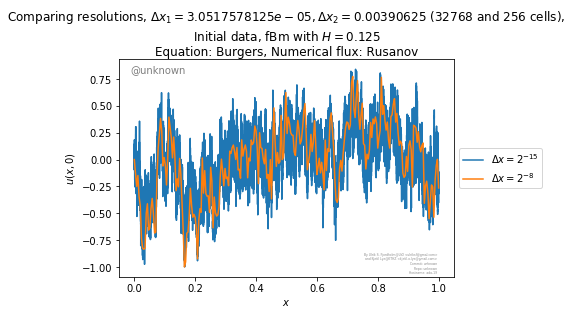

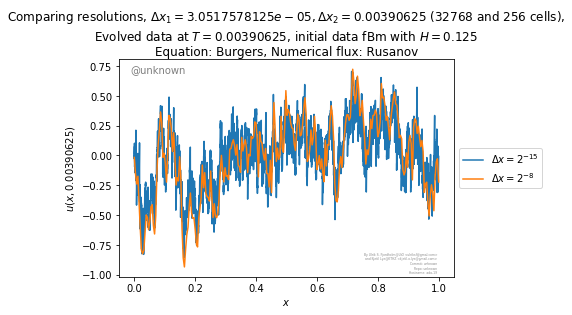

2019-04-10 04:38:03.069067 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-10 04:38:09.031388 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.00390625


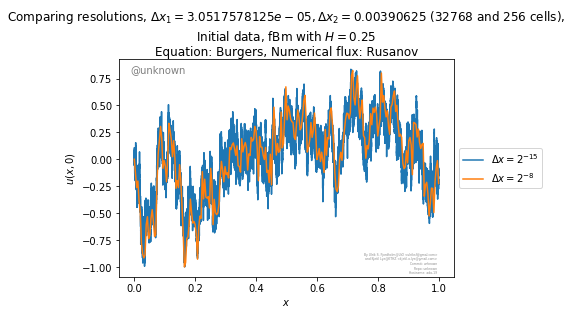

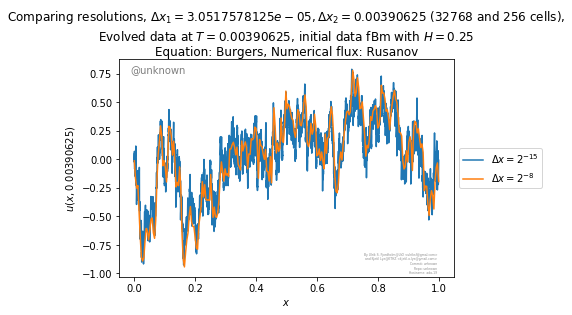

2019-04-10 04:38:15.470706 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-10 04:38:21.474806 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 0.00390625


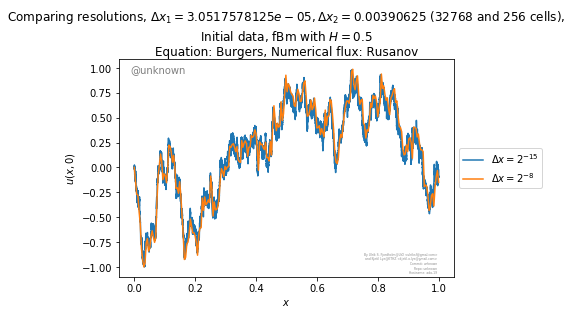

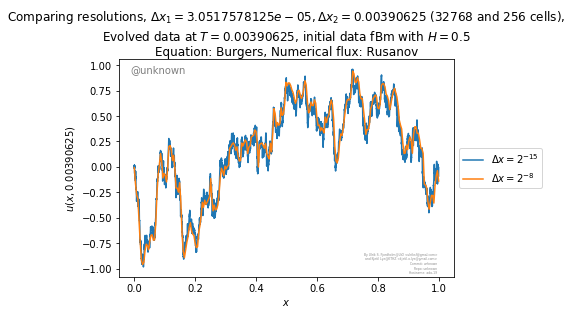

2019-04-10 04:38:27.450988 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-10 04:38:33.523398 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 0.00390625


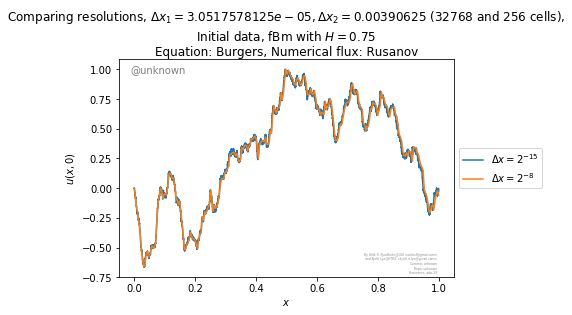

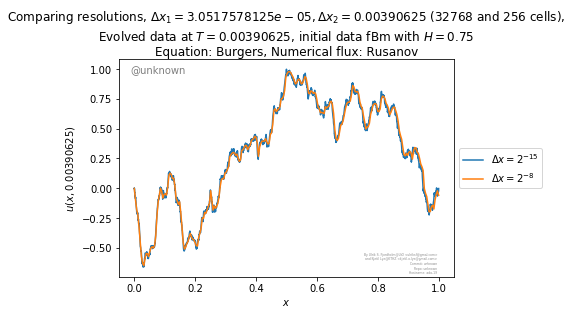

2019-04-10 04:38:39.019689 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-10 04:38:45.105574 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.00390625


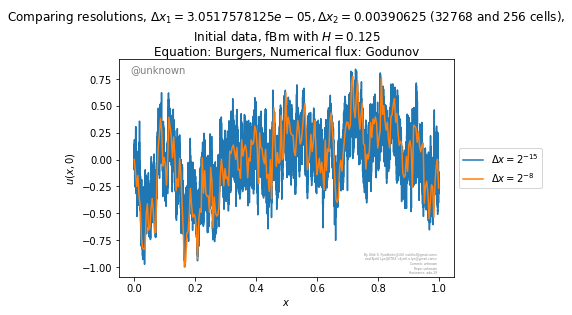

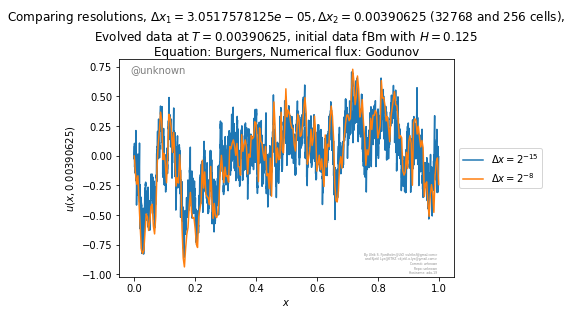

2019-04-10 04:38:51.769736 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-10 04:38:58.305228 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.00390625


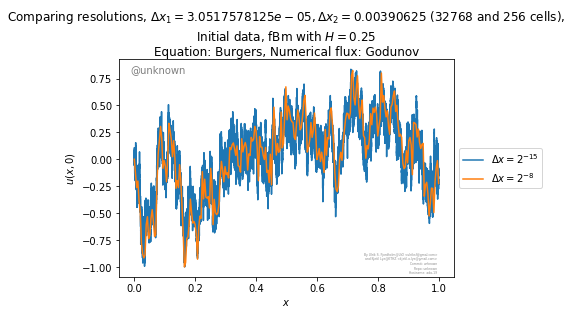

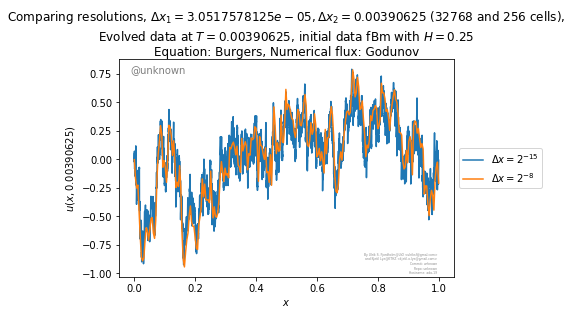

2019-04-10 04:39:04.453340 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-10 04:39:11.082661 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 0.00390625


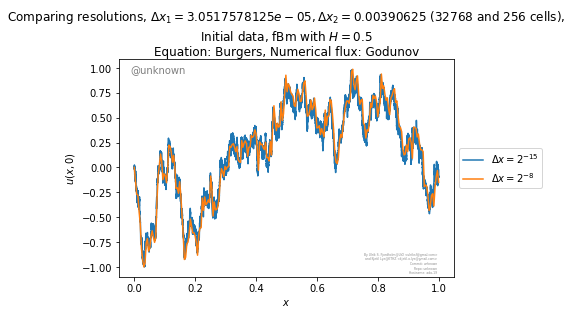

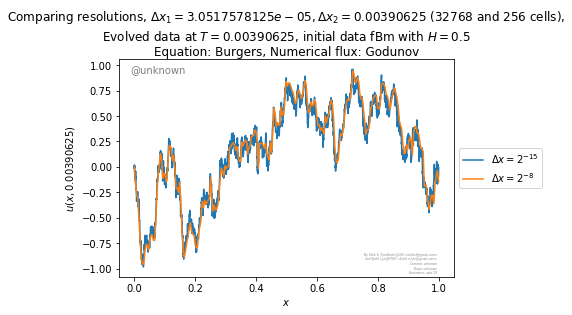

2019-04-10 04:39:16.791665 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-10 04:39:23.423059 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 0.00390625


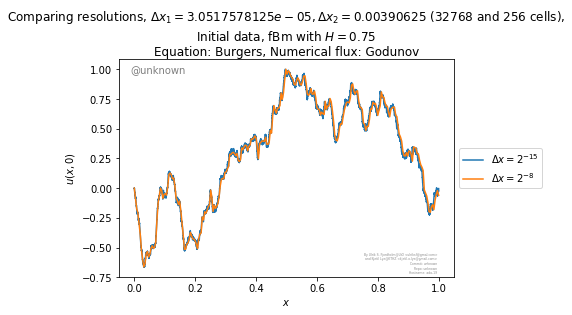

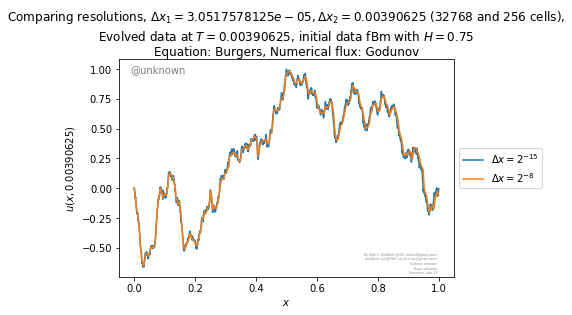

2019-04-10 04:39:29.055100 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-10 04:39:34.818504 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.00390625


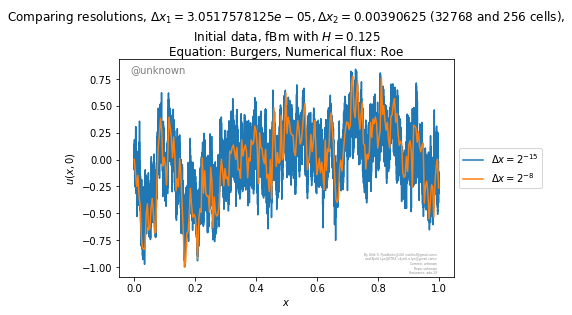

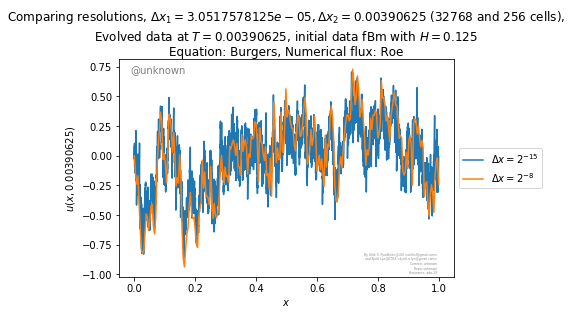

2019-04-10 04:39:41.502655 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-10 04:39:47.561993 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.00390625


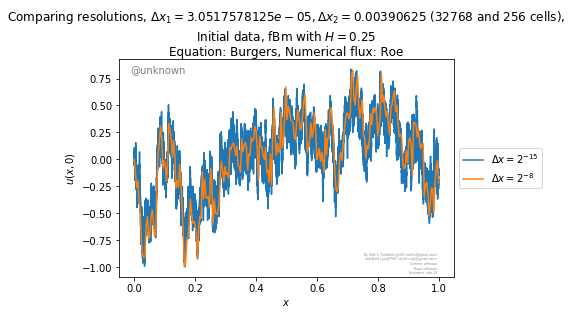

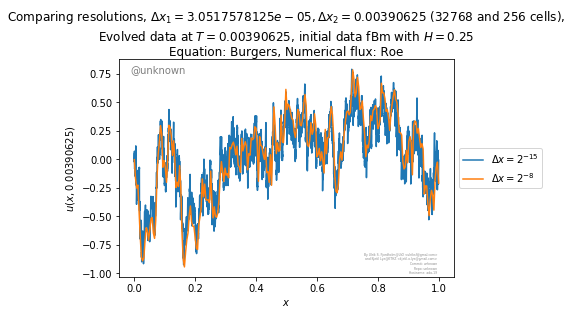

2019-04-10 04:39:53.761447 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-10 04:40:00.105421 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 0.00390625


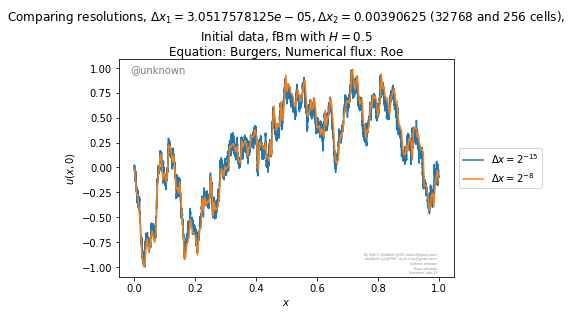

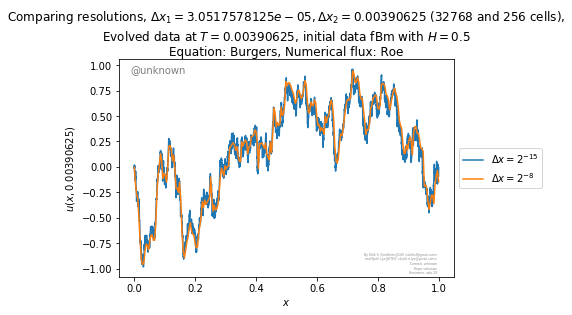

2019-04-10 04:40:05.837145 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-10 04:40:12.253607 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 0.00390625


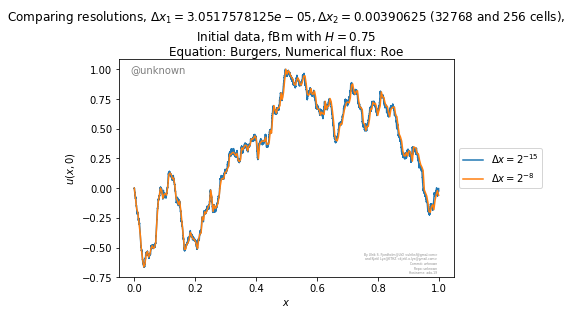

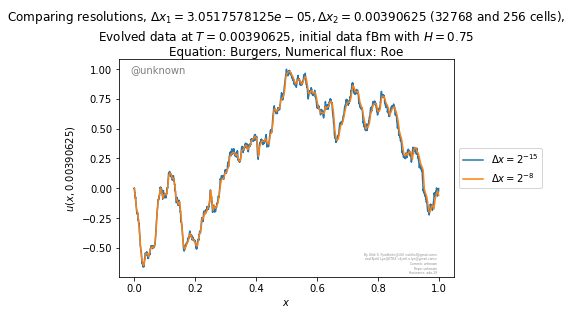

2019-04-10 04:40:17.800881 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-10 04:40:23.236120 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.00390625


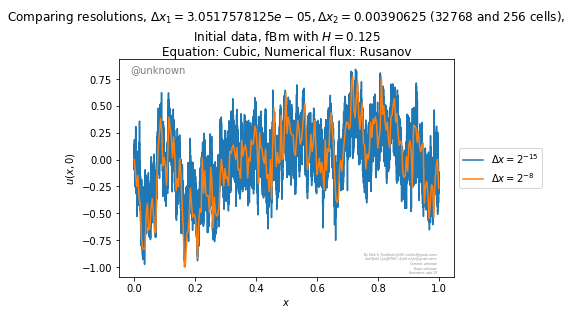

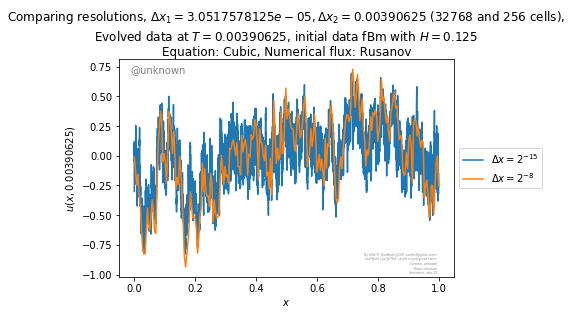

2019-04-10 04:40:29.945527 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-10 04:40:35.825670 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.00390625


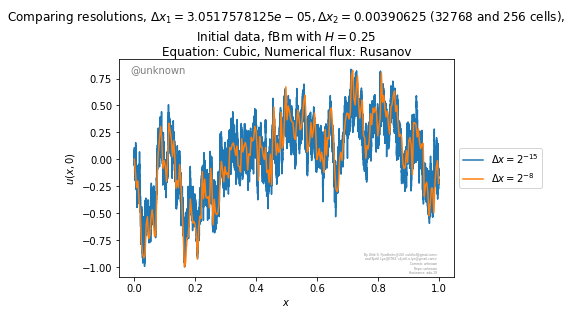

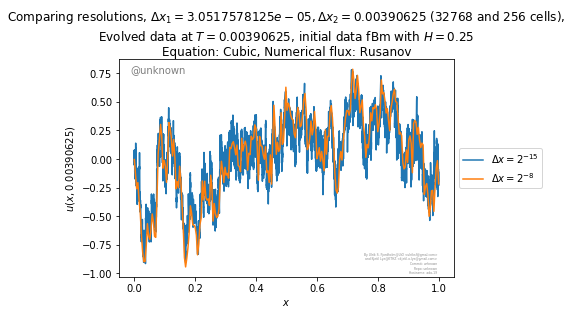

2019-04-10 04:40:42.033107 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-10 04:40:48.291222 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 0.00390625


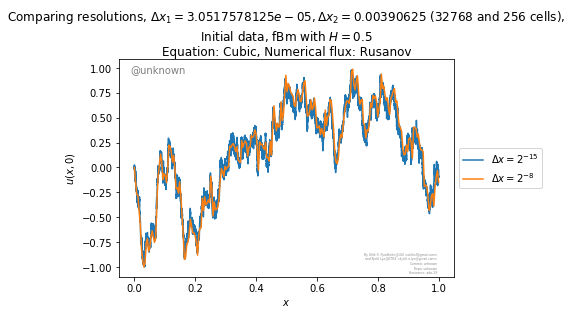

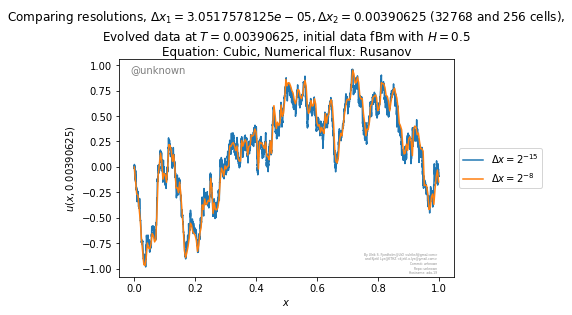

2019-04-10 04:40:54.071533 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-10 04:41:05.125810 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 0.00390625


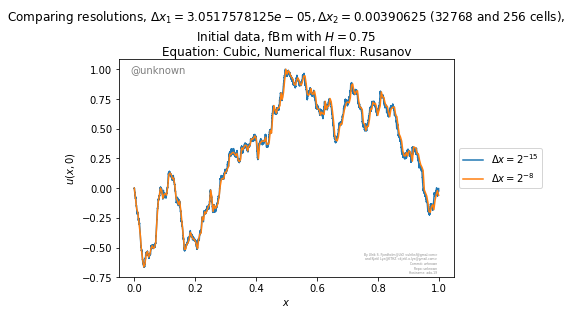

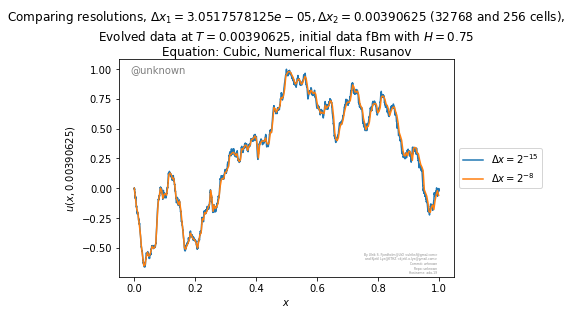

2019-04-10 04:41:10.653170 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-10 04:41:16.141032 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.00390625


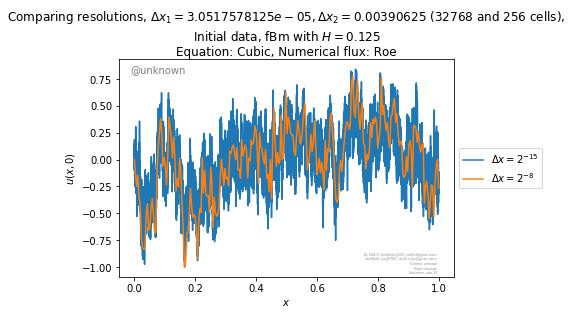

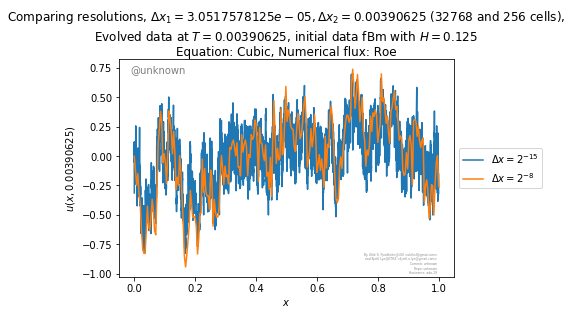

2019-04-10 04:41:23.569407 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-10 04:41:29.738412 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.00390625


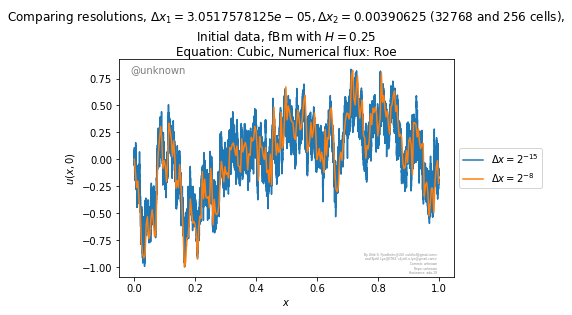

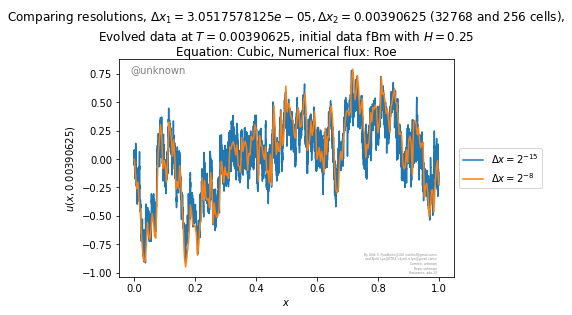

2019-04-10 04:41:36.220167 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-10 04:41:42.748978 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 0.00390625


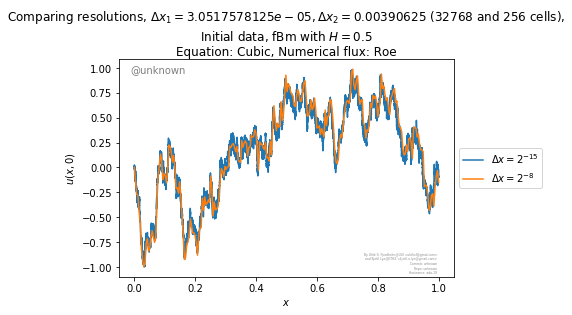

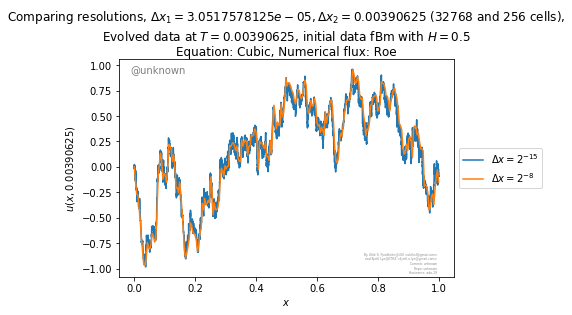

2019-04-10 04:41:48.660694 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-10 04:41:59.181681 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 0.00390625


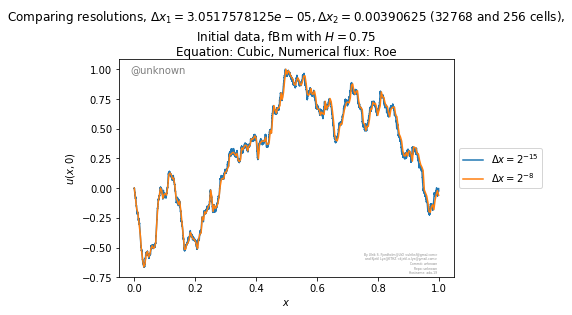

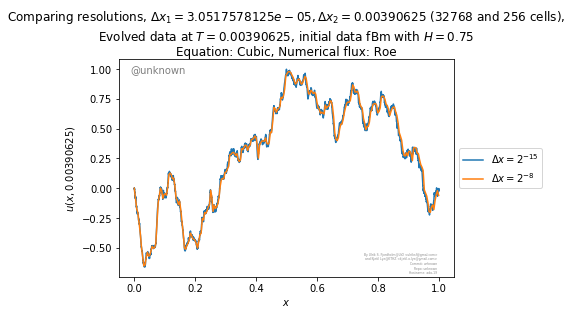

2019-04-10 04:42:04.766352 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-10 04:42:10.454949 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.00390625


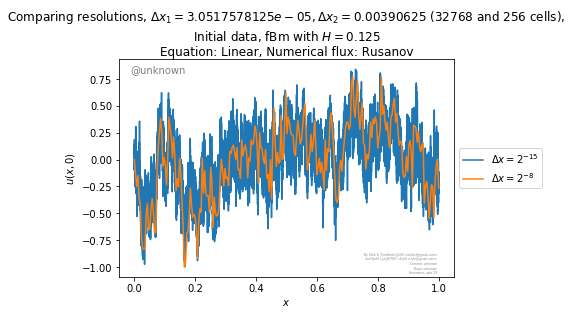

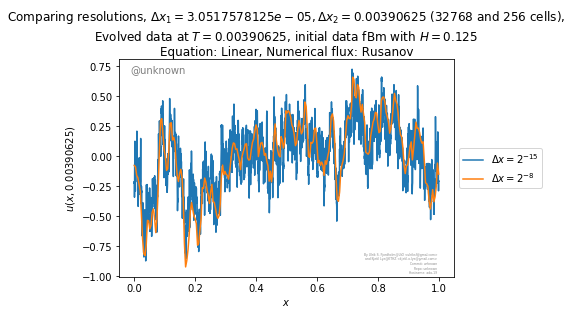

2019-04-10 04:42:17.078194 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-10 04:42:22.776927 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.00390625


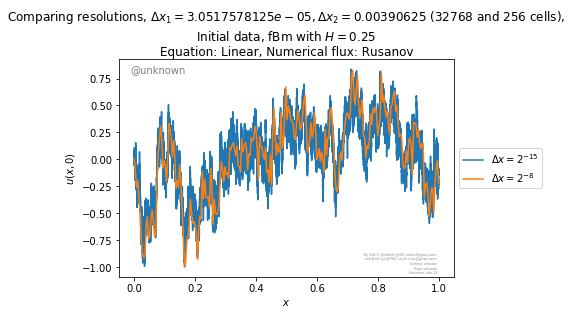

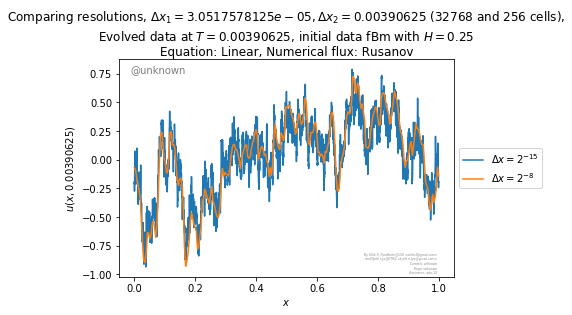

2019-04-10 04:42:28.858787 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-10 04:42:34.416125 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 0.00390625


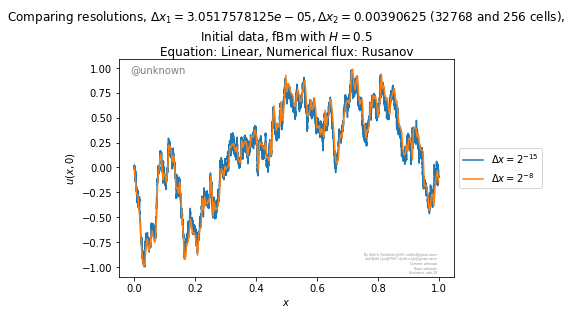

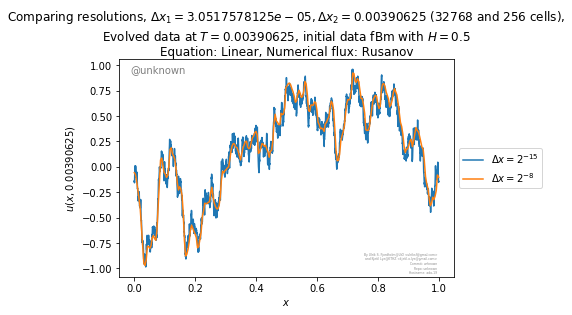

2019-04-10 04:42:40.087491 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-10 04:42:45.686158 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 0.00390625


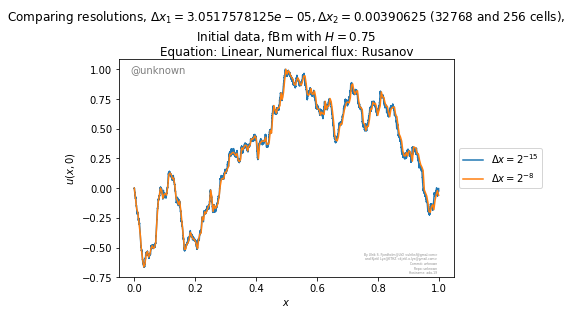

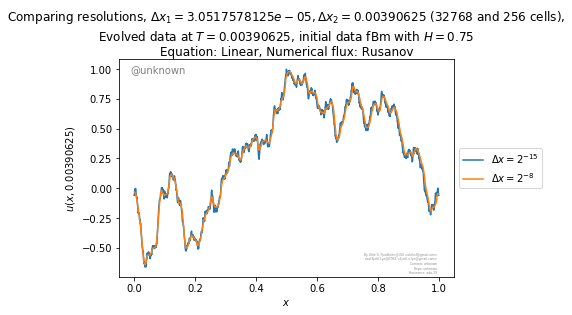

2019-04-10 04:42:51.245182 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-10 04:42:56.752970 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.00390625


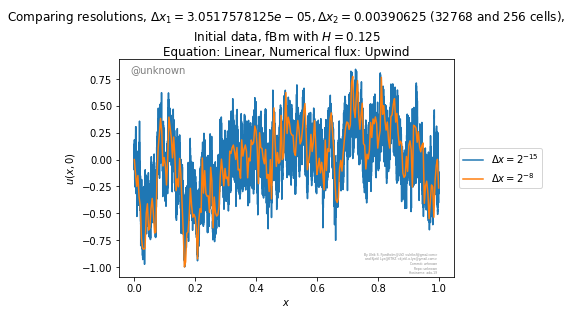

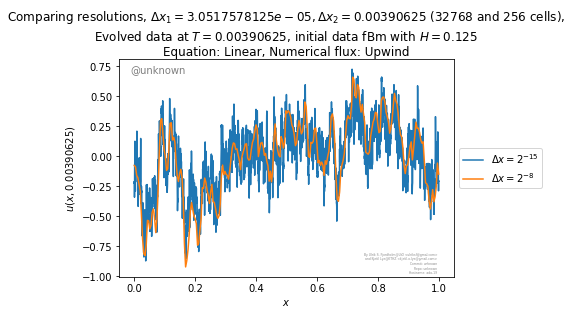

2019-04-10 04:43:03.571052 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-10 04:43:09.148119 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.00390625


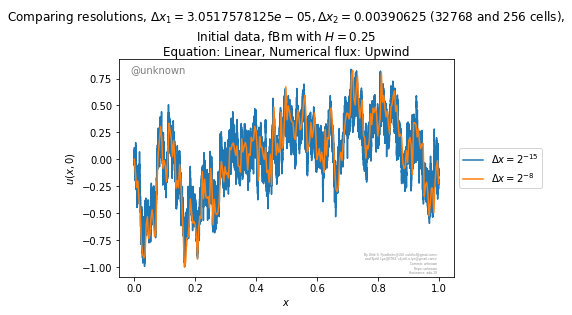

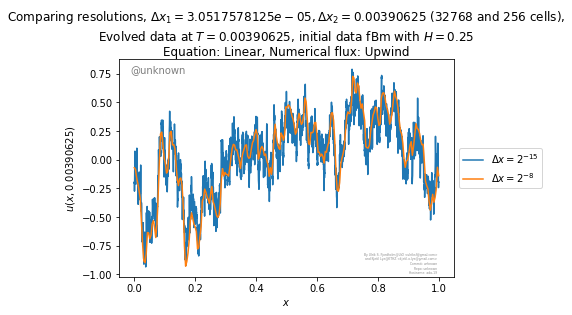

2019-04-10 04:43:15.207115 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-10 04:43:20.862199 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 0.00390625


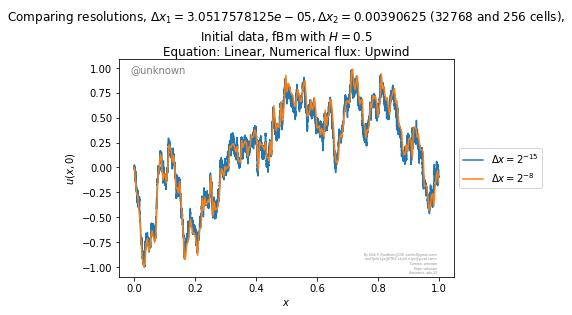

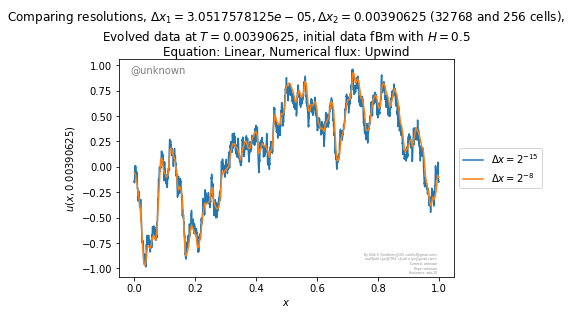

2019-04-10 04:43:26.578016 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-10 04:43:32.056133 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 0.00390625


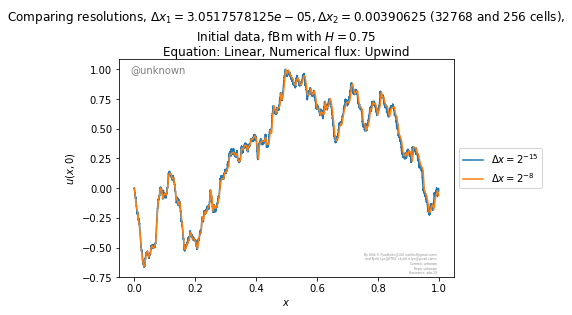

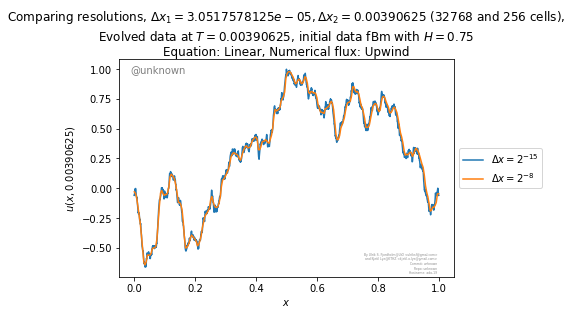

2019-04-10 04:43:37.591953 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-10 04:50:22.818324 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 1


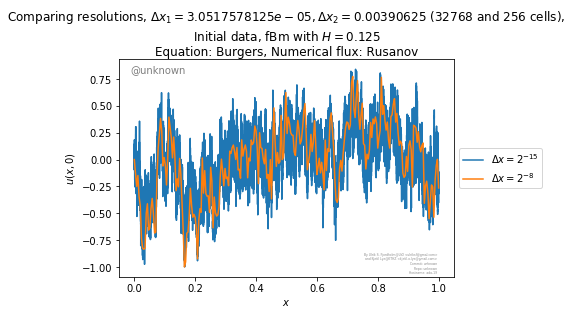

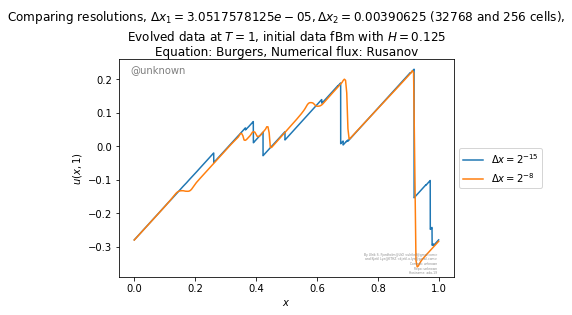

2019-04-10 04:50:29.186218 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-10 04:59:10.068973 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 1


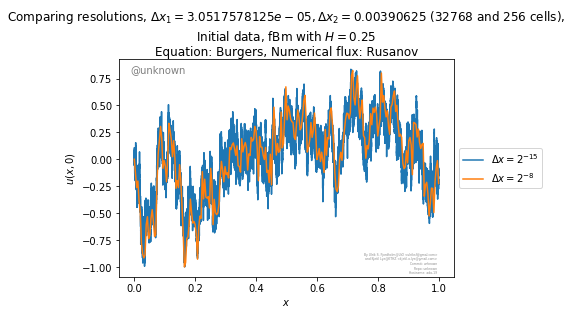

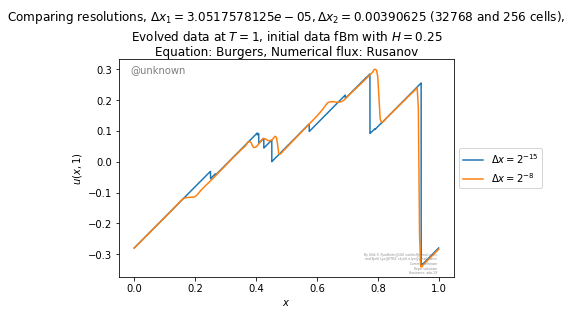

2019-04-10 04:59:15.825433 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-10 05:11:06.110371 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 1


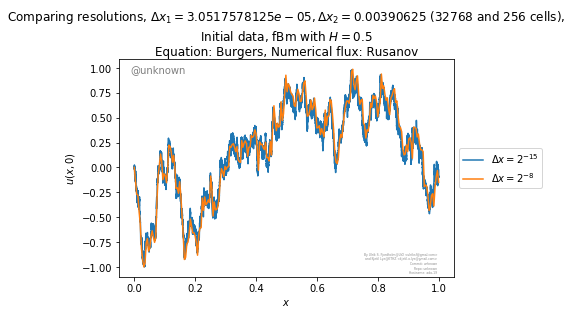

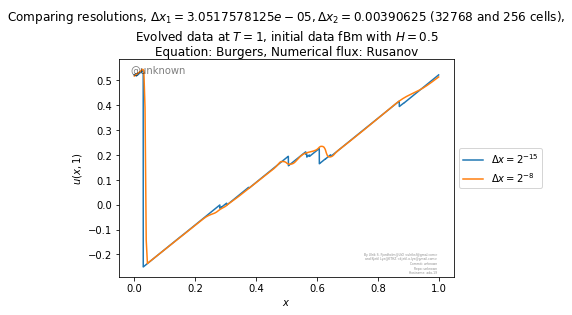

2019-04-10 05:11:11.722588 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-10 05:24:23.317450 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 1


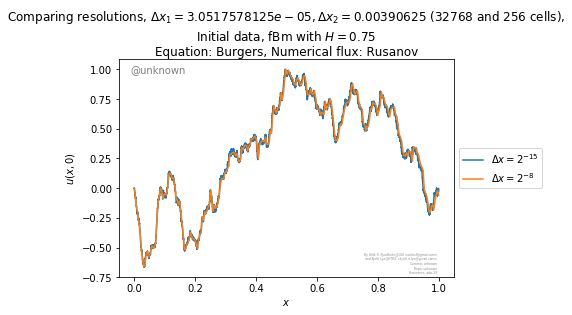

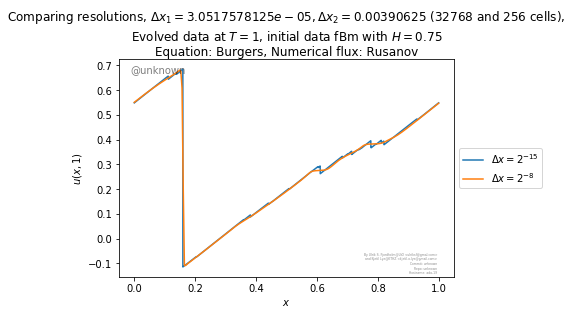

2019-04-10 05:24:28.804639 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-10 05:32:16.508072 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 1


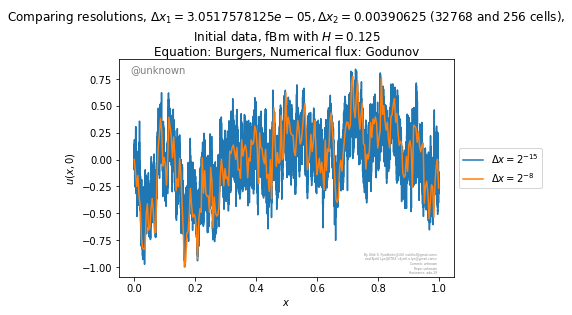

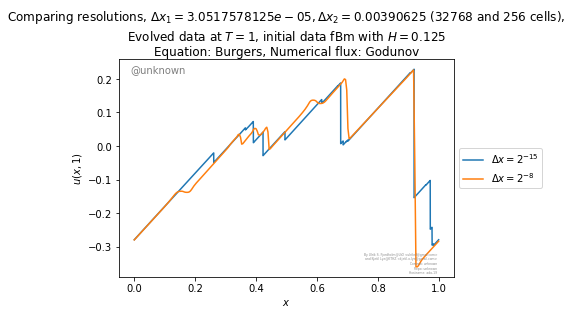

2019-04-10 05:32:22.855101 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-10 05:42:31.338831 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 1


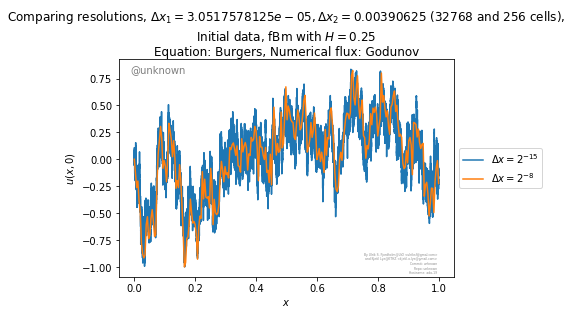

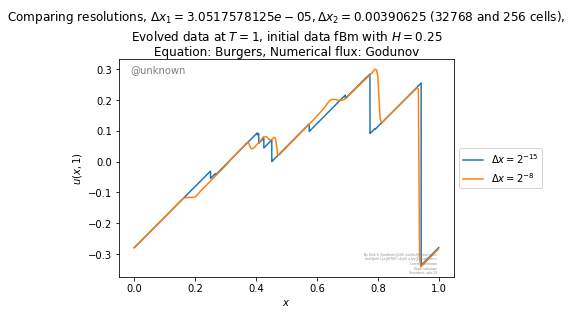

2019-04-10 05:42:37.092505 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-10 05:56:47.377855 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 1


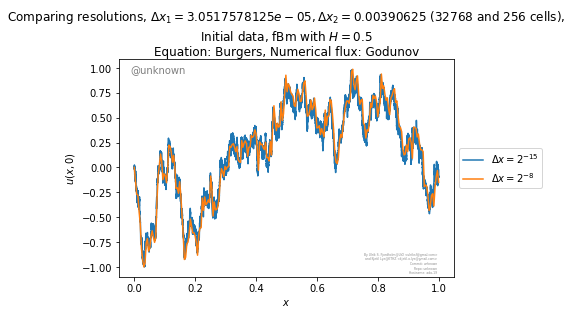

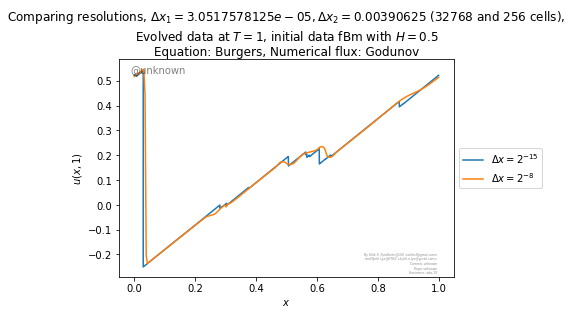

2019-04-10 05:56:52.950734 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-10 06:12:30.188519 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 1


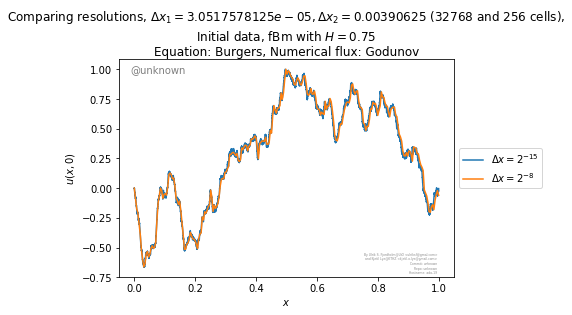

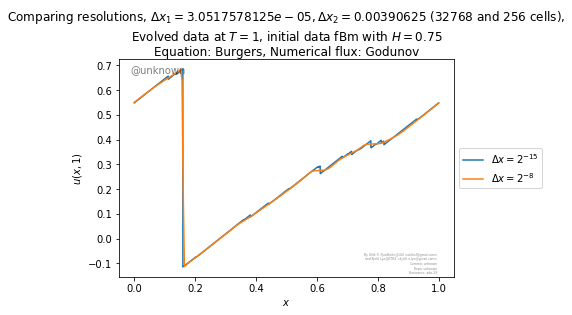

2019-04-10 06:12:35.741086 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-10 06:19:27.500949 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 1


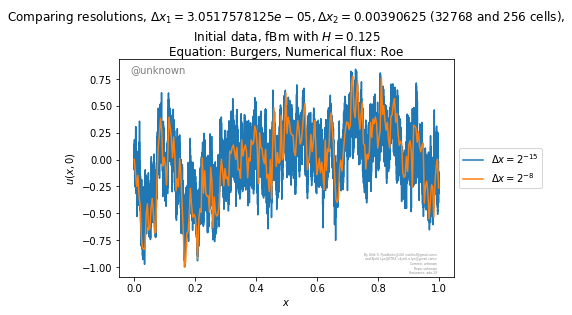

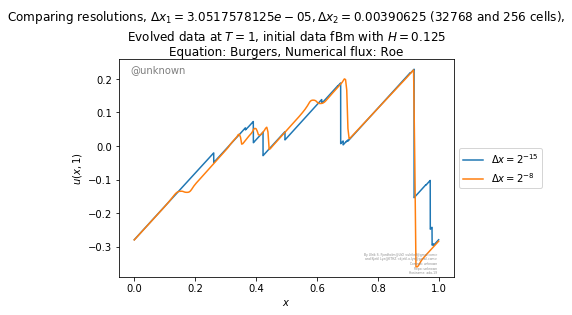

2019-04-10 06:19:33.813843 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-10 06:28:40.238724 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 1


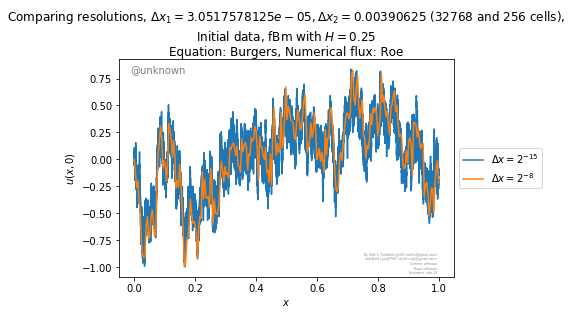

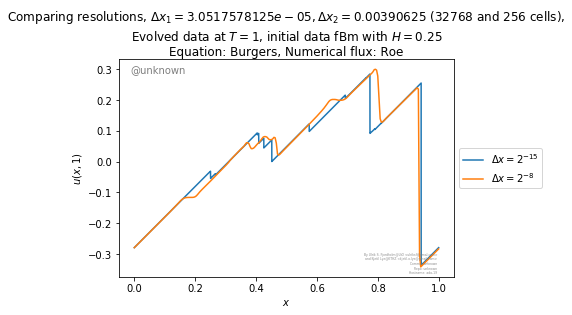

2019-04-10 06:28:46.159112 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-10 06:41:12.034525 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 1


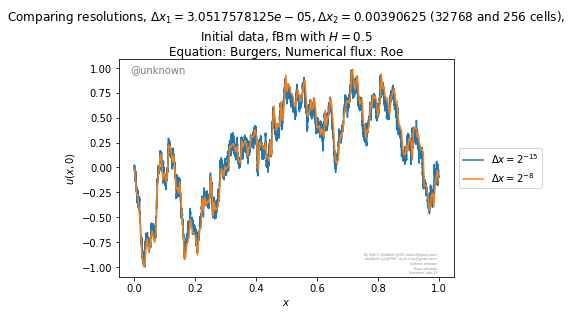

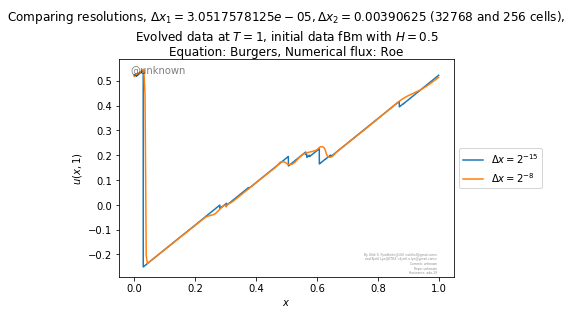

2019-04-10 06:41:17.589017 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-10 06:55:09.375431 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 1


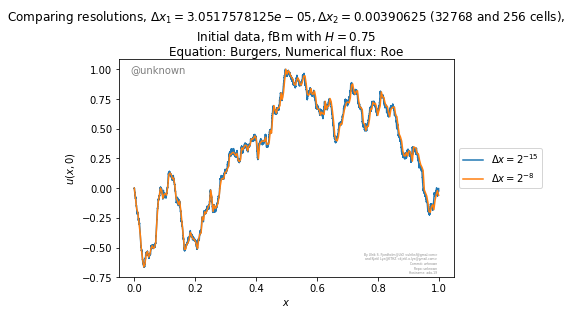

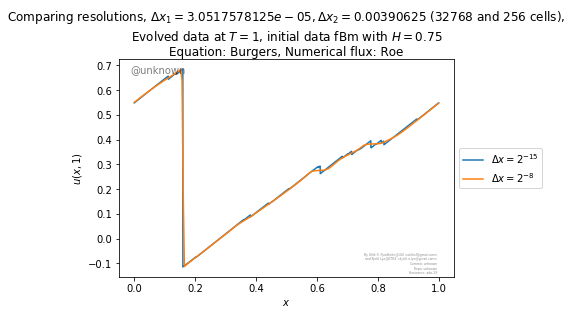

2019-04-10 06:55:14.967528 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-10 06:59:20.533817 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 1


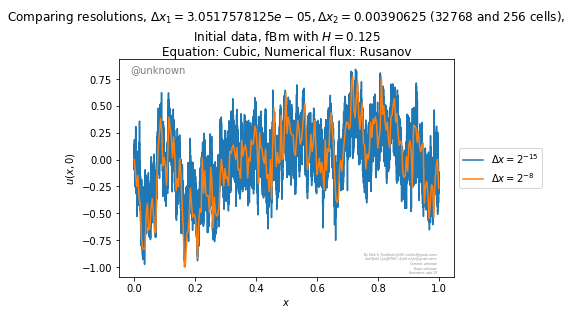

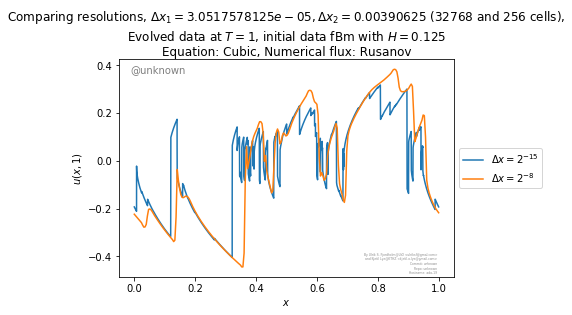

2019-04-10 06:59:26.872602 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-10 07:05:55.618932 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 1


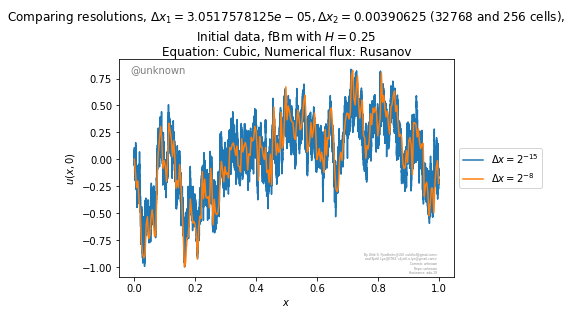

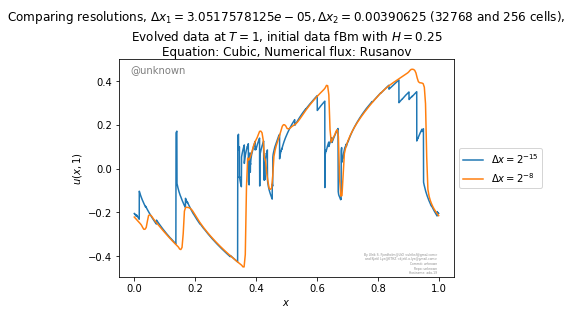

2019-04-10 07:06:01.962631 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-10 07:16:05.949000 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 1


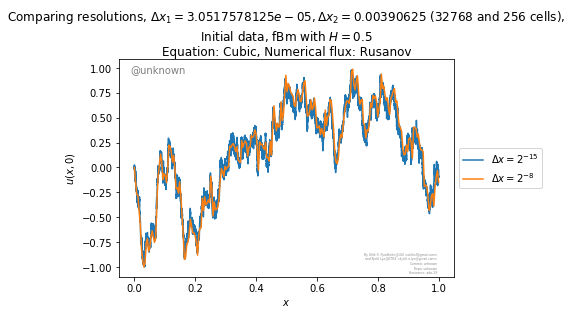

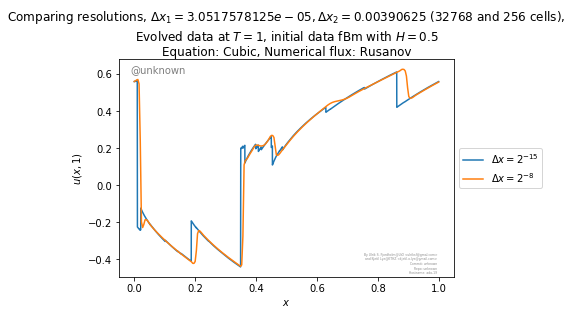

2019-04-10 07:16:11.449546 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-10 07:28:41.958702 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 1


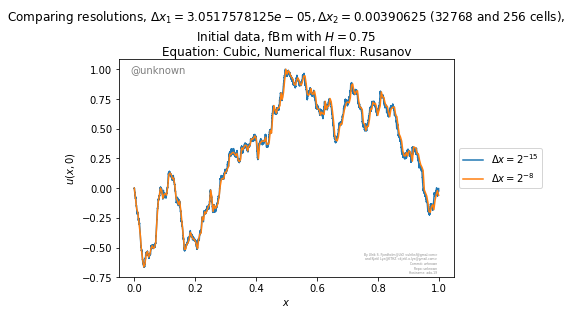

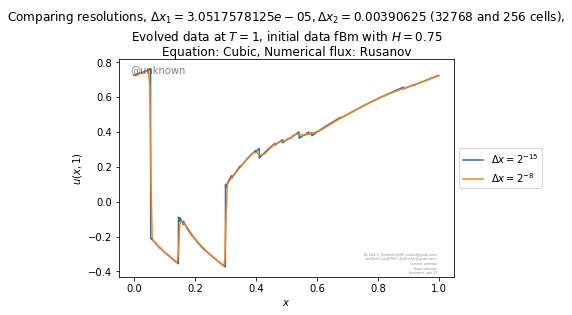

2019-04-10 07:28:47.254741 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-10 07:33:12.447582 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 1


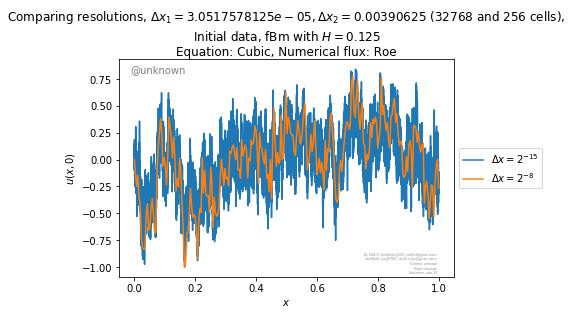

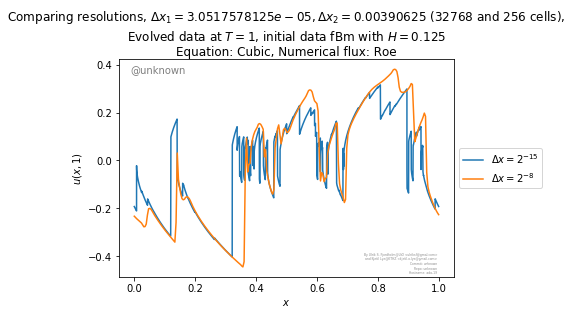

2019-04-10 07:33:18.904265 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-10 07:40:06.327254 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 1


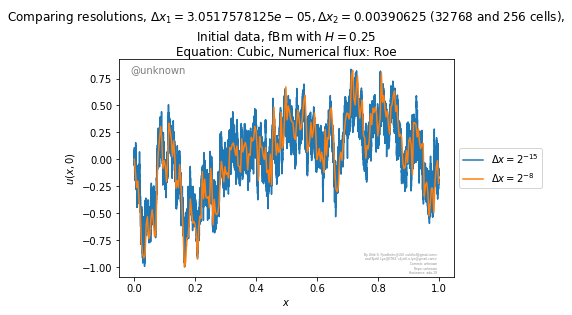

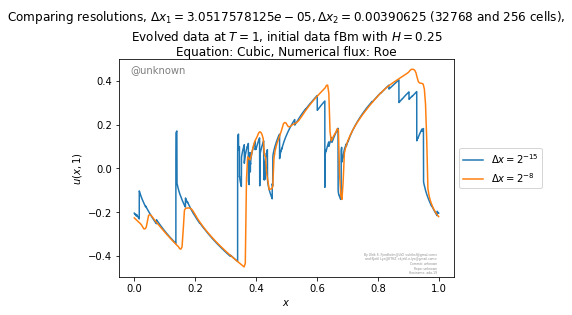

2019-04-10 07:40:12.183548 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-10 07:51:12.151029 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 1


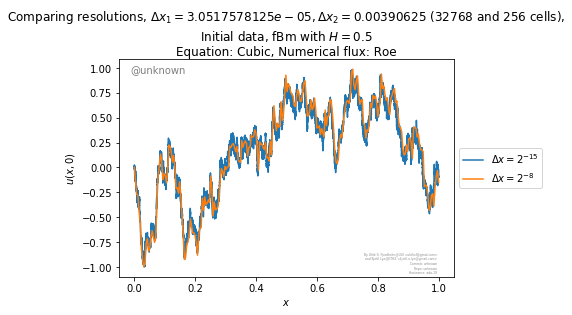

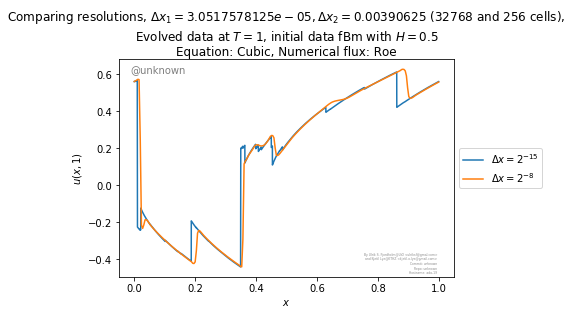

2019-04-10 07:51:17.625161 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-10 08:04:30.784071 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 1


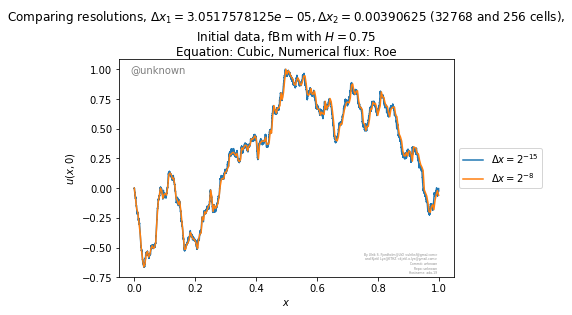

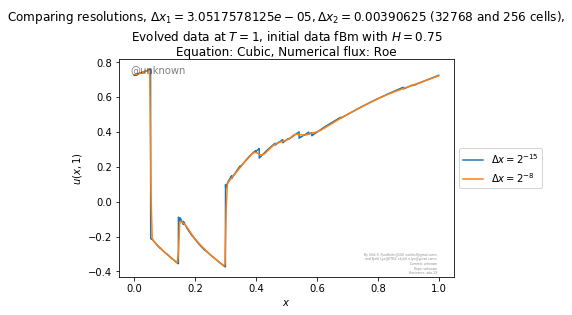

2019-04-10 08:04:36.165090 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-10 08:17:14.924250 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 1


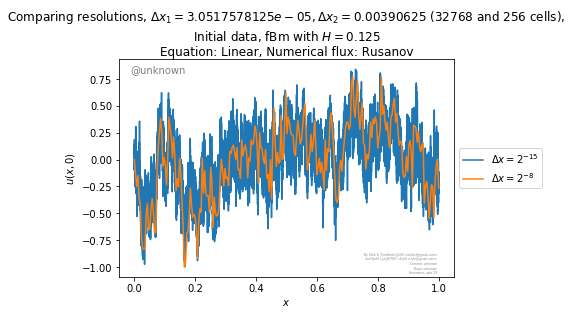

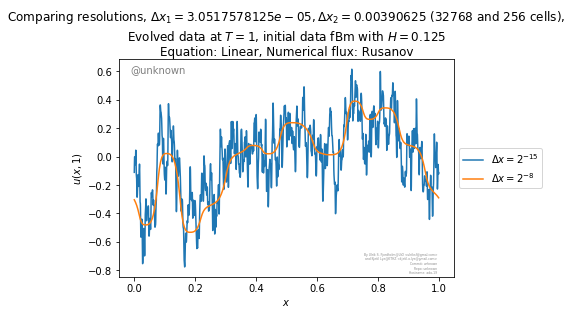

2019-04-10 08:17:21.376044 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-10 08:29:49.971665 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 1


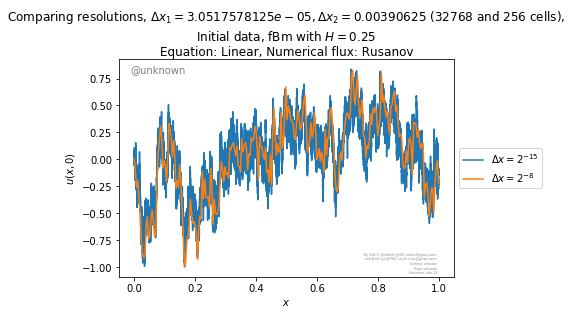

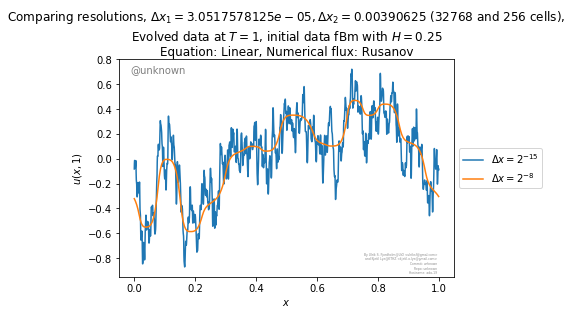

2019-04-10 08:29:55.962351 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-10 08:42:40.162140 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 1


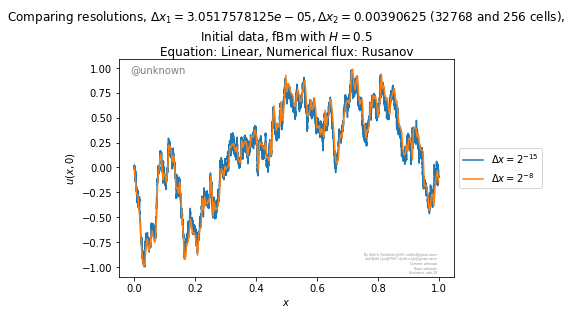

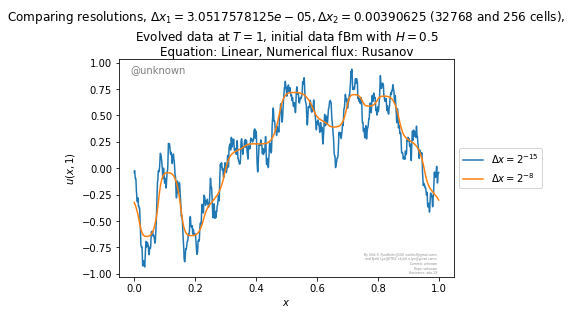

2019-04-10 08:42:45.800350 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-10 08:55:34.145267 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 1


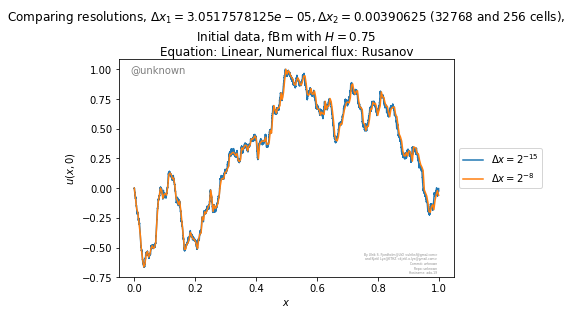

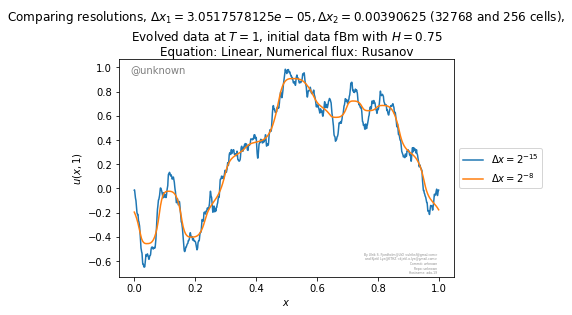

2019-04-10 08:55:39.689194 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-10 09:07:49.334120 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 1


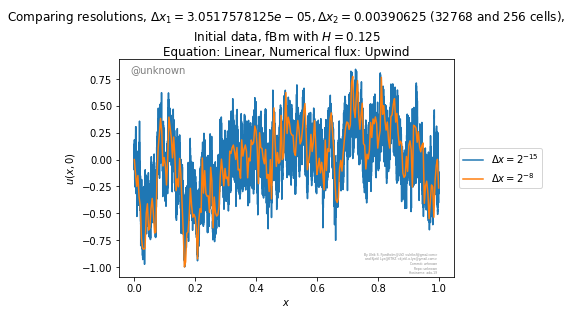

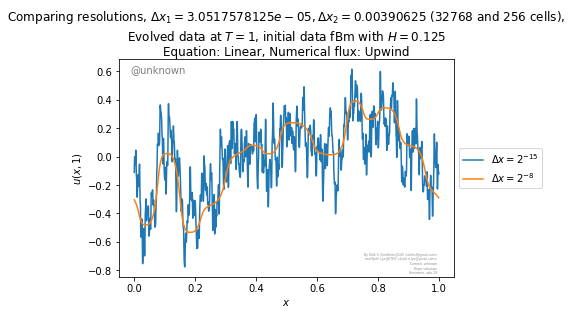

2019-04-10 09:07:55.921229 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-10 09:20:01.302488 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 1


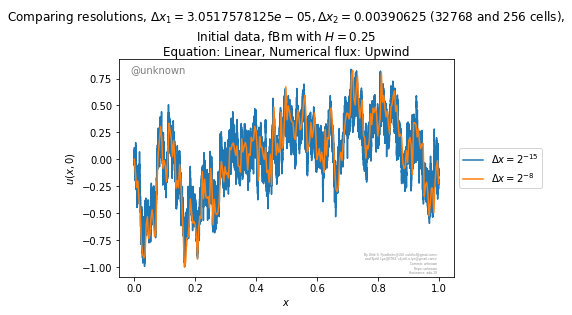

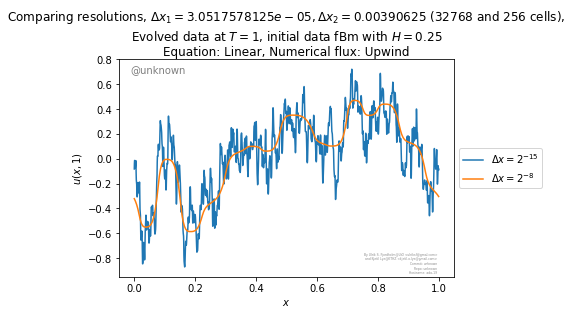

2019-04-10 09:20:07.576960 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-10 09:32:20.581189 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 1


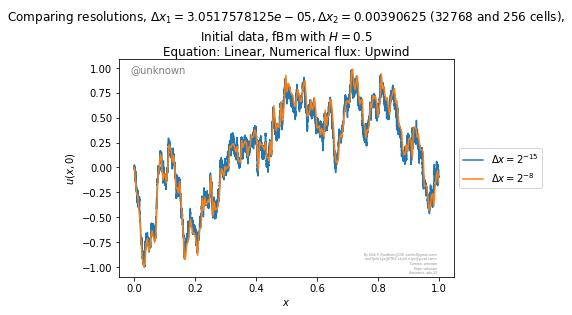

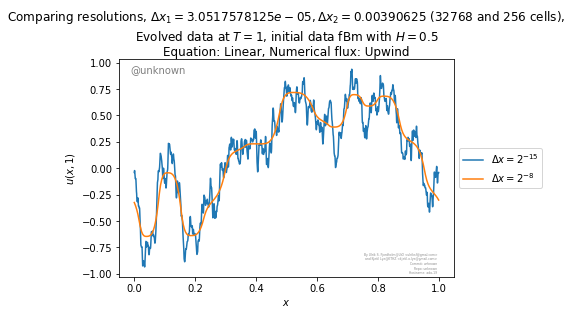

2019-04-10 09:32:26.164343 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-10 09:44:25.574709 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 1


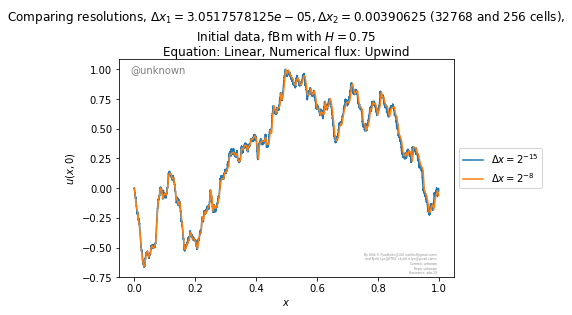

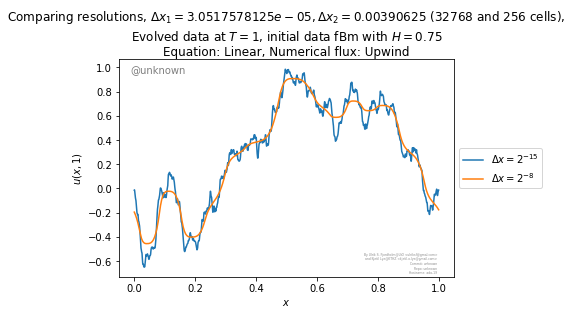

In [18]:
def run_fbm_plot_compare(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

    M1 = COMPUTATIONAL_BUDGET
    M2 = 256
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        plot_solution_at_two_resolutions(base_xml, name, T, M1, M2, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
        plt.figure(0)
        plt.title("Comparing resolutions, $\\Delta x_1={dx1}, \\Delta x_2={dx2}$ ({M1} and {M2} cells),\nInitial data, fBm with $H={hurz}$\nEquation: {equation}, Numerical flux: {numerical_flux}"\
              .format(hurz=H, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(),
                      dx1=1.0/M1, dx2=1.0/M2, M1=M1, M2=M2))
        plot_info.legendLeft()
        plot_info.savePlot("fbm_initial_compare_{equation}_{H}_{numerical_flux}"
                .format(equation=equation, H=str(H).replace(".", "_"), numerical_flux=numerical_flux))
        
        plt.figure(1)
        plt.title("Comparing resolutions, $\\Delta x_1={dx1}, \\Delta x_2={dx2}$ ({M1} and {M2} cells),\nEvolved data at $T={T}$, initial data fBm with $H={hurz}$\nEquation: {equation}, Numerical flux: {numerical_flux}"\
              .format(hurz=H, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), 
                      T=T, dx1=1.0/M1, dx2=1./M2, M1=M1, M2=M2))
        plot_info.legendLeft()
                        
        plot_info.savePlot("fbm_evolved_compare_{equation}_{numerical_flux}_{T}_{H}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_"),
                        H=str(H).replace(".", "_")))
        plt.show()
        
for T in [1/256., 1]:
    run_all_configurations(run_fbm_plot_compare, T)

In [19]:
def run_average_convergence(base_xml, title, T, number_of_samples,
                    exact_solution_class=None,
                    numerical_flux="rusanov",
                    equation="burgers"):
    
    plot_info.console_log_show("Running run_average_convergence for {}, T={}, flux={}, equation={}".format(base_xml,
                                                                                                 T,
                                                                                                numerical_flux,
                                                                                                equation))

    resolutions = 2**np.arange(START_CONVERGENCE_UQ_LOG, END_CONVERGENCE_UQ_LOG)
    errors = []
    errors_max = []
    errors_min = []
    errors_var = []
    
    
    
    ## Make sample solution
    sample_solution_run = alsvinn.run(name="sample_solution",
        base_xml=base_xml,
        number_of_saves=1,
        dimension=[SAMPLE_SOLUTION_FACTOR*resolutions[-1],1,1],
        flux=numerical_flux,
        equation=equation,
        samples = number_of_samples,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    
    
    
    ## Loop over resolutions
    for r in resolutions:
        ## Just some progress output, can be deleted
        sys.stdout.write("Resolution = {}\r".format(r))
        sys.stdout.flush()
        
        ## This is where we run alsvinn for the given resolution
        run = alsvinn.run(name="convergence_run",
                         base_xml=base_xml,
                         number_of_saves=1,
                         dimension=[r,1,1],
                         flux=numerical_flux,
                         equation=equation,
                         samples = number_of_samples,
                         uq=True, # notice that since we have Brownian initial data, we need to enable uq
                         T=T)
        errors_at_resolutions = []

        for sample in range(number_of_samples):
            if exact_solution_class is None:
                sample_solution = sample_solution_run.get_data("u", 1,sample=sample)
            else:
                initial_data = sample_solution_run.get_data("u", 0,sample=sample)
    
                exact_solution_object = exact_solution_class(initial_data)
        
                sample_solution = exact_solution_object(T)
        
            r_sample = sample_solution.shape[0]
        
            u_approx = run.get_data("u", 1, sample=sample)
        
            u_approx_upscaled = np.repeat(u_approx, r_sample//r)
        
            ## Compute L^1 error
            errors_at_resolutions.append(np.sum(abs(u_approx_upscaled-sample_solution))/r_sample)
        errors.append(np.mean(errors_at_resolutions))
        errors_max.append(max(errors_at_resolutions))
        errors_min.append(min(errors_at_resolutions))
        errors_var.append(np.var(errors_at_resolutions))
    errors = np.array(errors)
    errors_var=np.array(errors_var)
    sys.stdout.write("\r")
    plt.figure(0)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.errorbar(resolutions, errors, yerr=np.sqrt(errors_var),
                           label=title, barsabove=True)
    plt.gca().set_xscale("log", nonposx='clip',basex=2)
    plt.gca().set_yscale("log", nonposy='clip',basey=2)

    plt.grid(True)
    
    poly = np.polyfit(np.log(resolutions), np.log(errors), 1)
    plt.loglog(resolutions, np.exp(poly[1])*resolutions**poly[0], '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(M^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    
    
    plt.xlabel("Number of cells ($M$)")
    plt.ylabel("Expectation of Error ($\\mathbb{E}(||\\cdot||_{L^1([0,1])})$)")
    plt.legend()
    
    
    plt.figure(1)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.errorbar(1.0/resolutions, errors, yerr=np.sqrt(errors_var),
                           label=title, barsabove=True)
    plt.grid(True)
    
    poly = np.polyfit(np.log(1.0/resolutions), np.log(errors), 1)
    plt.loglog(1.0/resolutions, np.exp(poly[1])*resolutions**(-poly[0]), '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(\\Delta x^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    plt.xlabel("$\\Delta x$")
    plt.ylabel("Expectation of Error ($\\mathbb{E}(||\\cdot||_{L^1([0,1])})$)")
    plt.legend()
    
    
    plt.figure(2)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.errorbar(1.0/resolutions, errors,  yerr=np.sqrt(errors_var),
                           label=title, barsabove=True)
    plt.grid(True)
    
    poly = np.polyfit(np.log(1.0/resolutions), np.log(-errors/np.log(1/resolutions)), 1)
    plt.loglog(1.0/resolutions, -np.log(1/resolutions)*np.exp(poly[1])*resolutions**(-poly[0]), '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(-\\log(\\Delta x)\\Delta x^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    plt.xlabel("$\\Delta x$")
    plt.ylabel("Expectation of Error ($\\mathbb{E}(||\\cdot||_{L^1([0,1])})$)")
    plt.legend()
   

   
    
    
    
    
    
    plot_info.console_log_show("Done configuration {} {} {} {}".format(base_xml, equation, numerical_flux, T))
    
        

2019-04-10 09:44:31.518632 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=burgers
2019-04-10 09:58:41.104357 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.00048828125
2019-04-10 09:58:41.129907 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=burgers
2019-04-10 10:13:36.925360 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.00048828125
2019-04-10 10:13:36.944444 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=burgers
2019-04-10 10:30:20.242951 (in run_average_convergence): Done

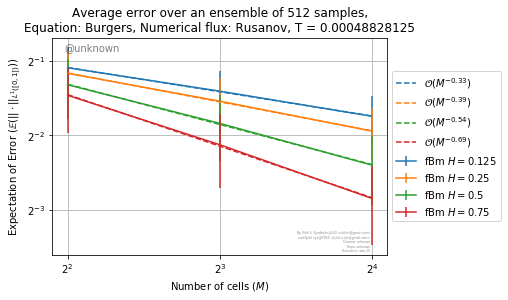

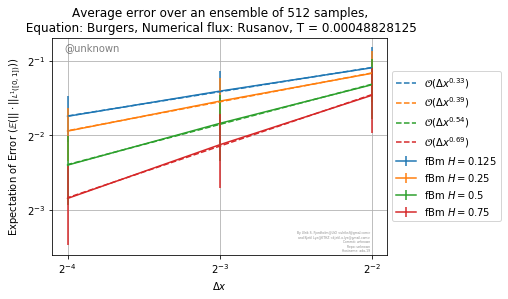

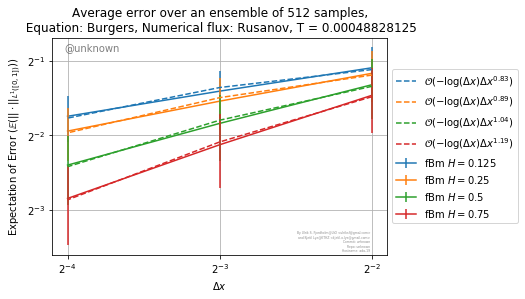

2019-04-10 10:47:20.316779 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=godunov, equation=burgers
2019-04-10 11:04:06.372566 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.00048828125
2019-04-10 11:04:06.389860 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=godunov, equation=burgers
2019-04-10 11:20:52.344716 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.00048828125
2019-04-10 11:20:52.362700 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=godunov, equation=burgers
2019-04-10 11:37:36.053094 (in run_average_convergence): Done

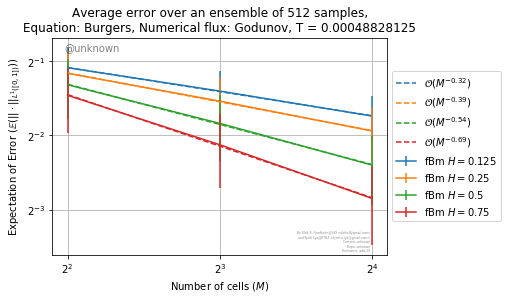

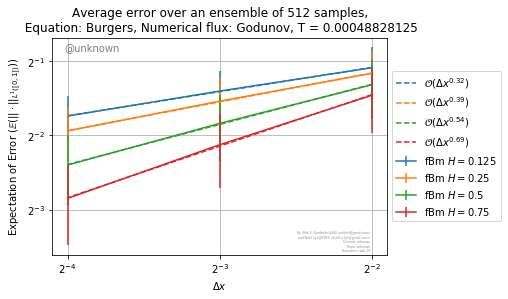

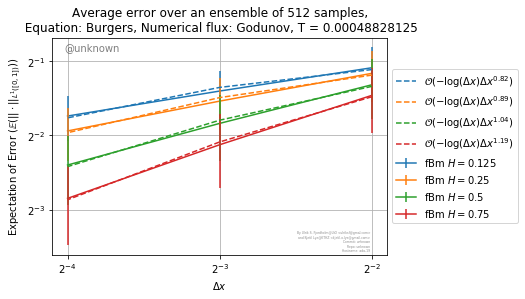

2019-04-10 11:54:31.297051 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=burgers
2019-04-10 12:11:17.759735 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.00048828125
2019-04-10 12:11:17.779647 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=burgers
2019-04-10 12:28:02.688236 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.00048828125
2019-04-10 12:28:02.706682 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=burgers
2019-04-10 12:44:47.590211 (in run_average_convergence): Done configuration ../co

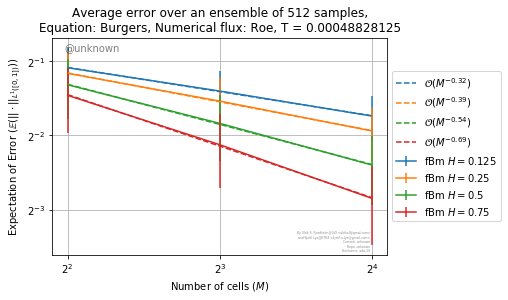

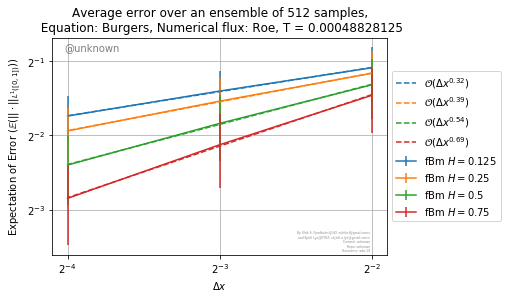

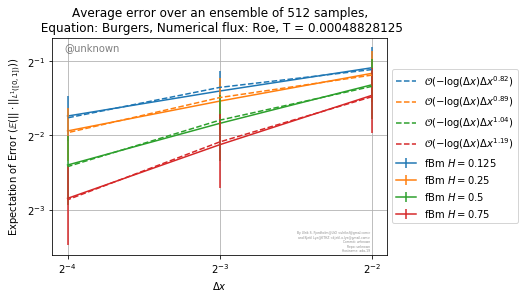

2019-04-10 13:01:45.322029 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=cubic
2019-04-10 13:18:29.537581 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.00048828125
2019-04-10 13:18:29.559496 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=cubic
2019-04-10 13:35:18.064058 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.00048828125
2019-04-10 13:35:18.082933 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=cubic
2019-04-10 13:52:17.708269 (in run_average_convergence): Done configura

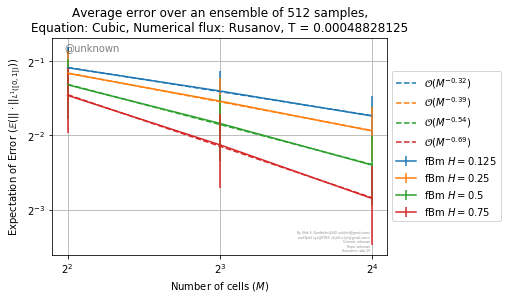

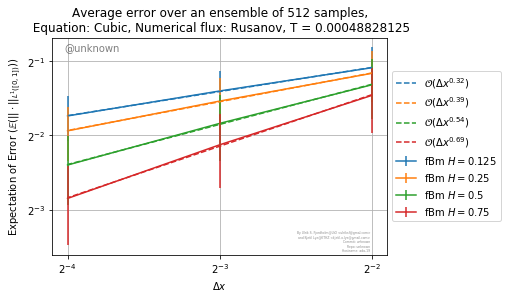

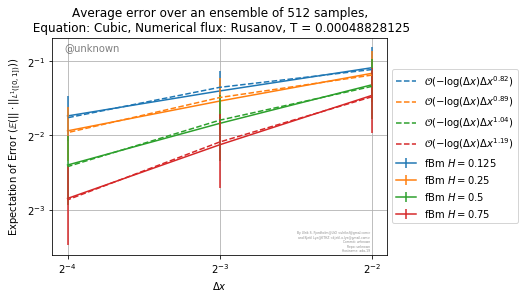

2019-04-10 14:08:26.424620 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=cubic
2019-04-10 14:25:12.871819 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.00048828125
2019-04-10 14:25:12.891921 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=cubic
2019-04-10 14:42:06.300925 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.00048828125
2019-04-10 14:42:06.319965 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=cubic
2019-04-10 14:58:53.655881 (in run_average_convergence): Done configuration ../configs/frac

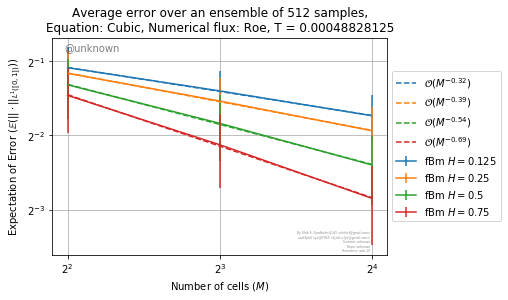

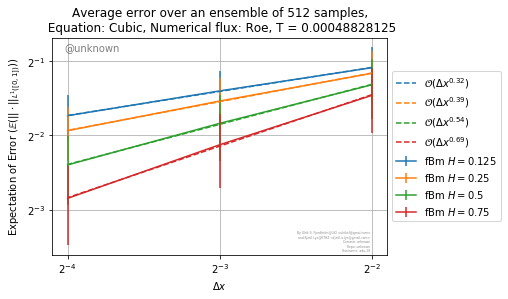

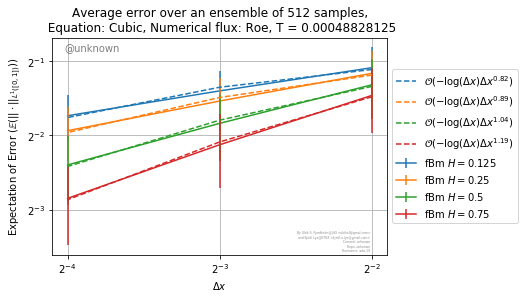

2019-04-10 15:15:54.832951 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=linear
2019-04-10 15:32:41.692416 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.00048828125
2019-04-10 15:32:41.710437 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=linear
2019-04-10 15:50:05.707905 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.00048828125
2019-04-10 15:50:05.727060 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=linear
2019-04-10 16:06:56.213526 (in run_average_convergence): Done conf

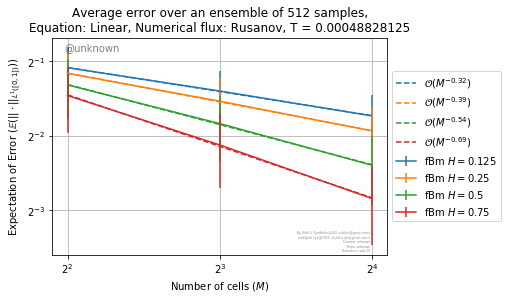

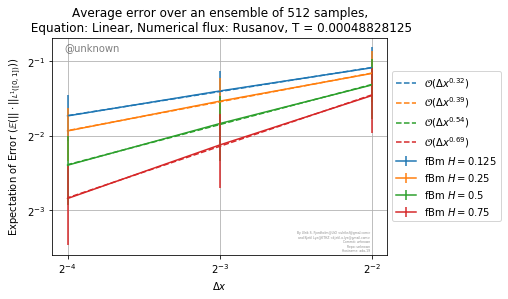

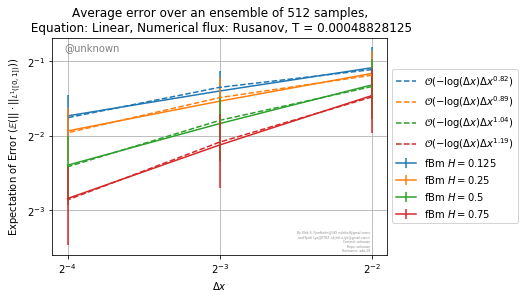

2019-04-10 16:23:54.785626 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=upwind, equation=linear
2019-04-10 16:40:46.734628 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.00048828125
2019-04-10 16:40:46.756249 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=upwind, equation=linear
2019-04-10 16:57:36.458828 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.00048828125
2019-04-10 16:57:36.483387 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=upwind, equation=linear
2019-04-10 17:14:21.499647 (in run_average_convergence): Done configura

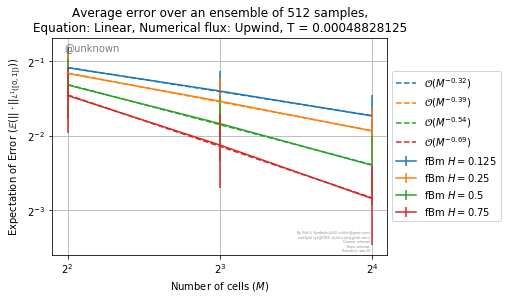

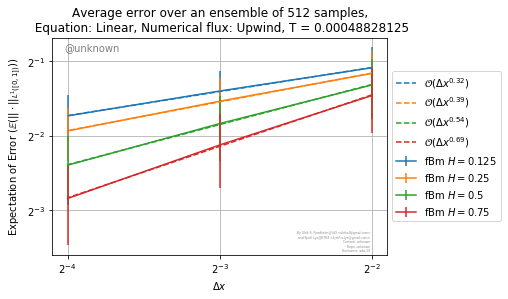

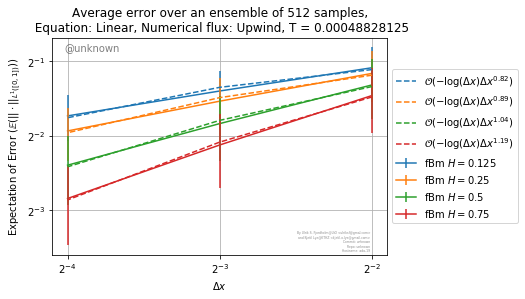

2019-04-10 17:31:18.873528 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-10 17:52:38.467554 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.00390625
2019-04-10 17:52:38.485918 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-10 18:12:12.025469 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.00390625
2019-04-10 18:12:12.049031 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-10 18:26:30.698248 (in run_average_convergence): Done configuration 

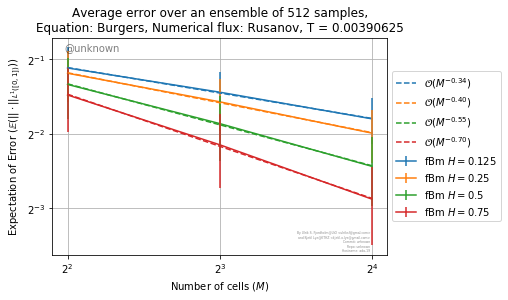

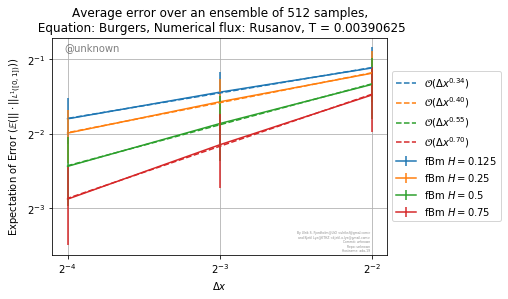

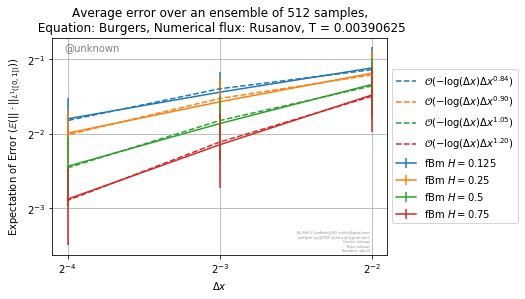

2019-04-10 18:40:48.799012 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-10 18:55:13.932302 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.00390625
2019-04-10 18:55:13.952824 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-10 19:09:28.484181 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.00390625
2019-04-10 19:09:28.504099 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-10 19:23:32.476784 (in run_average_convergence): Done configuration 

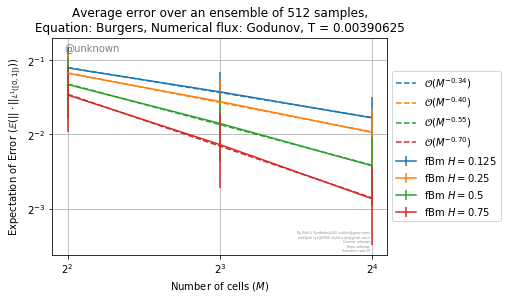

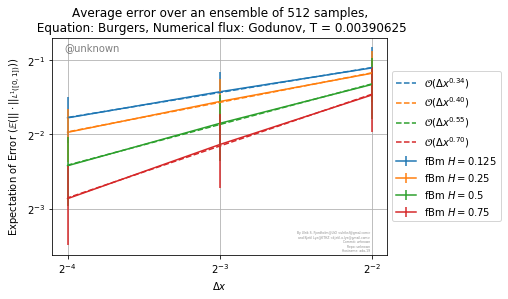

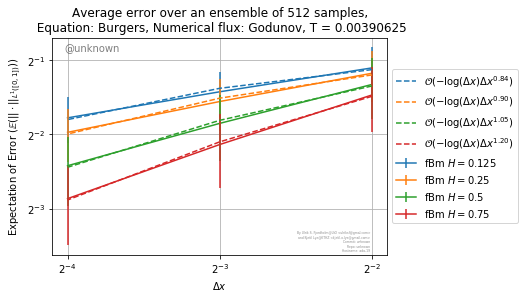

2019-04-10 19:38:01.461693 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-10 19:52:14.723307 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.00390625
2019-04-10 19:52:14.745954 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-10 20:06:26.786731 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.00390625
2019-04-10 20:06:26.812300 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-10 20:20:28.612026 (in run_average_convergence): Done configuration ../configs/fractiona

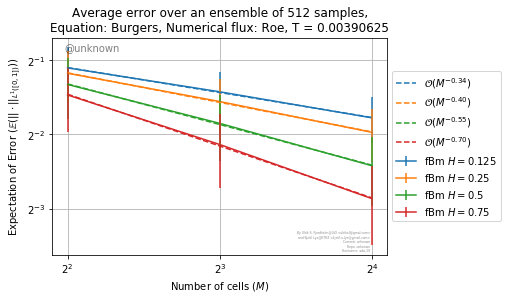

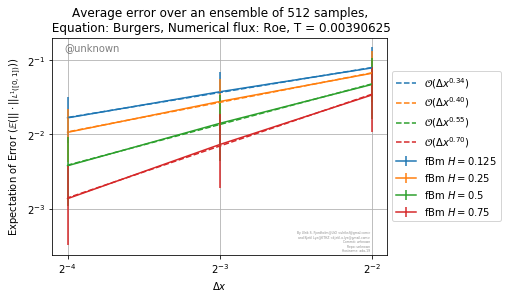

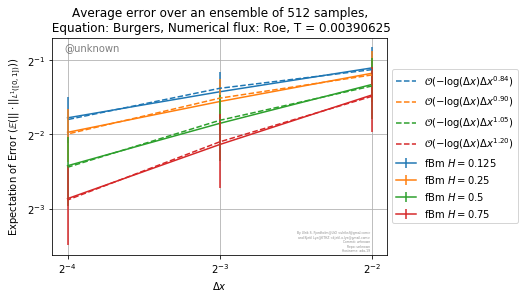

2019-04-10 20:34:51.635232 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-10 20:48:57.561411 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.00390625
2019-04-10 20:48:57.583075 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-10 21:03:16.879953 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.00390625
2019-04-10 21:03:16.898982 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-10 21:17:33.320682 (in run_average_convergence): Done configuration ../configs

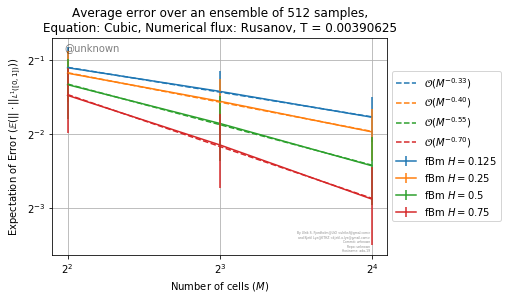

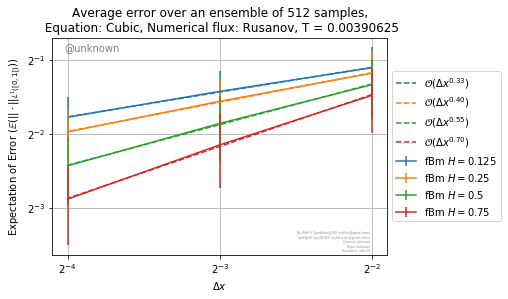

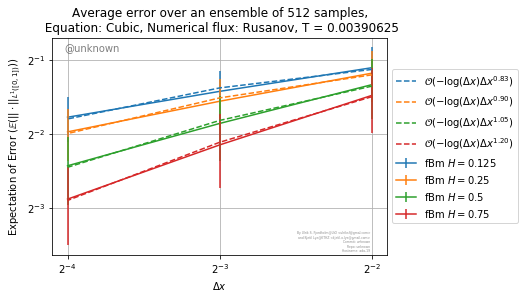

2019-04-10 21:32:02.871763 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-10 21:46:12.631045 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.00390625
2019-04-10 21:46:12.652291 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-10 22:00:25.797854 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.00390625
2019-04-10 22:00:25.816190 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-10 22:14:43.370896 (in run_average_convergence): Done configuration ../configs/fractional_brownian

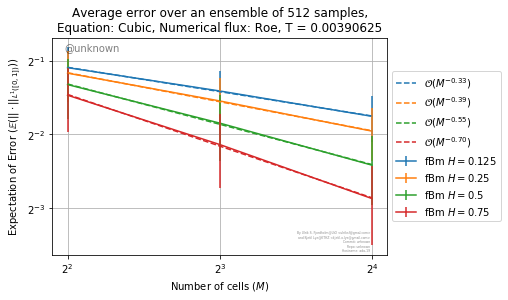

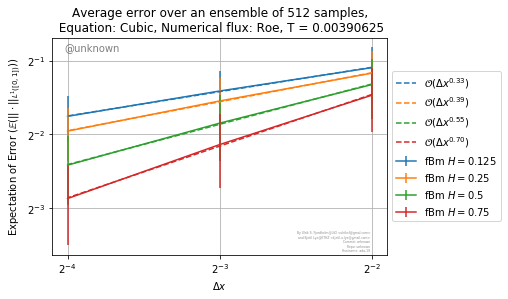

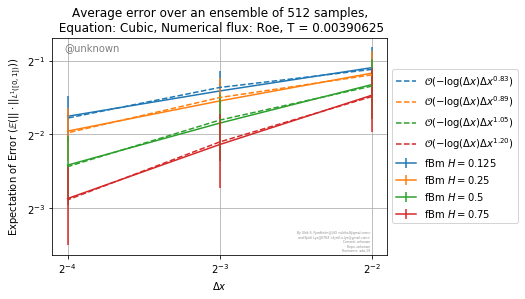

2019-04-10 22:29:01.605904 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-10 22:43:18.066681 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.00390625
2019-04-10 22:43:18.085020 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-10 22:57:29.680641 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.00390625
2019-04-10 22:57:29.699861 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-10 23:11:39.497717 (in run_average_convergence): Done configuration ../co

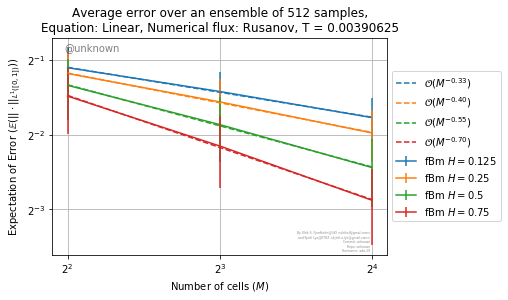

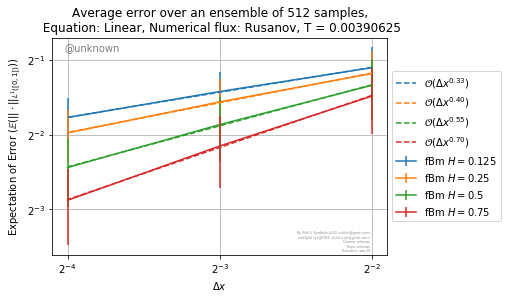

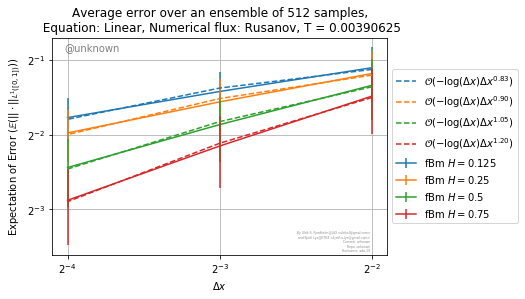

2019-04-10 23:26:07.286142 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-10 23:40:24.602217 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.00390625
2019-04-10 23:40:24.619736 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-10 23:54:34.486003 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.00390625
2019-04-10 23:54:34.503290 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-11 00:08:42.569250 (in run_average_convergence): Done configuration ../configs

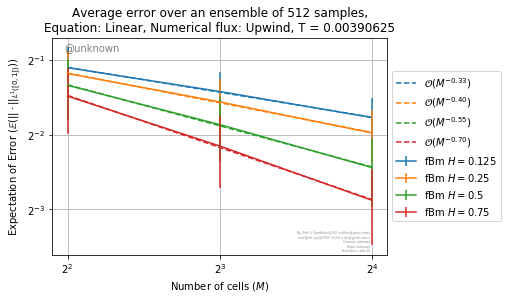

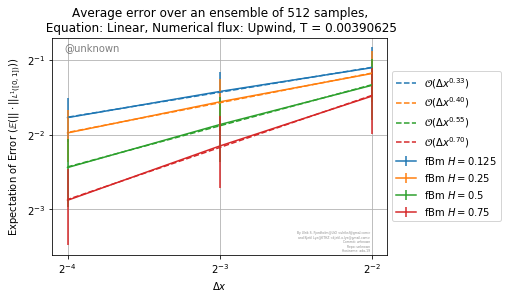

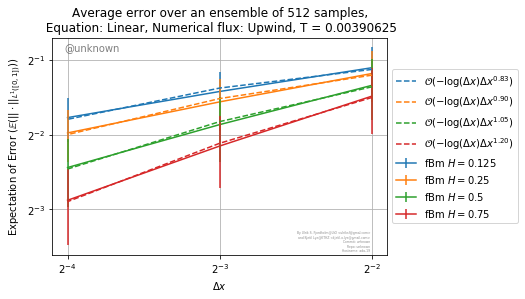

2019-04-11 00:23:09.896103 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=rusanov, equation=burgers
2019-04-11 00:39:15.866100 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.125
2019-04-11 00:39:15.886759 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=rusanov, equation=burgers
2019-04-11 00:53:53.382375 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.125
2019-04-11 00:53:53.403234 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=rusanov, equation=burgers
2019-04-11 01:08:27.697002 (in run_average_convergence): Done configuration ../configs/fractional_bro

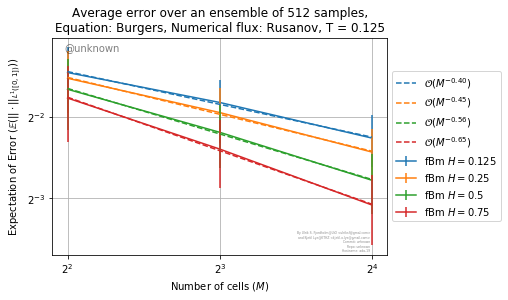

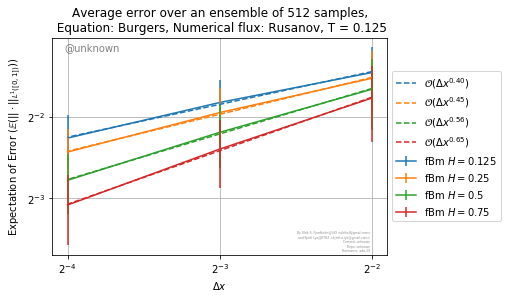

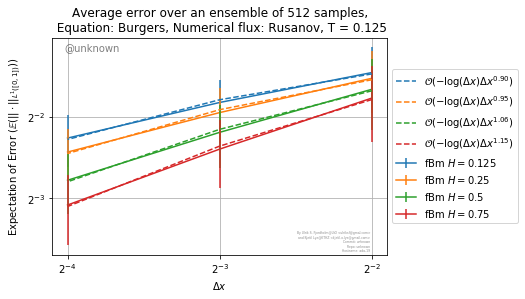

2019-04-11 01:23:08.962724 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=godunov, equation=burgers
2019-04-11 01:37:41.242672 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.125
2019-04-11 01:37:41.262654 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=godunov, equation=burgers
2019-04-11 01:52:22.347877 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.125
2019-04-11 01:52:22.368642 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=godunov, equation=burgers
2019-04-11 02:06:56.071201 (in run_average_convergence): Done configuration ../configs/fractional_bro

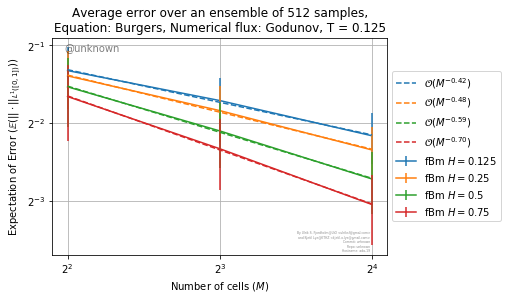

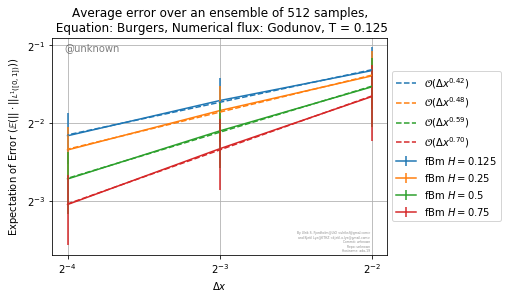

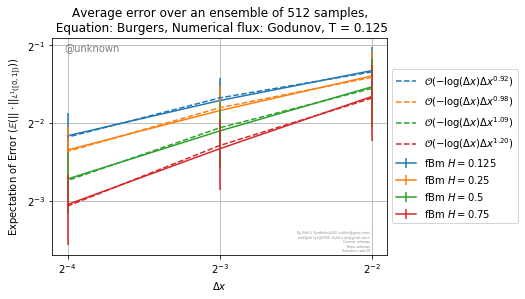

2019-04-11 02:23:07.637080 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=roe, equation=burgers
2019-04-11 02:37:32.176350 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.125
2019-04-11 02:37:32.196529 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=roe, equation=burgers
2019-04-11 02:52:13.131694 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.125
2019-04-11 02:52:13.150369 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=roe, equation=burgers
2019-04-11 03:06:31.860611 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional

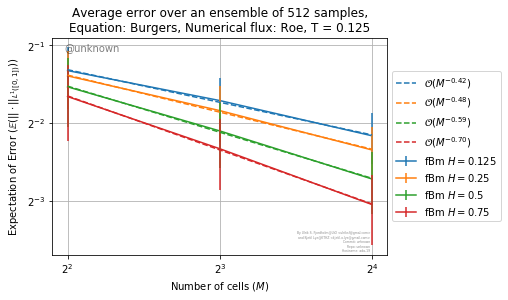

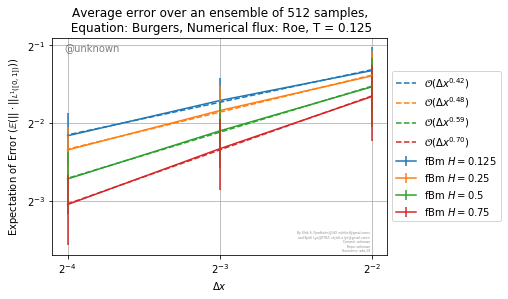

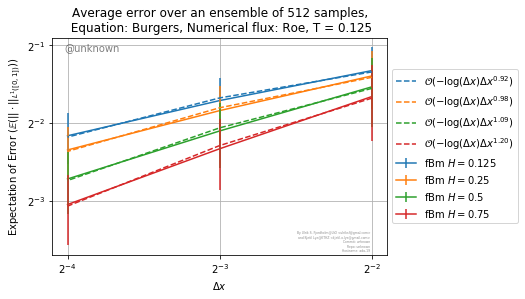

2019-04-11 03:21:12.621977 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=rusanov, equation=cubic
2019-04-11 03:35:30.309451 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.125
2019-04-11 03:35:30.334384 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=rusanov, equation=cubic
2019-04-11 03:50:04.282587 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.125
2019-04-11 03:50:04.301509 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=rusanov, equation=cubic
2019-04-11 04:04:40.619247 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/

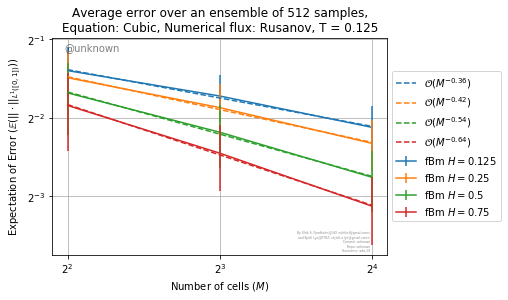

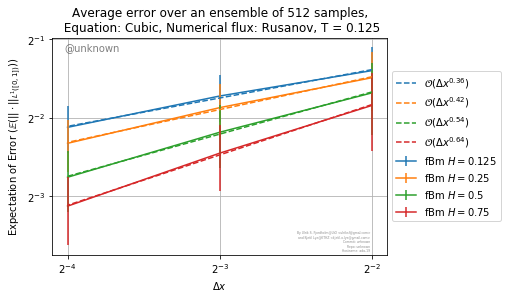

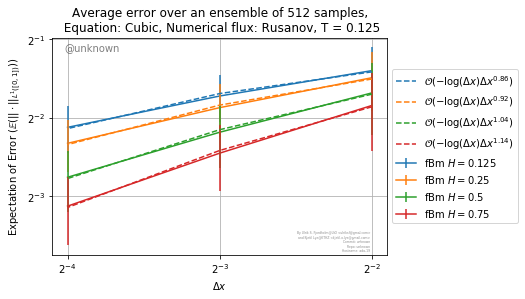

2019-04-11 04:19:25.940815 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=roe, equation=cubic
2019-04-11 04:33:49.081960 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.125
2019-04-11 04:33:49.099296 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=roe, equation=cubic
2019-04-11 04:48:17.890799 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.125
2019-04-11 04:48:17.909147 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=roe, equation=cubic
2019-04-11 05:02:43.716562 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.

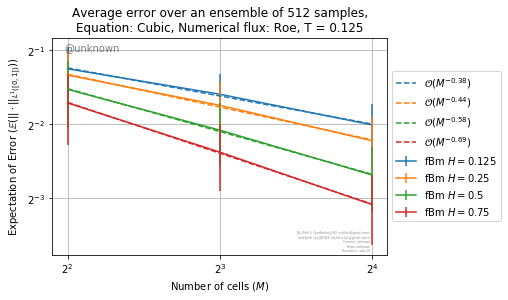

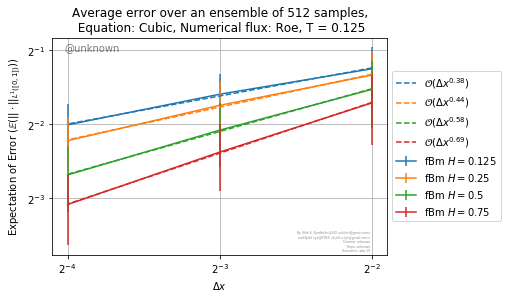

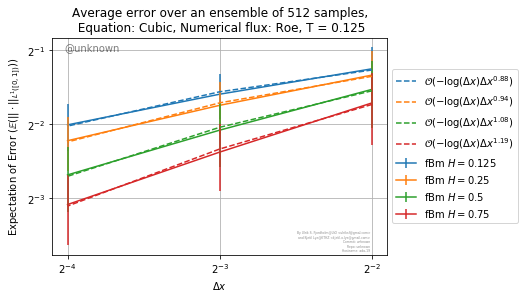

2019-04-11 05:17:33.762479 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=rusanov, equation=linear
2019-04-11 05:32:10.137815 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.125
2019-04-11 05:32:10.161837 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=rusanov, equation=linear
2019-04-11 05:46:35.776987 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.125
2019-04-11 05:46:35.794795 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=rusanov, equation=linear
2019-04-11 06:01:10.674193 (in run_average_convergence): Done configuration ../configs/fractional_brownian

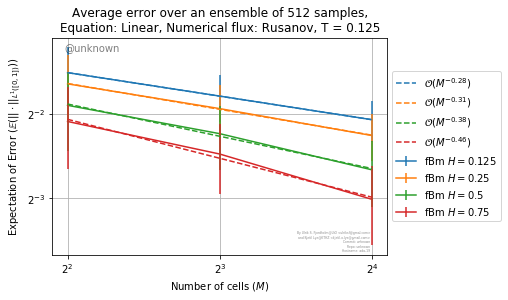

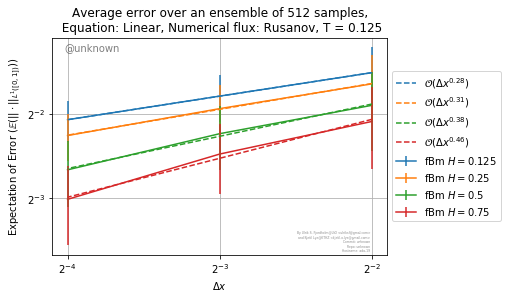

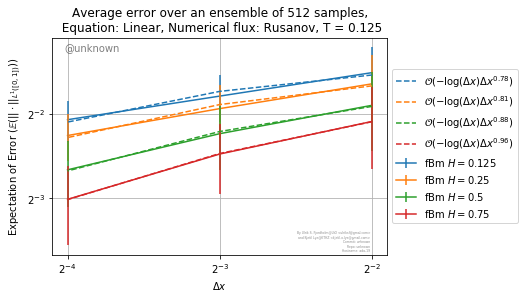

2019-04-11 06:15:43.397978 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=upwind, equation=linear
2019-04-11 06:30:09.713610 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.125
2019-04-11 06:30:09.732360 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=upwind, equation=linear
2019-04-11 06:44:56.012894 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.125
2019-04-11 06:44:56.033664 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=upwind, equation=linear
2019-04-11 06:59:35.111582 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/

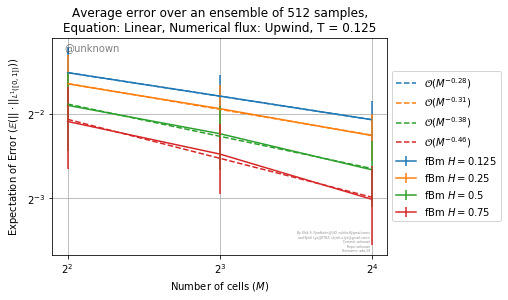

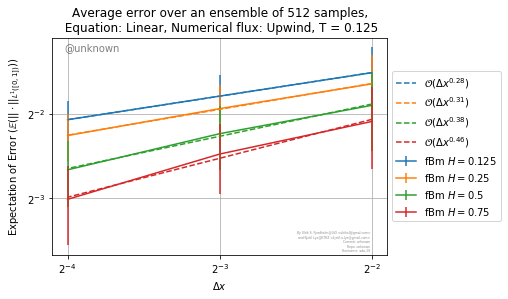

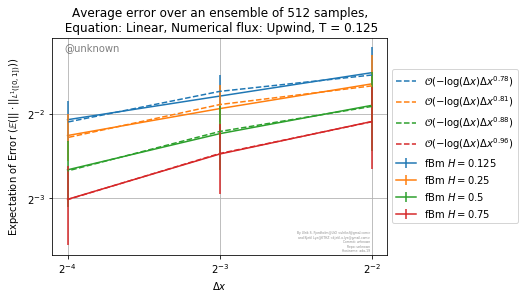

2019-04-11 07:14:09.314602 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=rusanov, equation=burgers
2019-04-11 07:28:58.325466 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.25
2019-04-11 07:28:58.344681 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=rusanov, equation=burgers
2019-04-11 07:44:02.202935 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.25
2019-04-11 07:44:02.221552 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=rusanov, equation=burgers
2019-04-11 07:58:55.053793 (in run_average_convergence): Done configuration ../configs/fractional_brownian

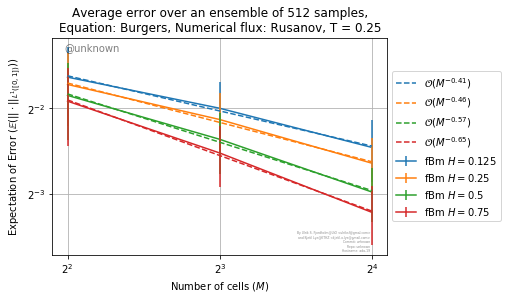

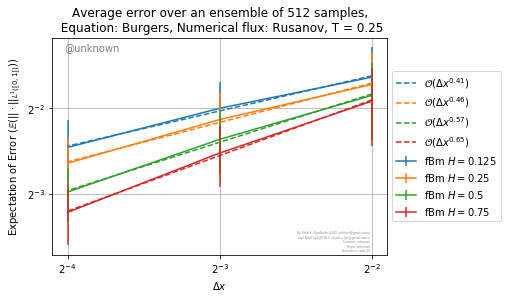

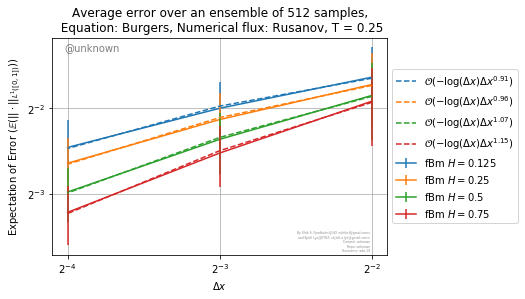

2019-04-11 08:14:03.604776 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=godunov, equation=burgers
2019-04-11 10:59:11.382843 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.25
2019-04-11 10:59:11.406978 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=godunov, equation=burgers
2019-04-11 17:13:10.552222 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.25
2019-04-11 17:13:10.621977 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=godunov, equation=burgers
2019-04-12 03:16:17.403705 (in run_average_convergence): Done configuration ../configs/fractional_brownian

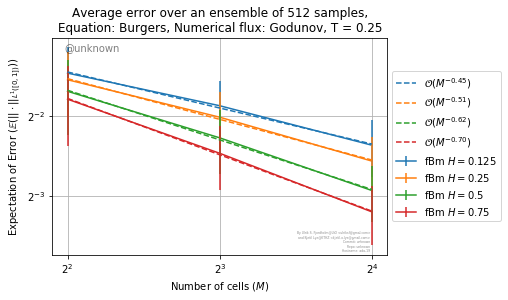

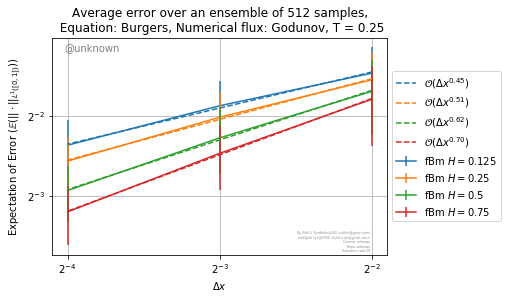

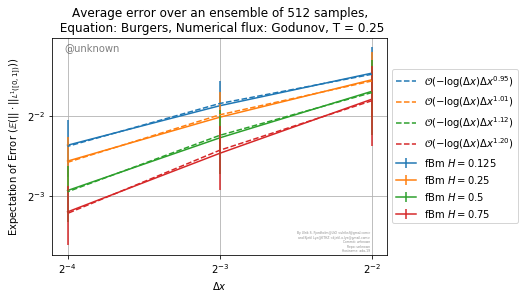

2019-04-12 08:51:08.266022 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=roe, equation=burgers
2019-04-12 13:00:42.005201 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.25
2019-04-12 13:00:42.027185 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=roe, equation=burgers
2019-04-12 17:37:25.425057 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.25
2019-04-12 17:37:25.446848 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=roe, equation=burgers
2019-04-12 22:52:30.820610 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brow

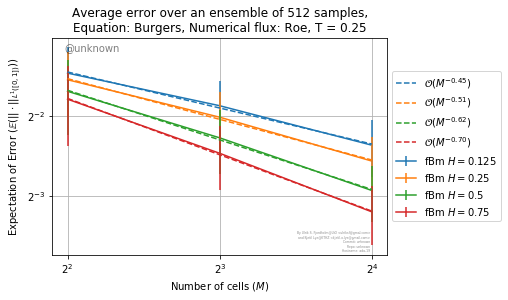

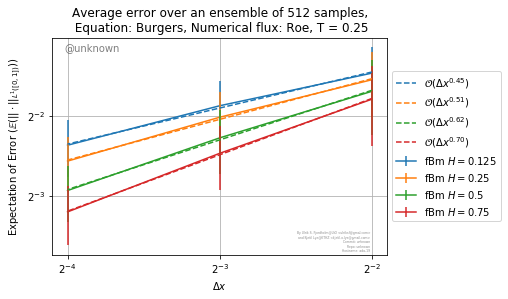

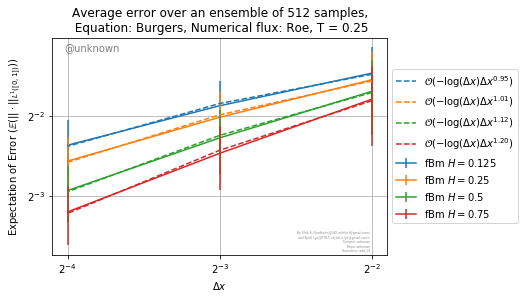

2019-04-13 04:26:33.624293 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=rusanov, equation=cubic
2019-04-13 07:38:12.507071 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.25
2019-04-13 07:38:12.525029 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=rusanov, equation=cubic
2019-04-13 11:20:40.031124 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.25
2019-04-13 11:20:40.052157 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=rusanov, equation=cubic
2019-04-13 15:57:37.589123 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fract

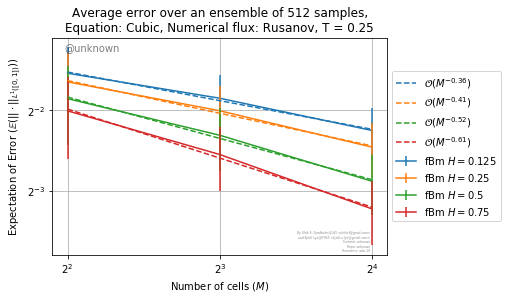

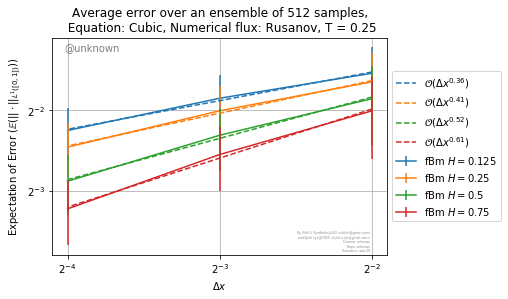

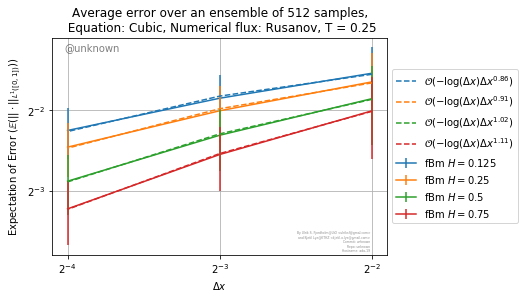

2019-04-13 21:09:03.368782 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=roe, equation=cubic
2019-04-14 00:22:57.223166 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.25
2019-04-14 00:22:57.241408 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=roe, equation=cubic
2019-04-14 04:07:22.985158 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.25
2019-04-14 04:07:23.008519 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=roe, equation=cubic
2019-04-14 08:45:33.564916 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml c

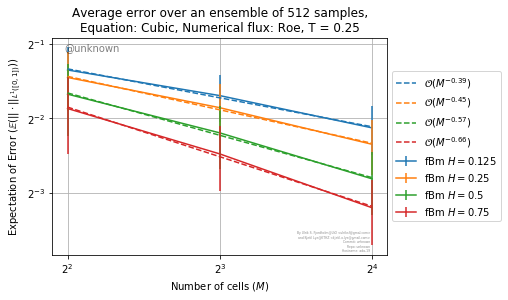

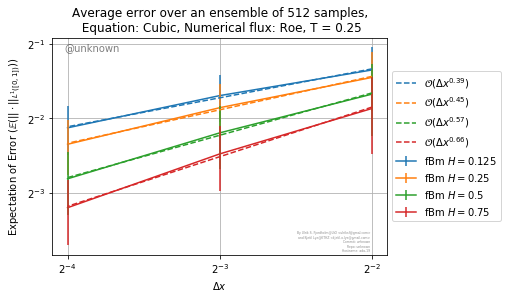

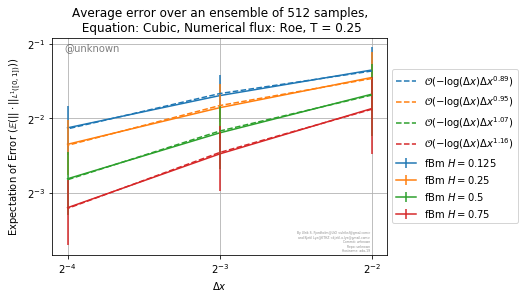

2019-04-14 13:59:03.832997 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=rusanov, equation=linear
2019-04-14 19:53:03.747413 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.25
2019-04-14 19:53:03.812697 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=rusanov, equation=linear
2019-04-15 01:45:51.131470 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.25
2019-04-15 01:45:51.149905 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=rusanov, equation=linear
2019-04-15 07:37:45.138861 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/

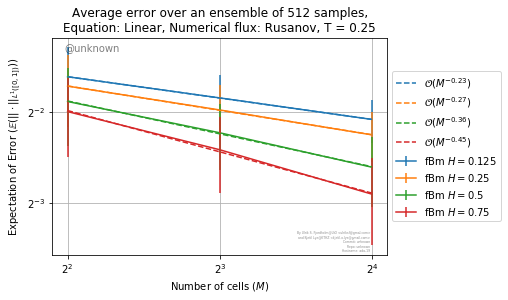

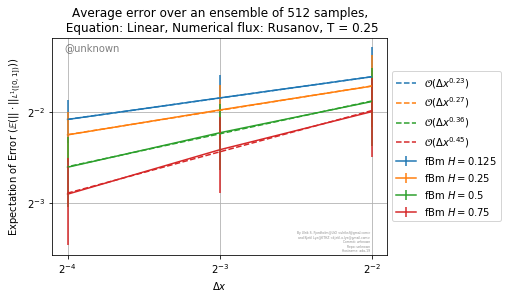

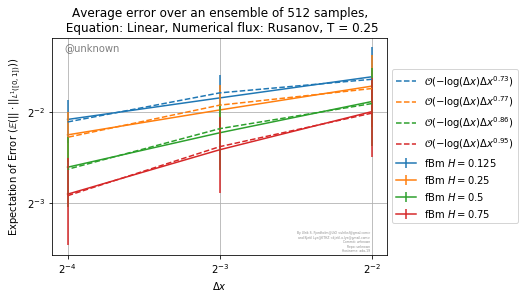

2019-04-15 17:26:33.054645 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=upwind, equation=linear
2019-04-15 23:25:34.563853 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.25
2019-04-15 23:25:34.583663 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=upwind, equation=linear
2019-04-16 05:16:30.531493 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.25
2019-04-16 05:16:30.550609 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=upwind, equation=linear
2019-04-16 11:06:54.366344 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fract

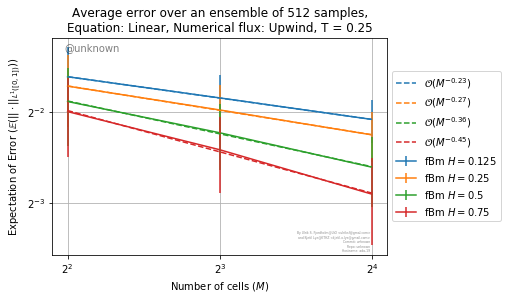

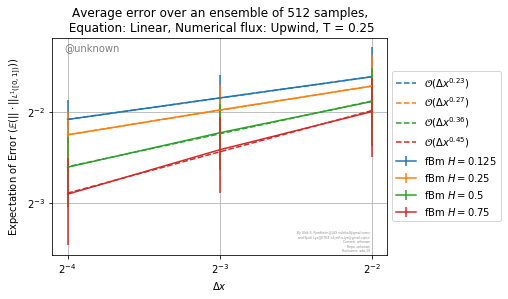

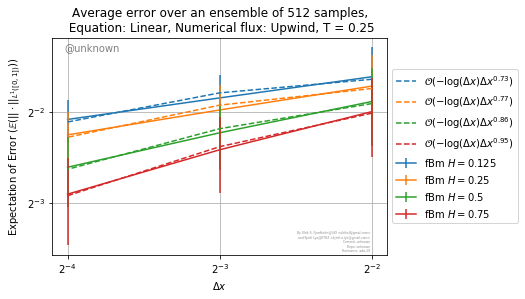

2019-04-16 16:57:12.204949 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-17 05:19:20.150263 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 1
2019-04-17 05:19:20.168920 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-17 15:45:22.955946 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 1
2019-04-17 15:45:22.972672 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-17 16:02:43.707915 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional

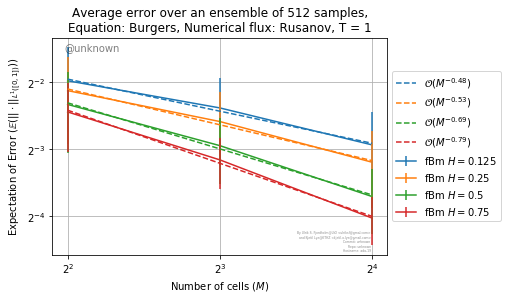

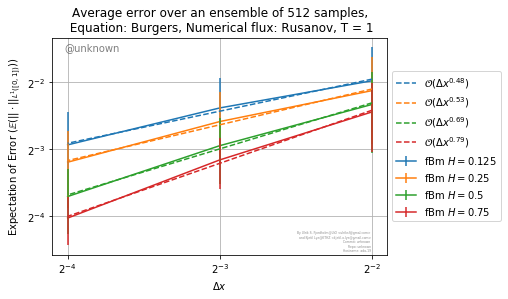

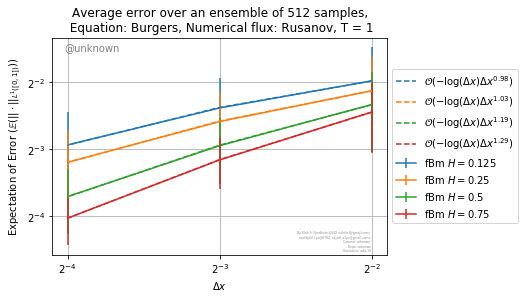

2019-04-17 16:20:27.708763 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-17 16:37:05.997389 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 1
2019-04-17 16:37:06.017459 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-17 16:53:38.969633 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 1
2019-04-17 16:53:38.990777 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-17 17:11:20.027392 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional

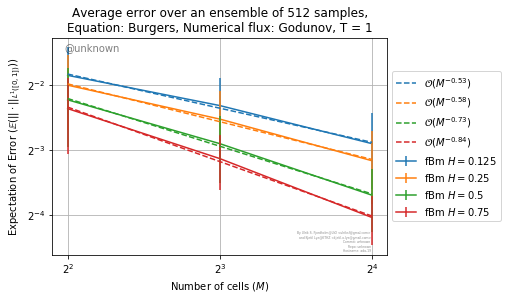

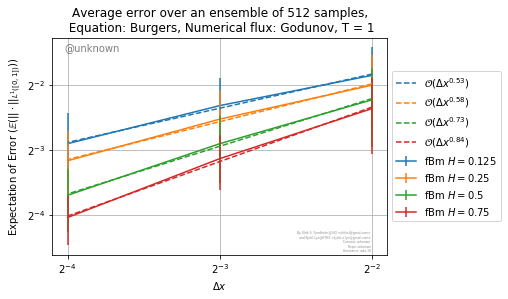

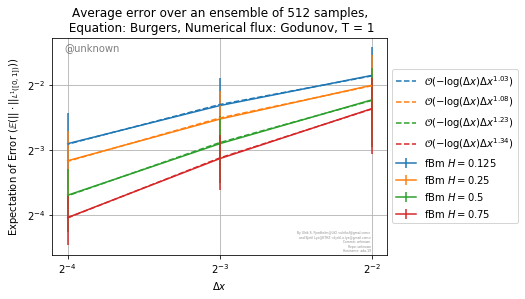

2019-04-17 17:29:11.103220 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-17 17:45:14.708058 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 1
2019-04-17 17:45:14.729512 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-17 18:01:55.981441 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 1
2019-04-17 18:01:56.003267 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-17 18:18:58.666565 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burger

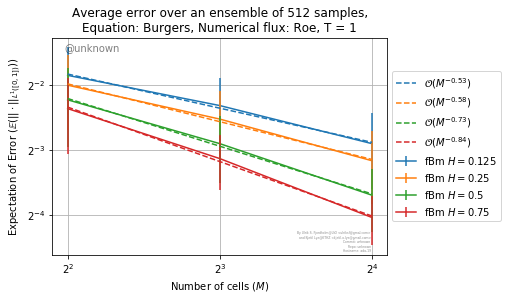

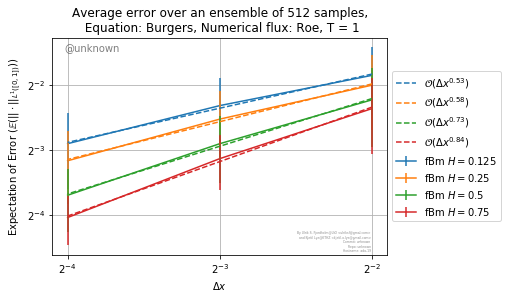

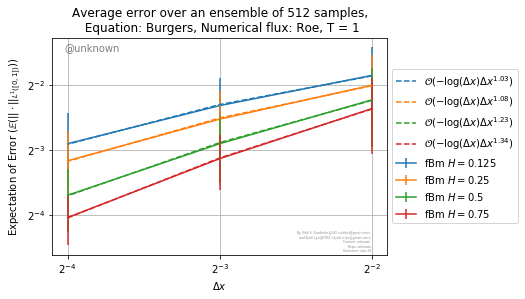

2019-04-17 18:36:43.306084 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-17 18:52:27.152333 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 1
2019-04-17 18:52:27.175916 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-17 19:08:12.023450 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 1
2019-04-17 19:08:12.044749 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-17 19:25:06.036910 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.

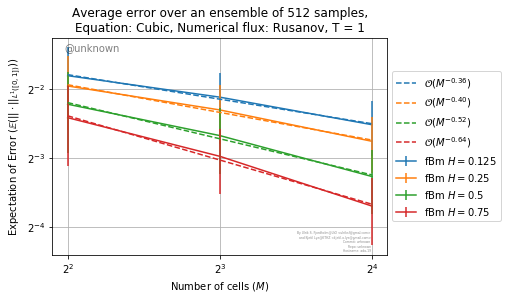

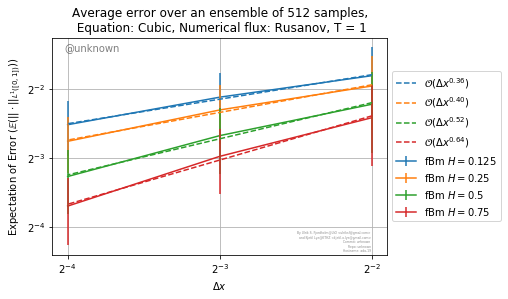

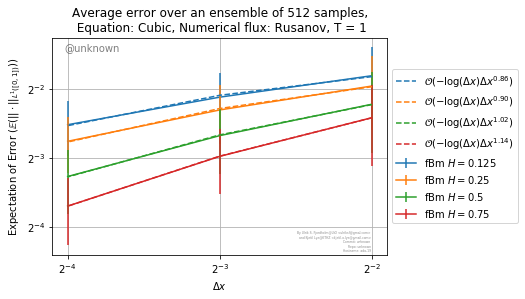

2019-04-17 19:42:38.913763 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-17 19:58:02.595984 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 1
2019-04-17 19:58:02.617390 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-17 20:13:17.935207 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 1
2019-04-17 20:13:17.957051 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-17 20:29:36.912394 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 1
2019

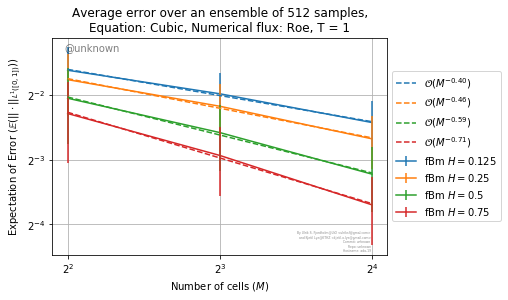

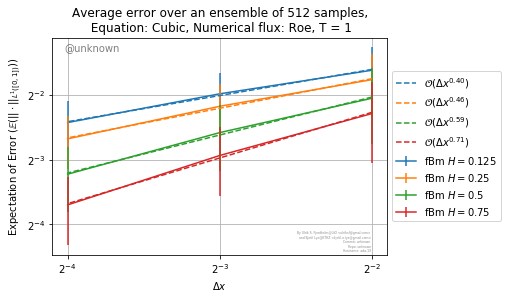

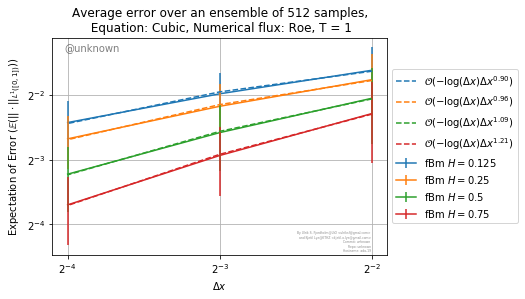

2019-04-17 20:46:42.004648 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-17 21:05:04.276021 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 1
2019-04-17 21:05:04.294794 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-17 21:23:51.929074 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 1
2019-04-17 21:23:51.948333 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-17 21:42:27.363803 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brow

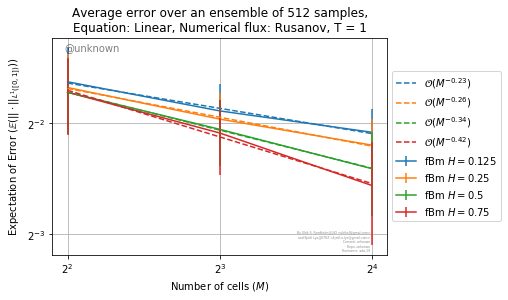

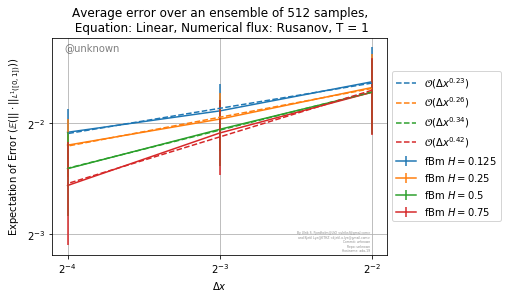

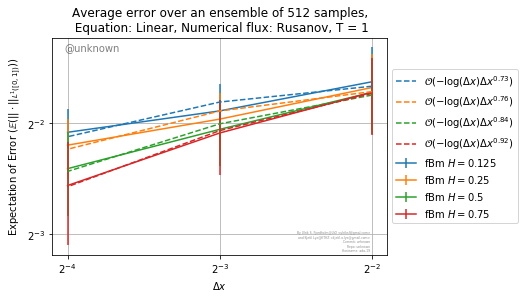

2019-04-17 22:01:18.199942 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-17 22:19:40.798858 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 1
2019-04-17 22:19:40.827387 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-17 22:38:01.229238 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 1
2019-04-17 22:38:01.247600 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-17 22:56:35.021034 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.

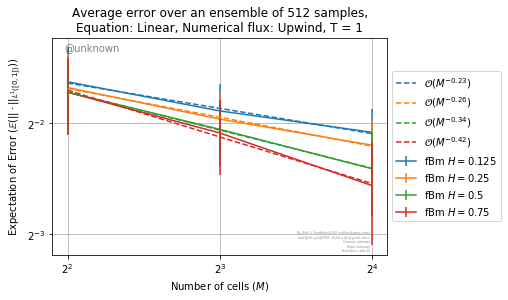

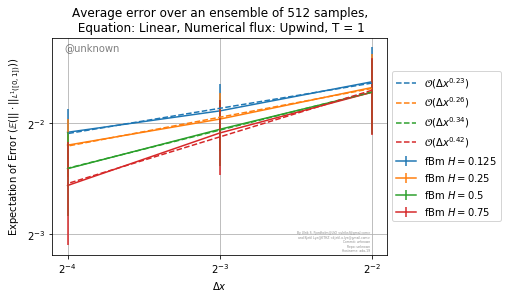

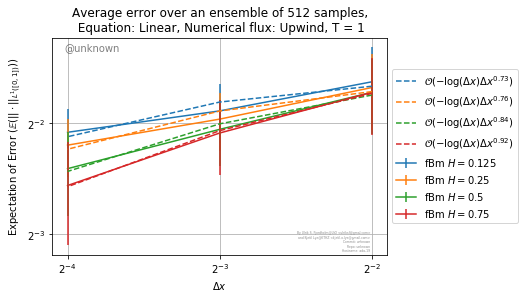

In [20]:
def run_fbm_average_convergence(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'
    number_of_samples = NUMBER_OF_SAMPLES
   
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        
        run_average_convergence(base_xml, name, T, number_of_samples, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
        
    plt.figure(0)
    plt.title("Average error over an ensemble of {number_of_samples} samples,\nEquation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), number_of_samples=number_of_samples, numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_avg_convergence_M_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    
    plt.figure(1)
    plt.title("Average error over an ensemble of {number_of_samples} samples,\n Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(number_of_samples=number_of_samples, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_avg_convergence_dx_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    
    plt.figure(2)
    plt.title("Average error over an ensemble of {number_of_samples} samples,\n Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(number_of_samples=number_of_samples, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_avg_convergence_log_dx_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    plt.show()
    
for T in [1/2048., 1/256., 1/8, 1.0/4, 1]:
    run_all_configurations(run_fbm_average_convergence, T)
                                             